In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))
display(HTML("<style>.output_result { max-width:100% !important; }</style>"))

In [2]:
import os
import sys
# sys.path.append('/home/thabib/Documents/Personal/Master_Thesis/1_HTMImplementation/ufuncs.py')

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

import time
import random
import collections

from rebergrammar_generator_v3 import *
from experimentor_v4 import Experimentor
#from ufuncs import full_pickle, unpickle, compress_pickle, decompress_pickle, get_idx_nonZeroElements

os.getcwd()
# np.set_printoptions(threshold=sys.maxsize)
#-----------------------------------------------------------------------------------------------

# Network params
k = 32
N = k*7 # 7 is the number of letters in the reber grammar.
M = 16

# Cell params
maxDendritesPerCell = 128 # with 64, the max. number of synapses were restricted to 25 and max. dendrites were 6.
maxSynapsesPerDendrite = 49 # (=32 + (18-1))
nmdaThreshold = 18
permThreshold = 0.50
learningThreshold = 11
permInit = 0.25
permInit_sd = 0.002

perm_decrement = 0.1 # p-
perm_increment = 2*perm_decrement # p+
perm_decay = 0.20*perm_decrement # p--

verbose = 1

# Generate Reber Strings For HTM Learning

In [14]:
# TO BE USED WHEN ONLY STRINGS ARE SPECIFICALLY SELECTED

# Keys are input strings. 
# Values are lists of expected output chars after each input char of the string.
# reber_strings = {
#     'ATSPVZ': [('T','P'), ('S','P'), ('P'), ('V'), ('Z')],
#     'APSTTXZ': [('T','P'), ('S','V'), ('T'), ('T'), ('X'), ('Z')],
#     'APVPVZ': [('T','P'), ('S','V'), ('P'), ('V'), ('Z')],
#     'ATPXSXZ': [('T','P'), ('S','P'), ('X'), ('S'), ('X'), ('Z')]
# }

# reber_strings = {
#     'APVPVZ': [('P'), ('V'), ('P'), ('V'), ('Z')]
# }

In [3]:
# Task params
graph = '2' # '2' is the graph used in the study

rg = Reber_Grammar(numColumns=N, columnsPerChar=k, graph=graph)
charsMC = rg.df_CharsToMinicols

do_ERG = False
nof_strings = 2000

reber_strings = 'mix'

string_max_length = None
sort_by_length = False

# Generating Input Strings and Predictions
rg_inputoutput = rg.generate_RGInputOutput(do_ERG, nof_strings, reber_strings, string_max_length, sort_by_length)

### Input String Statistics

A total of 2000 strings were generated. 

With: 
NOF characters in total = 15891. 
Mean length of string = 7.9455. 
Median length of string = 7.0. 

 Unique Strings = ['APSTTTTTTTTXZ' 'APSTTTTTTXZ' 'APSTTTTTXZ' 'APSTTTTXZ' 'APSTTTXZ'
 'APSTTXZ' 'APSTXZ' 'APSXZ' 'APVPVZ' 'APVPXSTTTTTXZ' 'APVPXSTTTTXZ'
 'APVPXSTTTXZ' 'APVPXSTTXZ' 'APVPXSTXZ' 'APVPXSXZ' 'APVPXVPVZ'
 'APVPXVPXSTTXZ' 'APVPXVPXSXZ' 'APVPXVPXVPVZ' 'APVPXVPXVPXSTXZ'
 'APVPXVPXVSPXVSSSPVZ' 'APVPXVPXVSSPVZ' 'APVPXVSPVZ' 'APVPXVSPXSTXZ'
 'APVPXVSPXSXZ' 'APVPXVSPXVSPXSTTXZ' 'APVPXVSPXVSSSSPXSTTXZ' 'APVPXVSSPVZ'
 'APVPXVSSPXSXZ' 'APVPXVSSPXVPXVSPXSXZ' 'APVPXVSSPXVSSPVZ'
 'APVPXVSSSPXSTTXZ' 'APVPXVSSSPXVPVZ' 'APVPXVSSSSPVZ' 'APVPXVSSSSPXSTXZ'
 'APVPXVSSSSPXSXZ' 'APVPXVSSSSSPXVPVZ' 'APVPXVSSSSSSSSPXVPXSXZ' 'APVSPVZ'
 'APVSPXSTTTTTTXZ' 'APVSPXSTTTXZ' 'APVSPXSTTXZ' 'APVSPXSTXZ' 'APVSPXSXZ'
 'APVSPXVPVZ' 'APVSPXVPXSTTXZ' 'APVSPXVPXSTXZ' 'APVSPXVPXSXZ'
 'APVSPXVPXVPVZ' 'APVSPXVPXVPXVSPVZ' 'APVSPXVPXVSPVZ' 'APVSPXVPXVSSPVZ'
 'APVSPXVSPVZ'

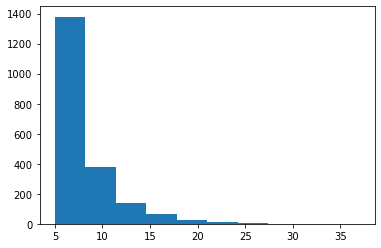

0 ATSSPVZ
1 APSTTXZ
2 APSTTXZ
3 APVSSPVZ
4 ATSSSPXSXZ
5 ATPVZ
6 ATPVZ
7 ATPXVPXVSPXSTXZ
8 ATPXSTXZ
9 APVSPXVPXVSPVZ
10 ATPVZ
11 ATSSPVZ
12 APVPVZ
13 APSTXZ
14 APVPVZ
15 APVSPVZ
16 ATSPVZ
17 APVSPXVPVZ
18 APVSSSPXVSSPXVSSPVZ
19 APVSPVZ
20 ATPXVPXVSSPVZ
21 APSTTXZ
22 ATSSPXSXZ
23 ATPXVPXSXZ
24 APVPVZ
25 APVPVZ
26 ATSPXVPXVPVZ
27 APVPVZ
28 ATSPXSTXZ
29 APSXZ
30 APVPXSXZ
31 APVPXSXZ
32 APVSSSPVZ
33 ATPVZ
34 APSXZ
35 APVSPXVSSSSPVZ
36 APVSPXSTXZ
37 APSTXZ
38 ATSPXVSPVZ
39 APSTXZ
40 ATSSSPXVPVZ
41 ATSSPVZ
42 APSTXZ
43 APVSPVZ
44 ATPVZ
45 APVPVZ
46 ATPVZ
47 APVPVZ
48 APSTTTXZ
49 ATSPXSXZ
50 APVSSSPVZ
51 ATPXSXZ
52 APVSPXVPXSXZ
53 APVSPVZ
54 APVPVZ
55 ATSPXVPVZ
56 ATPVZ
57 ATPVZ
58 ATPXSTTXZ
59 ATPVZ
60 ATSPVZ
61 APVSSPXSTXZ
62 ATPVZ
63 ATPXSTTTTXZ
64 APSXZ
65 APSTTTTXZ
66 ATPXVPXSXZ
67 APVSSPVZ
68 ATPXVPVZ
69 APVSSSSPVZ
70 APVSSSPVZ
71 APVSPVZ
72 ATSSPVZ
73 ATSPVZ
74 APSXZ
75 ATSPVZ
76 APSXZ
77 ATSPXSXZ
78 ATSPVZ
79 APVSPXSXZ
80 ATPXVPVZ
81 ATSSSSPVZ
82 APSTTXZ
83 ATSSPVZ
84 ATSPVZ
85 ATSPXSX

1753 ATPVZ
1754 ATSSSPVZ
1755 APVSSPXVPXVSSPXVPVZ
1756 APVPVZ
1757 APVSPVZ
1758 ATSPXVPXSXZ
1759 ATSSPXSTTTTXZ
1760 ATSSSPVZ
1761 ATSPXVSSPXSTXZ
1762 APSXZ
1763 ATPVZ
1764 APVPVZ
1765 APVSSSPXSXZ
1766 ATSSPXSTXZ
1767 ATSSPXVSSPVZ
1768 APSXZ
1769 ATSPVZ
1770 APVSSPVZ
1771 APVPXSXZ
1772 ATPVZ
1773 ATPXVPXSXZ
1774 ATSSPVZ
1775 APSXZ
1776 APSXZ
1777 APVPVZ
1778 ATPVZ
1779 APSXZ
1780 APVPVZ
1781 ATPXVSPVZ
1782 ATPVZ
1783 ATSSPVZ
1784 ATSSSSPXSXZ
1785 APVSSPVZ
1786 APVSSPVZ
1787 ATSSPXVPVZ
1788 APVSSSPXVSPVZ
1789 APVSPVZ
1790 ATSSPVZ
1791 APVSPXVPVZ
1792 APVSPXVPVZ
1793 ATSSSPXSTXZ
1794 ATPXSTXZ
1795 APSXZ
1796 ATPVZ
1797 APSTXZ
1798 APSTXZ
1799 APSTTXZ
1800 ATSSPVZ
1801 ATPVZ
1802 APSXZ
1803 APSXZ
1804 APVSPXSXZ
1805 APSXZ
1806 APVSSSSSPVZ
1807 ATPVZ
1808 ATPVZ
1809 ATPVZ
1810 APSTXZ
1811 ATPXVSSPVZ
1812 ATPXVPVZ
1813 ATSPVZ
1814 APVSPXSXZ
1815 APVPXSXZ
1816 ATSPXVSSSPXSTXZ
1817 APVPXSTTTTTXZ
1818 APVSSPVZ
1819 APSTTXZ
1820 ATSSSPVZ
1821 APSTXZ
1822 APVSPVZ
1823 ATPXSTTTXZ
1824 ATPVZ
1825 A

In [4]:
in_strings_alpha = [rg_inputoutput[i][0] for i in range(len(rg_inputoutput))]
dict_count_allTransitions = rg.count_allTransitions(in_strings_alpha)

# NOF TOTAL CHARACTERS in the input stream
total_len_inputstream = 0
for string in in_strings_alpha:
    total_len_inputstream += len(string)
    
# Plotting HISTOGRAM of REBER STRING's LENGTH
len_rg_exs = []

for ex in in_strings_alpha:
    len_rg_exs.append(len(ex))

print(f'A total of {len(in_strings_alpha)} strings were generated. \n\n\
With: \n\
NOF characters in total = {total_len_inputstream}. \n\
Mean length of string = {np.mean(len_rg_exs)}. \n\
Median length of string = {np.median(len_rg_exs)}. \n\
\n Unique Strings = {np.unique(in_strings_alpha)}. \n\
NOF Unique Strings = {len(np.unique(in_strings_alpha))}.')

plt.figure()
plt.hist(len_rg_exs)
plt.show()
    
# Printing all input reber strings    
for i, string in enumerate(in_strings_alpha):
    print(i, string)

# Generating xticks for plots based on characters-minicols
xticks_plot = np.empty(N, dtype=object)
for ch in chars:
    xticks_plot[charsMC[ch]] = ch

# Running Experiment

In [5]:
dict_params = {
    'M': M,
    'N': N,
    'k': k,
    'maxDendritesPerCell': maxDendritesPerCell,
    'maxSynapsesPerDendrite': maxSynapsesPerDendrite,
    'nmdaThreshold': nmdaThreshold,
    'permThreshold': permThreshold,
    'learningThreshold': learningThreshold,
    'permInit': permInit,
    'permInit_sd': permInit_sd,
    'perm_decrement': perm_decrement,
    'perm_increment': perm_increment,
    'perm_decay': perm_decay,
    'do_ERG': do_ERG,
    'nof_strings': nof_strings,
    'reber_strings': reber_strings,
    'string_max_length': string_max_length,
    'sort_by_length': sort_by_length,
    'verbose': verbose,
    'trial': trial
}

start = time.time()

exp = Experimentor(cellsPerColumn=M, numColumns=N, columnsPerChar=k, 
                   maxDendritesPerCell=maxDendritesPerCell, maxSynapsesPerDendrite=maxSynapsesPerDendrite, 
                   nmdaThreshold=nmdaThreshold, permThreshold=permThreshold,
                   learningThreshold=learningThreshold,
                   permInit=permInit, permInit_sd = permInit_sd,
                   perm_decrement=perm_decrement, perm_increment=perm_increment, perm_decay=perm_decay,
                   rg=rg, rg_inputoutput=rg_inputoutput,
                   htm_network=None,
                   verbose=verbose)

dict_results = exp.run_experiment()

print(time.time()-start)

# sys.getsizeof(dict_results['results'])

results = dict_results['results']
results.set_index('reber_string', inplace=True)


  String_idx:  0  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 8 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 22 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 27 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 41 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 44 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 48 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 62 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 72 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 77 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite: 

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 69 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 70 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 73 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 78 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 82 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 84 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 90 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 98 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 111 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 116 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 119 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 143

 MATCH FOUND. Cell { 12 , 177 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 180 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 181 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 212 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  2  for:  S  
 MATCH FOUND. Cell { 15 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Ex

 MATCH FOUND. Cell { 6 , 69 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 70 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 73 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 78 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 82 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 84 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

 MATCH FOUND. Cell { 14 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 44 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 48 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 101 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 131 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 147 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 159 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 160 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 171 }; dendrite:  0 . OverlapScore:  32 . Reinfor

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 30 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 34 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 53 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 58 }; dendrite:  0 . OverlapScore:  32 . Reinforcing 

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 56 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 59 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 74 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 75 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 81 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 88 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 106 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 108 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 112 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 117 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 135 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 13

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 51 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 64 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 69 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 70 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 73 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 78 } w

 MATCH FOUND. Cell { 0 , 143 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 14 143 } with  32  new synapses. 
 MATCH FOUND. Cell { 12 , 154 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 13 154 } with  32  new synapses. 
 MATCH FOUND. Cell { 15 , 157 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 5 157 } with  32  new synapses. 
 MATCH FOUND. Cell { 5 , 162 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 2 162 } with  32  new syn

 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 13 44 } with  32  new synapses. 
 MATCH FOUND. Cell { 6 , 48 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 10 48 } with  32  new synapses. 
 MATCH FOUND. Cell { 0 , 62 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 15 62 } with  32  new synapses. 
 MATCH FOUND. Cell { 6 , 72 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 8 72 } with  32  new synapses. 
 MATCH FOUND. Cell { 3 , 77 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 173 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 182 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 183 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 197 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 202 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 206 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 207 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 213 } with  32  new synapses. 
  Running for step:  2  for:  S  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 3 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 4 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 9 } with  32  new synapses. 
 NO MATCH FOUND. Grow

 MATCH FOUND. Cell { 6 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 14 2 } with  32  new synapses. 
 MATCH FOUND. Cell { 10 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 6 5 } with  32  new synapses. 
 MATCH FOUND. Cell { 4 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 13 6 } with  32  new synapses. 
 MATCH FOUND. Cell { 10 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 1 25 } with  32  new synapses. 
 MATCH

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 0 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 7 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 16 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 24 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 26 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 30 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 34 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 53 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 58 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 65 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 68 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 97 } with

 MATCH FOUND. Cell { 8 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 42 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Syn

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 33 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 39 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 57 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 63 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 67 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 76 }; dendrite:  0 . OverlapScore:  32 . Reinforcing 

 MATCH FOUND. Cell { 9 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

 MATCH FOUND. Cell { 10 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 18 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 19 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 20 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (11, 222) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (12, 52) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (12, 54) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (12, 186) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (13, 9) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (13, 109) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (13, 146) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (14, 144) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (15, 200) } with  32  new synapses.  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 156 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 167 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 177 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 180 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 181 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 212 }; dendrite:  0 . OverlapScore:  32 . Reinf

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 56 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 59 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 74 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 75 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 81 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 88 }; dendrite:  0 . OverlapScore:  32 . Reinforcin

  Running for step:  1  for:  T  
 MATCH FOUND. Cell { 10 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 18 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 19 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 20 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existi

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((6, 0), 32), ((10, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  3 ::::::::::::::::::::::::::::::::::  

  String_idx:  11  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
 MATCH FOUND. Cell { 6 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existin

 MATCH FOUND. Cell { 0 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 42 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Sy

 MATCH FOUND. Cell { 3 , 202 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 206 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 207 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 213 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  2  for:  S  
 MATCH FOUND. Cell { 8 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Exist

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 122 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 125 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 127 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 128 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 129 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 130 }; dendrite:  0 . OverlapScore:  32 . Rei

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((6, 0), 32), ((10, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  3 ::::::::::::::::::::::::::::::::::  

  String_idx:  19  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
 MATCH FOUND. Cell { 6 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existin

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((6, 0), 32), ((10, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  3 ::::::::::::::::::::::::::::::::::  

  String_idx:  21  Input String:  APVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
 MATCH FOUND. Cell { 0 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 23 }; dendrite:  0 . OverlapScore:  32 

 MATCH FOUND. Cell { 6 , 129 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 EXISTING DENDRITE FOUND. Cell { 9 , 129 }; dendrite:  0 . Reinforcing  32  synapses. Existing synapses=  32 
 MATCH FOUND. Cell { 15 , 130 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 EXISTING DENDRITE FOUND. Cell { 7 , 130 }; dendrite:  0 . Reinforcing  32  synapses. Existing synapses=  32 
 MATCH FOUND. Cell { 13 , 133 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 EXISTING DENDRITE FOUND. Cell { 2 , 133 }; dendrite:  0 . Reinforcing  32  synapses. Existing synapses=  32 
 MATCH FOUND. Cell { 7 , 140 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 EXISTING DENDRITE FOUND. Cell {

  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 51 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 64 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 69 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 70 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 73 } with  32  new syna

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 162 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 165 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 169 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 187 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 193 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 199 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 203 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 214 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 217 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 223 } with  32  new synapses. 
  Running for step:  6  for: Z  

  String_idx:  24  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  fo

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { 

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 180 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 181 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 212 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  
 MATCH FOUND. Cell { 9 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FO

 MATCH FOUND. Cell { 13 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 42 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Sy

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  10  for: Z  

  String_idx:  28  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
 MATCH FOUND. Cell { 0 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. E

 MATCH FOUND. Cell { 9 , 134 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 137 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 139 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 144 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 146 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 153 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
 MATCH FOUND. Cell { 10 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 44 }; 

  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 51 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 64 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 69 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 70 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on

 MATCH FOUND. Cell { 12 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 44 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 48 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 62 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 72 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  n

  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
 MATCH FOUND. Cell { 0 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 42 }; dendrite:  0 . OverlapScore:  32 . Re

 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 12 3 } with  32  new synapses. 
 MATCH FOUND. Cell { 3 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 2 4 } with  32  new synapses. 
 MATCH FOUND. Cell { 8 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 6 9 } with  32  new synapses. 
 MATCH FOUND. Cell { 2 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 11 23 } with  32  new synapses. 
 MATCH FOUND. Cell { 7 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXI

 MATCH FOUND. Cell { 15 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 13 1 } with  32  new synapses. 
 MATCH FOUND. Cell { 4 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 7 21 } with  32  new synapses. 
 MATCH FOUND. Cell { 3 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 0 29 } with  32  new synapses. 
 MATCH FOUND. Cell { 4 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 9 45 } with  32  new synapses. 
 MAT


  String_idx:  36  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
 MATCH FOUND. Cell { 9 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Exist

 MATCH FOUND. Cell { 2 , 175 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 189 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 190 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 198 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 210 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 211 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((5, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  39  Input String:  ATSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 51 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 64 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 69 }; dendrite:  0 . OverlapScore:  32 . Reinforci


  String_idx:  41  Input String:  ATPXVSSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
 MATCH FOUND. Cell { 0 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Gro


  String_idx:  43  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
 MATCH FOUND. Cell { 13 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Exis

  Running for step:  6  for:  V  
 MATCH FOUND. Cell { 14 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 55 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing

 MATCH FOUND. Cell { 5 , 73 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 78 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 82 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 84 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 90 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 98 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new 


  String_idx:  47  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
 MATCH FOUND. Cell { 9 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Exist

 MATCH FOUND. Cell { 15 , 109 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 14 109 } with  32  new synapses. 
 MATCH FOUND. Cell { 7 , 113 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 1 113 } with  32  new synapses. 
 MATCH FOUND. Cell { 1 , 132 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 2 132 } with  32  new synapses. 
 MATCH FOUND. Cell { 10 , 134 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 3 134 } with  32  new syna

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 15 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 30 }; dendrite:  0 . OverlapScore:  32 . R

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 184 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 194 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 195 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 196 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 201 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 205 }; dendrite:  0 . OverlapScore:  32 . Reinfo

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  
 MATCH FOUND. Cell { 15 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 30 }; dendrite:  0 . OverlapScore:  32 . Re

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((5, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  5 ::::::::::::::::::::::::::::::::::  

  String_idx:  53  Input String:  ATSPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
 MATCH FOUND. Cell { 0 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remainin


  String_idx:  54  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  
 MATCH FOUND. Cell { 7 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 26 }; dendrite:  0 . OverlapScore:  3

 MATCH FOUND. Cell { 4 , 74 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 75 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 81 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 88 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 106 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 108 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  n

 MATCH FOUND. Cell { 1 , 216 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 219 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 

  String_idx:  56  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH F

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

 MATCH FOUND. Cell { 11 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

 MATCH FOUND. Cell { 11 , 54 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 61 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 66 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 71 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 104 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 107 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  3  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((11, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  60  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
 MATCH FOUND. Cell { 0 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 23 }; dendrite:  0 . OverlapScore:  32 .

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  String_idx:  61  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing

  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  65  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
 MATCH FOUND. Cell { 12 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 23 }; dendrite:  0 . OverlapScore:  32 .

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  12  for: Z  

  String_idx:  67  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 2 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 5 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 6 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 25 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 47 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 55 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 56 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 59 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 74 } with  32  

 MATCH FOUND. Cell { 0 , 221 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  69  Input String:  ATSSSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing s

  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 8 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 22 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 27 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 41 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 44 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 48 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 62 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 72 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 77 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  10  for:  P  
 MATCH FOUND. Cell { 8 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 44 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existi

  Running for step:  15  for: Z  

  String_idx:  71  Input String:  ATSSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Re

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  9  for:  X  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((13, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  9 ::::::::::::::::::::::::::::::::::  

  String_idx:  72  Input String:  ATPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
 MATCH FOUND. Cell { 10 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapse

 MATCH FOUND. Cell { 4 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 44 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  77  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
 MATCH FOUND. Cell { 13 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cell

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 200 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 208 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 209 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 218 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 222 } with  32  new synapses. 
  Running for step:  6  for:  X  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((13, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  79  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  80  Input String:  ATPXSXZ
  Runni

  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 10 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 15 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 17 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 18 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 19 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 20 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 28 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 31 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 33 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 39 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 57 } with  32  new s

  Running for step:  13  for: Z  

  String_idx:  82  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  83  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

 MATCH FOUND. Cell { 6 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

  Running for step:  10  for: Z  

  String_idx:  86  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
 MATCH FOUND. Cell { 12 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 3

 MATCH FOUND. Cell { 6 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

 MATCH FOUND. Cell { 5 , 222 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  9  for:  P  
  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
  Running for step:  12  for:  T  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 10 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 15 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 17 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 18 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 19 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 20 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 28 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 31 } with  32  new synapses. 
 N

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  P  
 MATCH FOUND. Cell { 8 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 44 }; 

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  10  :::::::::::::::::::::::::::::::::::::::::::  
[((13, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  16 ::::::::::::::::::::::::::::::::::  

  String_idx:  89  Input String:  ATSPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
 MATCH FOUND. Cell { 13 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  11  for: Z  

  String_idx:  90  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  91  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  92  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
 MATCH FOUND. Cell { 15 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 21 }; dendrite:  0 . OverlapSco

  Running for step:  8  for: Z  

  String_idx:  94  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  95  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  96  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
 MATCH FOUND. Cell { 10 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synaps

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  98  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . Over

 MATCH FOUND. Cell { 15 , 220 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 221 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  10  for:  V  
 MATCH FOUND. Cell { 1 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 55 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing


  String_idx:  101  Input String:  APVSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  Running for step:  8  for:  S  
 MATCH FOUND. Cell { 11 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 9 3 } with  22  new synapses. 
 MATCH FOUND. Cell { 9 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 5 4 } with  26  new synapses. 
 MATCH FOUND. Cell { 11 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 15 9 } with  23  new synapses. 
 MATCH FOUND. Cell { 5 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 0 23 

  Running for step:  11  for: Z  

  String_idx:  102  Input String:  ATPXVPXVSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
 MATCH FOUND. Cell { 5 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell

 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 15 137 } with  27  new synapses. 
 MATCH FOUND. Cell { 4 , 139 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 11 139 } with  25  new synapses. 
 MATCH FOUND. Cell { 9 , 144 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 8 144 } with  28  new synapses. 
 MATCH FOUND. Cell { 12 , 146 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 14 146 } with  27  new synapses. 
 MATCH FOUND. Cell { 15 , 153 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synaps

  REPETITION / MATCH FOUND. Cell { (0, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  7  for: Z  

  String_idx:  104  Input String:  ATSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
 MATCH FOUND. Cell { 6 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Syn

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 208 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 209 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 218 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 222 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  107  Input String:  APVSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for: 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  10  for:  V  
 MATCH FOUND. Cell { 1 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 55 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((13, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  7 ::::::::::::::::::::::::::::::::::  

  String_idx:  109  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  110  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  111  Input String:  ATSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 

 MATCH FOUND. Cell { 11 , 158 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 170 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 186 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 192 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 200 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 208 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  12  for:  X  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((13, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  12 ::::::::::::::::::::::::::::::::::  

  String_idx:  113  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
 MATCH FOUND. Cell { 13 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. 

 MATCH FOUND. Cell { 2 , 157 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 162 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 165 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 169 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 187 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 193 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing 

  Running for step:  7  for: Z  

  String_idx:  116  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . 

  Running for step:  7  for: Z  

  String_idx:  117  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . O


  String_idx:  118  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syn

  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 MATCH FOUND. Cell { 11 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synap

  Running for step:  9  for:  X  
  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
  Running for step:  12  for:  X  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 51 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 64 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 69 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 70 } with  32  new synapses. 
 NO MATCH

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  10  for: Z  

  String_idx:  122  Input String:  ATSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
 MATCH FOUND. Cell { 2 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 211 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 215 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 220 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 221 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  11  for: Z  

  String_idx:  123  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
 

  Running for step:  7  for: Z  

  String_idx:  125  Input String:  APSTTTTTTTTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendr

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  17  for: Z  

  String_idx:  126  Input String:  APVSSPXVSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendri

 MATCH FOUND. Cell { 4 , 210 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 211 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 215 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 220 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 221 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  8  for:  S  
  Running for step:  9  for:  P  
  Running for step:  10  for:  X  
  Running for step:  11  f

  Running for step:  15  for:  V  
  Running for step:  16  for: Z  
 MATCH FOUND. Cell { 0 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 30 }; dendrite:  0 . OverlapScore:  32 . 

 MATCH FOUND. Cell { 2 , 192 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 200 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 208 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 209 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 218 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 222 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  


  String_idx:  131  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  132  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing s

  Running for step:  8  for: Z  

  String_idx:  133  Input String:  APVPXVSSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 3 } with  32  new synapses. 
 MATCH FOUND. Cell { 13 , 4 }; dendrite:  0 . OverlapScore:  15 . Reinforcing  15  synapses. Existing synapses=  26 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 9 } with  32  new synapses. 
 MATCH FOUND. Cell { 0 , 23 }; dendrite:  0 . OverlapScore:  14 . Reinforcing  14  synapses. Existing synapses=  23 
 MATCH FOUND. Cell { 11 , 32 }; dendrite:  0 . OverlapScore:  14 . Reinforcing  14  synapses. Existing synapses=  26 
 MATCH FOUND. Cell { 14 , 42 }; dendrite:  0 . OverlapScore:  14 . Reinforcing  14  synapses. Existing synapses=  24 
 NO MATCH FOUND. Growing new dendrite:

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  12  for: Z  

  String_idx:  135  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . 


  String_idx:  137  Input String:  ATSSSSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exist

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
 MATCH FOUND. Cell { 11 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 42 }; de

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  139  Input String:  APSTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  10  for: Z  

  String_idx:  140  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 .

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  
 MATCH FOUND. Cell { 0 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 30 }; dendrite:  0 . OverlapScore:  32 . Re

 MATCH FOUND. Cell { 2 , 143 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 154 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 157 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 162 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 165 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 169 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 0 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 30 }; dendrite:  0 . OverlapScore:  32 . R

  Running for step:  7  for: Z  

  String_idx:  144  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  145  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 187 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 193 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 199 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 203 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 214 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 217 }; dendrite:  0 . OverlapScore:  32 . Reinf

  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  


  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 198 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 210 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 211 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 215 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 220 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 221 }; dendrite:  0 . OverlapScore:  32 . Reinf

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 198 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 210 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 211 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 215 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 220 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 221 }; dendrite:  0 . OverlapScore:  32 . Reinf

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  18  for: Z  

  String_idx:  154  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  155  Input String:  ATSSPXVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses: 

 MATCH FOUND. Cell { 0 , 199 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 203 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 214 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 217 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 223 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  T  
  REPETITION / MATCH FOU


  String_idx:  156  Input String:  ATSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing 

 MATCH FOUND. Cell { 9 , 98 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 111 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 116 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 119 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 143 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 154 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
 MATCH FOUND. Cell { 11 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 42 }; den

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  162  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  163  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  164  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATC

  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (1, 134) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (1, 208) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 113) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (3, 3) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (5, 4) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (5, 66) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (5, 71) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (5, 132) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (5, 218) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (6,

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  168  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  169  Input String:  ATSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dend

  Running for step:  10  for: Z  

  String_idx:  170  Input String:  APVSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
 MATCH FOUND. Cell { 6 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 42 }; dendrite:  0 . OverlapScore:  32 . Re

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  172  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  173  Input String:  APVSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 3 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 4 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 9 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 23 } with  32  new syna


  String_idx:  174  Input String:  APVSSSPXVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . R

  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
 MATCH FOUND. Cell { 12 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 44 }; dendrite:  0 . OverlapScore:  32 .

 MATCH FOUND. Cell { 14 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new 

  Running for step:  6  for: Z  

  String_idx:  178  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
 MATCH FOUND. Cell { 4 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing syna

  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  13  for:  V  
  Running for step:  14  for: Z  

  String_idx:  180  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
 MATCH FOUND. Cell { 15 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 18 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner


  String_idx:  181  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
 MATCH FOUND. Cell { 15 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 49 }; dendrite:  0 . OverlapScore: 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 0 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 7 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 16 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 24 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 26 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 30 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 34 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 53 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 58 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 65 } with  

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  9  for: Z  

  String_idx:  191  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  192  Input String:  APVSSSSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendr

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
 MATCH FOUND. Cell { 4 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 42 }; den

  Running for step:  13  for:  V  
  Running for step:  14  for: Z  

  String_idx:  193  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite: 


  String_idx:  195  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  196  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
 MATCH FOUND. Cell { 0 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synaps


  String_idx:  198  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH F


  String_idx:  199  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  200  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MAT


  String_idx:  202  Input String:  APVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
 MATCH FOUND. Cell { 10 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 32 }; dendrite:  0 . OverlapSco

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  
 MATCH FOUND. Cell { 5 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synaps

  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  
 MATCH FOUND. Cell { 12 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 30 }; den

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for: Z  

  String_idx:  207  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . 

  Running for step:  8  for: Z  
 MATCH FOUND. Cell { 12 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 30 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing 

 MATCH FOUND. Cell { 0 , 98 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 111 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 116 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 119 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 143 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 154 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0 

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

 MATCH FOUND. Cell { 3 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 44 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new S

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for:  V  
  Running for step:  12  for: Z  

  String_idx:  215  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  216  Input String:  ATPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing 

 MATCH FOUND. Cell { 2 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 51 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new 

  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  
 MATCH FOUND. Cell { 12 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 11 0 } with  32  new synapses. 
 MATCH FOUND. Cell { 14 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 7 7 } with  32  new synapses. 
 MATCH FOUND. Cell { 4 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA threshold 
 NO EXISTING DENDRITE. Growing new dendrite:  0  on cell { 5 16 } with  32  new synapses. 
 MATCH FOUND. Cell { 6 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Unlearnt Winner Cells > NMDA thresh

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  
 MATCH FOUND. Cell { 12 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinf

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  8  for: Z  

  String_idx:  221  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  222  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  
 MATCH FOUND. Cell { 12 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 16 }; dendrite:  0 . OverlapScore:

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for: Z  

  String_idx:  225  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  226  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  
 MATCH FOUND. Cell { 11 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Ex

  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32 

 MATCH FOUND. Cell { 3 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new S

  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 2 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 5 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 6 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 25 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 47 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 55 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 56 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 59 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 74 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 75 } with  32  new synapses. 
 NO MATCH FO


  String_idx:  231  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  232  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  233  Input String:  ATPXVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
 MATCH FOUND. Cell { 5 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 11 }; dendrite:  0 . Ov

  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  3

  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
 MATCH FOUND. Cell { 3 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 M

  Running for step:  9  for: Z  

  String_idx:  237  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
 MATCH FOUND. Cell { 0 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Ce

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  240  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  241  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  
 MATCH FOUND. Cell { 11 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  ne


  String_idx:  243  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 2 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 5 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 6 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 25 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 47 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 55 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 56 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 59 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for: Z  

  String_idx:  245  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 51 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 200 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 208 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 209 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 218 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 222 } with  32  new synapses. 
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  252  Input String:  APVSSSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  R

  Running for step:  8  for:  V  
  Running for step:  9  for:  S  
 MATCH FOUND. Cell { 4 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 42 }; dendrite:  0 . OverlapScore:  32 . Rei

  Running for step:  6  for: Z  

  String_idx:  254  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . O

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 8 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 22 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 27 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 41 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 44 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 48 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 62 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 72 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 77 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 85 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 93 } wit

  Running for step:  13  for: Z  

  String_idx:  256  Input String:  APVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 10 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 15 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 17 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 18 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 19 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 20 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 28 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on ce

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  P  
 MATCH FOUND. Cell { 9 , 8 }; dendrite:  0 . OverlapScore:  17 . Reinforcing  17  synapses. Existing synapses=  26 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 22 } with  32  new synapses. 
 MATCH FOUND. Cell { 5 , 27 }; dendrite:  0 . OverlapScore:  18 . Reinforcing  18  synapses. Existing synapses=  24 
 MATCH FOUND. Cell { 7 , 41 }; dendrite:  0 . OverlapScore:  15 . Reinforcing  15  synapses. Existing synapses=  24 
 MATCH FOUND. Cell { 9 , 44 }; dendrite:  0 . OverlapScore:  14 . Reinforcing  14  synapses. Existing synapses=  24 
 MATCH FOUND. Cell { 7 , 48 }; dendrite:  0 . OverlapScore:  15 . Reinforcing  15  synapses. Existing synapses=  24 
 MATCH FOUND. Cell { 4 , 62 }; dendrite:  0 . OverlapScore:  18 . Reinforcing  18  synapses. Existing synapses=  25 
 NO MATCH FOUND. Growing 

  Running for step:  6  for: Z  

  String_idx:  262  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  263  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  265  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfor

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  266  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
 MATCH FOUND. Cell { 2 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synap

 MATCH FOUND. Cell { 12 , 157 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 162 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 165 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 169 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 187 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 193 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  11  for: Z  
 MATCH FOUND. Cell { 8 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 30 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing 

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 199 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 203 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 214 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 217 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 223 } with  32  new synapses. 
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  271  Input String:  ATPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
 MATCH FOUND. Cell { 5 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 32 }; dendrite:  0 .

  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  272  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  273  Input String:  APVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
 MATCH FOUND. Cell { 1 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell {


  String_idx:  274  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syn


  String_idx:  276  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  277  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  278  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  279  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  282  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
 MATCH FOUND. Cell { 8 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  284  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  285  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  286  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  
 MATCH FOUND. Cell { 8 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapse

  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  290  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  291  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  292  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  293  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for 

  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  3

 MATCH FOUND. Cell { 3 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 44 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new S


  String_idx:  298  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
 MATCH FOUND. Cell { 2 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 

  Running for step:  6  for: Z  

  String_idx:  301  Input String:  ATSPXVSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
 MATCH FOUND. Cell { 3 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (15, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  305  Input String:  APSTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  10  for:  V  
  Running for step:  11  for: Z  

  String_idx:  308  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  310  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite: 

  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  313  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  314  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  315  Input String:  ATSSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exi

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  P  
 MATCH FOUND. Cell { 3 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 

  Running for step:  8  for: Z  

  String_idx:  317  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  318  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  319  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  320  Input String:  ATSSPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETI

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  12  for: Z  
 MATCH FOUND. Cell { 5 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 30 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing 

  Running for step:  10  for:  X  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 51 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 64 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 69 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 70 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 73 } with  32  new synapses. 
 NO MATCH FOUND. Growing new 

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  324  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND


  String_idx:  327  Input String:  ATSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing 

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  328  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapse

  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  X  
 MATCH FOUND. Cell { 8 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 50 }; d


  String_idx:  331  Input String:  ATPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH

  Running for step:  10  for: Z  

  String_idx:  332  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 .

  Running for step:  7  for: Z  

  String_idx:  333  Input String:  APVSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 .

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  337  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  338  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  339  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  340  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for 

  Running for step:  7  for: Z  

  String_idx:  341  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  345  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  346  Input String:  ATSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 190 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 198 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 210 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 211 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 215 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 220 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 221 } with  32  new synapses. 
  Running for step:  10  for: Z  

  String_idx:  347  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 1

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  348  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  349  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  350  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  351  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for 


  String_idx:  354  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  355  Input String:  ATSPXVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
 MATCH FOUND. Cell { 5 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 29 }; dendrite:  0 . Overlap


  String_idx:  357  Input String:  APVPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 51 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 64 } with  32  new synaps

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  6  for: Z  

  String_idx:  360  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . O

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
 MATCH FOUND. Cell { 8 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 50 }; dendrite:  0 . OverlapScore:  32 . R

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  10  for: Z  

  String_idx:  364  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  365  Input String:  APVSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
 MATCH FOUND. Cell { 12 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 22 }; dendrite:  0 . Overlap


  String_idx:  367  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  368  Input String:  ATPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MAT

  Running for step:  9  for: Z  

  String_idx:  369  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  370  Input String:  APVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 MATCH FOUND. Cell { 5 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses.

  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
  Running for step:  10  for:  X  
 MATCH FOUND. Cell { 10 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  

  Running for step:  16  for: Z  

  String_idx:  372  Input String:  APVSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
 MATCH FOUND. Cell { 14 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 18 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 19 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 20 };

 MATCH FOUND. Cell { 5 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 50 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Sy

  Running for step:  6  for: Z  

  String_idx:  375  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  376  Input String:  ATSSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exis

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 119 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 143 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 154 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 157 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 162 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 165 }; dendrite:  0 . OverlapScore:  32 . Reinfo

  Running for step:  8  for: Z  

  String_idx:  378  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  379  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (0, 197) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (0, 202) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (1, 160) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (1, 207) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (2, 89) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (2, 101) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (2, 182) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (3, 17) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell { (3, 131) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  1  on cell {


  String_idx:  386  Input String:  ATSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  387  Input String:  ATPXVSSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  Running for step:  11  for:  X  
  Running for step:  12  for:  V  
 MATCH FOUND. Cell { 12 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 55 }; dendrite:  0 . OverlapScore:  32 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  394  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  395  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  
 MATCH FOUND. Cell { 10 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Syna


  String_idx:  401  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  402  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existin

  Running for step:  7  for: Z  

  String_idx:  403  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . 

  Running for step:  7  for: Z  

  String_idx:  404  Input String:  APSTTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=


  String_idx:  405  Input String:  ATSSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existi

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  X  
  Running for step:  12  for: Z  

  String_idx:  406  Input String:  APVPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
 MATCH FOUND. Cell { 4 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner 

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for: Z  

  String_idx:  412  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
 MATCH FOUND. Cell { 3 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  ne

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  415  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  416  Input String:  APVPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 MATCH FOUND. Cell { 5 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses.

  Running for step:  10  for: Z  

  String_idx:  418  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 .

  Running for step:  7  for: Z  

  String_idx:  419  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  420  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing s

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  423  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  425  Input String:  APVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 4 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 11 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 51 } with  32

  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  428  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for: Z  

  String_idx:  429  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  430  Input String:  APVPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  431  Input String:  ATPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running 

 MATCH FOUND. Cell { 3 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 55 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Syn

  Running for step:  6  for: Z  

  String_idx:  433  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  434  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . R

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  435  Input String:  APVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 146 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 153 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 158 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 170 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 186 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 192 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 200 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 208 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 209 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 218 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 222 } with  32  new synapses. 
  Running for step:  10  for:  X  
  Running for ste

  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 10 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  447  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  448  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  449  Input String:  APVSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  P  
 MATCH FOUND. Cell { 9 , 8 }; dendrite:  0 . Overl

  Running for step:  7  for: Z  

  String_idx:  451  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  452  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  453  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 


  String_idx:  457  Input String:  ATSSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 10 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Syn

  Running for step:  10  for: Z  

  String_idx:  459  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  460  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  461  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  462  Input String:  APVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running 


  String_idx:  464  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing s

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  11  for: Z  

  String_idx:  468  Input String:  ATSSPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 .

  Running for step:  11  for:  V  
 MATCH FOUND. Cell { 11 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 55 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existi

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (7, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  15  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=

  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  REPETITION / MATCH FOUND. Cell { (14, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  20  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=


  String_idx:  471  Input String:  APVPXVSSSSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  472  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  473  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Runnin

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

 MATCH FOUND. Cell { 13 , 98 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 111 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 116 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 119 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 143 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 154 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0

  REPETITION / MATCH FOUND. Cell { (11, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  479  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  480  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  481  Input String:  ATSPXVSSSSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running 

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  482  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforc


  String_idx:  483  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  484  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  485  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  486  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  

  Running for step:  10  for: Z  

  String_idx:  488  Input String:  APVSSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite: 

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
  Running for step:  10  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  489  Input String:  APVPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 MATCH FOUND. Cell { 13 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 42 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell {

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  494  Input String:  APVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
 MATCH FOUND. Cell { 2 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 45 }; dendrite:  1 . OverlapScore: 

  Running for step:  10  for: Z  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 0 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 7 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 16 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 24 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 26 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 30 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 34 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 53 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 58 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 65 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 68 } with  32  new synapses. 
 NO MATCH FOUND. Growing new

  Running for step:  7  for: Z  

  String_idx:  498  Input String:  ATSSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . R

 MATCH FOUND. Cell { 11 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 55 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (12, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  10  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syna

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  502  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . Ov

  Running for step:  7  for: Z  

  String_idx:  503  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . O

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  506  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  507  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  508  Input String:  APVPXVSSPXVPXVSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 

  REPETITION / MATCH FOUND. Cell { (13, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN


  String_idx:  512  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  513  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  514  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  515  Input String:  ATSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  9  for:  P  
  Running for step:  10  for:  V  
  Running for step:  11  for: Z  

  String_idx:  518  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  519  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  520  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 .

  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  522  Input String:  APVSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  P  
 MATCH FOUND. Cell { 9 , 8 }; dendrite:  0 . OverlapScore:  17 . Reinforcing  17  synapses. Existing synapses=  17 
 Growing  15  new Synapses. Remaining Winner Cells:  3 
 MATCH FOUND. Cell { 12 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  526  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  527  Input String:  ATPXVSSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exis

  REPETITION / MATCH FOUND. Cell { (13, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syn

 MATCH FOUND. Cell { 13 , 98 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 111 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 116 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 119 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 143 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 154 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0

 MATCH FOUND. Cell { 3 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 55 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Syn

 MATCH FOUND. Cell { 5 , 90 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 98 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 111 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 116 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 119 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 143 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  

  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 10 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 15 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 17 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 18 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 19 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 20 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 28 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 31 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 33 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 39 } with  32  new synapses. 
 NO MATCH 


  String_idx:  533  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforci

  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=


  String_idx:  535  Input String:  ATPXVSPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 2 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 7 5 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 3 6 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 25 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 47 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 3 55 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 56 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on 

  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . Ove

 MATCH FOUND. Cell { 14 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 30 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new 

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  538  Input String:  ATSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  540  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.


  String_idx:  541  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
 MATCH FOUND. Cell { 4 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 4 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 30 }; dendrite:  0 . OverlapScore:  32 . 

  Running for step:  7  for: Z  

  String_idx:  546  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  547  Input String:  ATPXSTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  550  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  551  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syna

  Running for step:  8  for: Z  

  String_idx:  552  Input String:  ATPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 2 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 5 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 7 6 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 25 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 47 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 55 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 56 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cel

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  562  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 0 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 7 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 16 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 24 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 26 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 30 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 34 } with  32  n

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . Overl

  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . Overla

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  568  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo


  String_idx:  571  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  572  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  573  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  574  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  

  Running for step:  10  for: Z  

  String_idx:  577  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  578  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  579  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 .

  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  582  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapse


  String_idx:  584  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  585  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  
 MATCH FOUND. Cell { 13 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing 

  Running for step:  6  for:  V  
 MATCH FOUND. Cell { 8 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 55 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing sy

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 132 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 134 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 137 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 139 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 144 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 146 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 153 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 158 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 170 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 186 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 192 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell {

  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  9  for:  S  
  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  596  Input String:  APVPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  597  Input String:  APVSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / 


  String_idx:  598  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syn


  String_idx:  600  Input String:  ATSPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 8 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 9 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 8 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 51 } with  32  new synapses. 
 NO MATCH FOUND.

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

 MATCH FOUND. Cell { 7 , 117 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 135 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 138 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 141 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 142 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 161 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  12  for: Z  

  String_idx:  605  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  606  Input String:  ATPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 3 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 4 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 9 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 23 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 32 } 


  String_idx:  608  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  609  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  610  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  611  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running f


  String_idx:  612  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  613  Input String:  ATSPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MAT

  Running for step:  10  for:  V  
  Running for step:  11  for: Z  
 MATCH FOUND. Cell { 4 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 30 }; dendrite:  0 . OverlapScore:  32 .

  Running for step:  7  for: Z  

  String_idx:  615  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  616  Input String:  APVSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  617  Input String:  ATPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU


  String_idx:  618  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforc


  String_idx:  619  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforci

  Running for step:  11  for: Z  

  String_idx:  622  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  623  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  624  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  625  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for 

  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  6  for: Z  

  String_idx:  633  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . 

  Running for step:  7  for: Z  

  String_idx:  634  Input String:  APVSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  

  Running for step:  11  for: Z  

  String_idx:  635  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 4 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 30 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existin

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 178 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 184 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 194 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 195 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 196 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 201 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 205 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 216 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 219 } with  32  new synapses. 

  String_idx:  639  Input String:  APVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Runn

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for: Z  

  String_idx:  643  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  644  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATC


  String_idx:  647  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  648  Input String:  APVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 0 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 7 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 16 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 24 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 26 } with  32  new synapses. 
 NO MATCH FOUN

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  650  Input String:  APVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 4 51 } with  32  new synapses. 
 NO MATCH FOUND. Gr

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  13  for:  X  
  Running for step:  14  for:  V  
  Running for step:  15  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  15 ::::::::::::::::::::::::::::::::::  

  String_idx:  654  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  655  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  
 MATCH FOUND. Cell { 1 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. 

  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
  Running for step:  12  for:  T  
  Running for step:  13  for:  X  
 MATCH FOUND. Cell { 6 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells: 

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  11  for:  X  
  Running for step:  12  for:  S  
  Running for step:  13  for:  X  
  Running for step:  14  for: Z  
 MATCH FOUND. Cell { 3 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  3

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  12  for:  P  
  Running for step:  13  for:  X  
  Running for step:  14  for:  S  
  Running for step:  15  for:  X  
  Running for step:  16  for: Z  

  String_idx:  664  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Re

  Running for step:  6  for: Z  

  String_idx:  667  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  668  Input String:  ATPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
 MATCH FOUND. Cell { 7 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 124 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 126 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 145 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 151 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 155 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 166 }; dendrite:  0 . OverlapScore:  32 . Reinf

  Running for step:  6  for: Z  

  String_idx:  675  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  676  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  677  Input String:  ATPXVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
 MATCH FOUND. Cell { 7 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Gro

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  8  for: Z  

  String_idx:  679  Input String:  ATSPXVSSSPXVPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  3

  Running for step:  11  for:  V  
 MATCH FOUND. Cell { 8 , 2 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 5 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 6 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 25 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 47 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 55 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing 

  Running for step:  19  for:  P  
  Running for step:  20  for:  V  
  Running for step:  21  for: Z  

  String_idx:  680  Input String:  ATSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATC

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  684  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
 MATCH FOUND. Cell { 13 , 2 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 5 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 6 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 25 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 47 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 55 }; dendrite:  1 . OverlapScore:  32 . Re

 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 100 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 103 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 122 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 125 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 127 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 128 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 129 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 130 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 133 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 140 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 149 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell {

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  690  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  691  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1

  Running for step:  8  for: Z  

  String_idx:  692  Input String:  APVPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforci

  Running for step:  10  for: Z  

  String_idx:  693  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  694  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendri

  Running for step:  10  for:  V  
  Running for step:  11  for:  S  
  Running for step:  12  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  119  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  12 ::::::::::::::::::::::::::::::::::  

  String_idx:  696  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  697  Input String:  APVPXVSSPVZ
  Running for step:  0  for

  Running for step:  11  for:  S  
 MATCH FOUND. Cell { 7 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 32 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 42 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existi

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  9  for: Z  

  String_idx:  704  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 .

  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  11  for:  V  
  Running for step:  12  for: Z  

  String_idx:  707  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  708  Input String:  ATSPXVPXVSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
 MATCH FOUND. Cell { 12 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining

  Running for step:  16  for: Z  
 MATCH FOUND. Cell { 14 , 0 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 7 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 16 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 24 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 26 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 30 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existin

  Running for step:  11  for:  X  
  Running for step:  12  for: Z  

  String_idx:  710  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  711  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  712  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MA

  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (10, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN


  String_idx:  717  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH F


  String_idx:  719  Input String:  APVSSPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Re

 MATCH FOUND. Cell { 9 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 44 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 48 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 62 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Sy

  Running for step:  11  for:  V  
  Running for step:  12  for:  P  
  Running for step:  13  for:  X  
  Running for step:  14  for:  V  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((9, 1), 32), ((12, 0), 32), ((12, 1), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  14 ::::::::::::::::::::::::::::::::::  

  String_idx:  722  Input String:  APVSSSSSSPXVSSSSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  3

  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapse

  Running for step:  11  for:  V  
  Running for step:  12  for:  S  
  Running for step:  13  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . Ov

  Running for step:  16  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  

  REPETITION / MATCH FOUND. Cell { (4, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  724  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  725  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  7  for: Z  

  String_idx:  726  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . 

  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  REPETITION / MATCH FOUND. Cell { (13, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (

  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  Running for step:  11  for: Z  

  String_idx:  736  Input String:  APVSPXVPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
 MATCH FOUND. Cell { 10 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  sy

  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  739  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  740  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 

  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  X  
 MATCH FOUND. Cell { 5 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Sy

  Running for step:  10  for:  V  
  Running for step:  11  for:  P  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 8 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 22 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 27 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 41 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 44 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 2 48 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 7 62 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 72 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 77 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 85 } with  32  new syn

  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . Overla

  Running for step:  12  for: Z  

  String_idx:  749  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  753  Input String:  ATPXVSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
 MATCH FOUND. Cell { 7 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Exist

  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  756  Input String:  ATSSSSSPXVSSSSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETIT

  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6 

  REPETITION / MATCH FOUND. Cell { (5, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  19  for:  V  
  Running for step:  20  for:  P  
  Running for step:  21  for:  V  
  Running for step:  22  for: Z  

  String_idx:  757  Input String:  ATPXVSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  S  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 3 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 4 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 3 9 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 1 23 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 32 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on

  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  P  
 MATCH FOUND. Cell { 1 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing 

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
 MATCH FOUND. Cell { 12 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Syna

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  


  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  763  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing 

  Running for step:  6  for: Z  

  String_idx:  765  Input String:  ATSSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Re

  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  766  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  767  Input String:  ATSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . 

  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  768  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 

  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . Overla

  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  771  Input String:  APVSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
 MATCH FOUND. Cell { 7 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 25 };

  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  776  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C


  String_idx:  777  Input String:  ATPXVSSSPXVSSSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION

  Running for step:  10  for:  V  
  Running for step:  11  for:  S  
 MATCH FOUND. Cell { 10 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 23 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 32 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 42 }; dendrite:  1 . OverlapScore:  32 .

  REPETITION / MATCH FOUND. Cell { (0, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 23) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 158) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 9) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 61) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 208) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 23) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 158) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 9) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 61) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 208) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (14, 4) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 222) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 66) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 146) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  18  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 23) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 158) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=

  REPETITION / MATCH FOUND. Cell { (13, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  779  Input String:  ATPXSXZ
  Running for s

  Running for step:  11  for:  V  
  Running for step:  12  for:  S  
  Running for step:  13  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  119  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  13 ::::::::::::::::::::::::::::::::::  

  String_idx:  781  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  782  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  

  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU


  String_idx:  784  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  785  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syna

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  11  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses= 

  Running for step:  15  for: Z  

  String_idx:  787  Input String:  APVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  788  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  789  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / M


  String_idx:  790  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  791  Input String:  ATPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
 MATCH FOUND. Cell { 12 , 2 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 5 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 6 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synap

  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  796  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  797  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  798  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  799  Input String:  APSTXZ
  Running fo


  String_idx:  802  Input String:  ATSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  3

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (14, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  10  for:  P  
  Running for step:  11  for:  X  
  Running for step:  12  for:  V  
  Running for step:  13  for:  P  
 MATCH FOUND. Cell { 1 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Ex

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  810  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforc

  Running for step:  7  for: Z  

  String_idx:  811  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo

  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . Overla

  Running for step:  10  for:  P  
  Running for step:  11  for:  X  
  Running for step:  12  for:  S  
  Running for step:  13  for:  X  
  Running for step:  14  for: Z  

  String_idx:  817  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  818  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  819  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  82

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  6  for: Z  

  String_idx:  829  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  830  Input String:  ATSPXVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MA

  Running for step:  12  for:  X  
  Running for step:  13  for: Z  

  String_idx:  831  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  832  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  833  Input String:  APVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  834  Input String:  ATSPXVSPXVPVZ
  R


  String_idx:  836  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  837  Input String:  APVSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATC

  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  838  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  839  Input String:  ATSSSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; d

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  P  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 8 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 22 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 27 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 41 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 44 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 14 48 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 62 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 1 72 } with  32  new synapses. 
 NO MATCH FOUND. Growing ne

  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  845  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  846  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  847  Input String:  APVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for 

  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synap

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  853  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . Overl

  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  P  
 MATCH FOUND. Cell { 6 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 11 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 22 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Sy

  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  860  Input String:  ATSSPXVSSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / M

  Running for step:  10  for:  X  
  Running for step:  11  for:  V  
  Running for step:  12  for:  S  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 3 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 4 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 9 9 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 23 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 32 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 42 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 46 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 52 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 54 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 61 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  14  for: Z  

  String_idx:  862  Input String:  ATSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfor

  REPETITION / MATCH FOUND. Cell { (4, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  872  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  873  In

  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32 

  REPETITION / MATCH FOUND. Cell { (13, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapB

  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . Overl


  String_idx:  880  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  881  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MAT


  String_idx:  885  Input String:  APVSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  886  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  887  Input String:  APVSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syn

  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  889  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  890  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  891  Input String:  ATSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATC

  Running for step:  9  for: Z  
 MATCH FOUND. Cell { 7 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 24 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 26 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 30 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing sy

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  f


  String_idx:  900  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforci

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (15, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  

  Running for step:  10  for: Z  

  String_idx:  907  Input String:  ATSPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
 MATCH FOUND. Cell { 5 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 45 }; dendrite:  1 . OverlapScore

  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . Overla

  REPETITION / MATCH FOUND. Cell { (14, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  11  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (13, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN


  String_idx:  915  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  916  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  917  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
 MATCH FOUND. Cell { 4 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Wi

  Running for step:  8  for: Z  

  String_idx:  919  Input String:  ATSSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . R

  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  9  for:  P  
  Running for step:  10  for:  V  
  Running for step:  11  for: Z  

  String_idx:  920  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  923  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  924  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATC

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
 MATCH FOUND. Cell { 10 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 23 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 32 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 42 }; d

 MATCH FOUND. Cell { 5 , 78 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 82 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 84 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 90 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 98 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 111 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  ne

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  934  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . O

  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  935  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  936  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  937  Input String:  APVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running fo

  Running for step:  6  for: Z  

  String_idx:  939  Input String:  APVSSSSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite: 

  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  

  Running for step:  10  for:  V  
  Running for step:  11  for:  P  
  Running for step:  12  for:  V  
  Running for step:  13  for: Z  
 MATCH FOUND. Cell { 10 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 24 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 26 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:

  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  941  Input String:  ATSSSSSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; 

  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  15  for: Z  

  String_idx:  942  Input String:  ATSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  943  Input String:  APSTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . 

  REPETITION / MATCH FOUND. Cell { (3, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell


  String_idx:  946  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  947  Input String:  ATSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION 

  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
  Running for step:  12  for:  T  
 MATCH FOUND. Cell { 6 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 18 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Exist

  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  950  Input String:  APVSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MAT


  String_idx:  951  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  952  Input String:  ATSPXVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / M

  Running for step:  13  for: Z  

  String_idx:  953  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  954  Input String:  ATSSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  3

  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses= 

  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
 MATCH FOUND. Cell { 10 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 23 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 32 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 42 }; dendrite:  1 . OverlapScore:  32 . 

  REPETITION / MATCH FOUND. Cell { (12, 132) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 134) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 32) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 170) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 218) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 4) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (14, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses

  Running for step:  14  for: Z  

  String_idx:  958  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 9 0 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 7 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 16 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 24 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 26 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 30 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 34 } with  32  new synapses. 
 NO MATCH FOUND. Gro

  Running for step:  7  for: Z  

  String_idx:  960  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . O

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  963  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  964  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  965  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH

  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  967  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  968  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  969  Input String:  APVSSSSSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. E

  REPETITION / MATCH FOUND. Cell { (7, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  S  
  Running for step:  12  for:  P  
  Running for step:  13  for:  X  
 MATCH FOUND. Cell { 7 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new 

  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  972  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  973  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  974  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATC

  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  979  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  980  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  981  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Re

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  984  Input String:  ATSSPVZ
  Running for ste

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for: Z  

  String_idx:  987  Input String:  APVSPXVSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:

  REPETITION / MATCH FOUND. Cell { (15, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  10  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses= 


  String_idx:  988  Input String:  ATSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synap

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  993  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  994  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  


  String_idx:  995  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  996  Input String:  ATSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exis

  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  997  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcin

  Running for step:  8  for: Z  

  String_idx:  998  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . O

  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  syn

  REPETITION / MATCH FOUND. Cell { (11, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1005  Input String:  APVSSPXSTTTXZ
  Running 

  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . Overl

  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  1011  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite

  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1013  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  

  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6 

  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
 MATCH FOUND. Cell { 10 , 1 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 21 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 29 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 45 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 49 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 50 }; 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6 

  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1024  Input String:  ATSPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 0 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells: 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  14  for: Z  

  String_idx:  1026  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1027  Input String:  ATSSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:

  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  X  
  Running for step:  12  for: Z  

  String_idx:  1028  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1029  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1030  Input String:  APVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; d

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1032  Input String:  ATSSSSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . 

  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  S  
  Running for step:  10  f

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (12, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  11  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syna

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
  Running for step:  12  for:  T  
  Running for step:  13  for:  X  
  Running for step:  14  for: Z  

  String_idx:  1039  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1040  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . R

  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1041  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for ste

  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1044  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1045  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  
 MATCH FOUND. Cell { 9 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 7 }; dendrite:  1 . OverlapScore: 

  Running for step:  8  for: Z  

  String_idx:  1048  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1049  Input String:  APVSPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 9 3 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 4 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 8 9 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1 

 MATCH FOUND. Cell { 1 , 99 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 110 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 114 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 115 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 120 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 124 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1063  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1064  Input String:  APVSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 1 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses.

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN


  String_idx:  1071  Input String:  ATSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing

  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1073  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses

  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 61 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 66 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 71 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 104 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 107 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 109 }; dendrite:  1 . OverlapScore:  32 . Reinforc

  Running for step:  17  for:  S  
  Running for step:  18  for:  X  
  Running for step:  19  for: Z  

  String_idx:  1077  Input String:  ATSSSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / M

  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (12, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO


  String_idx:  1085  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1086  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1087  Input String:  APVSSSSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses.

  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for: Z  

  String_idx:  1093  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . 

  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1096  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1097  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite

  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  9 


  String_idx:  1099  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1100  Input String:  ATSPXVPXSTTTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
 MATCH FOUND. Cell { 6 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Rema

  REPETITION / MATCH FOUND. Cell { (8, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  REPETITION / MATCH FOUND. Cell { (0, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (13, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  17  for:  X  
  Running for step:  18  for: Z  

  String_idx:  1101  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; den

  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  6  for: Z  

  String_idx:  1103  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1104  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1105  Input String:  ATSPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running 

  REPETITION / MATCH FOUND. Cell { (11, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  11  for: Z  

  String_idx:  1108  Input String:  ATPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing s

  REPETITION / MATCH FOUND. Cell { (13, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN


  String_idx:  1111  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1112  Input String:  APVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1113  Input String:  ATPXSTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETIT

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (13, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND


  String_idx:  1115  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1116  Input String:  APVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1117  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1118  Input String:  ATPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  R


  String_idx:  1119  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1120  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / M

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  10  for:  V  
  Running for step:  11  for:  S  
  Running for step:  12  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . Ov


  String_idx:  1122  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1123  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1124  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exist

  REPETITION / MATCH FOUND. Cell { (7, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for: Z  

  String_idx:  1126  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1127  Input String:  ATSPXVSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
 MATCH FOUND. Cell { 9 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 15 }; dendrite:  0 . Over


  String_idx:  1128  Input String:  APVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  Running for step:  6  for: Z  

  String_idx:  1131  Input String:  APVSPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite

  REPETITION / MATCH FOUND. Cell { (9, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1135  Input String:  ATSSSPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dend

  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  13  for: Z  

  String_idx:  1136  Input String:  APVSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite: 

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  1138  Input String:  APVSSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  REPETITION / MATCH FOUND. Cell { (7, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

 MATCH FOUND. Cell { 12 , 46 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 52 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 54 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 61 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 66 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 71 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

  REPETITION / MATCH FOUND. Cell { (13, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (5, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  1144  Input String:  ATPXVSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH

  Running for step:  10  for:  S  
  Running for step:  11  for:  X  
 MATCH FOUND. Cell { 9 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 50 }; dendrite:  1 . OverlapScore:  32 . 

  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (3, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1147  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1148  Input String:  ATSSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; d

  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  P  
  Running for step:  10  for:  V  
  Running for step:  11  for: Z  

  String_idx:  1149  Input String:  APVSPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:

  Running for step:  12  for:  X  
  Running for step:  13  for: Z  

  String_idx:  1150  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1151  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrit


  String_idx:  1152  Input String:  ATPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
 MATCH FOUND. Cell { 12 , 2 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 5 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 6 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 25 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner

 MATCH FOUND. Cell { 3 , 75 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 81 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 88 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 106 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 108 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 112 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0 

  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  8  for: Z  

  String_idx:  1159  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1160  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existi

  Running for step:  6  for: Z  

  String_idx:  1165  Input String:  APVSSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite: 

  Running for step:  12  for: Z  

  String_idx:  1166  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1167  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1168  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  3

  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  8  for: Z  

  String_idx:  1171  Input String:  ATSSSPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 

  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
  Running for step:  12  for:  X  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 8 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 7 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 50 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 51 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 64 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 69 } with  32  new synapses. 
 NO MATCH FOUND. Growing

  REPETITION / MATCH FOUND. Cell { (9, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 10 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 15 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 17 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 18 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 19 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 10 20 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 28 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 31 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 33 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 39 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  

  REPETITION / MATCH FOUND. Cell { (4, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1178  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1179  Input String:  ATSSSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses: 

  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
 MATCH FOUND. Cell { 12 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
 MATCH FOUND. Cell { 5 , 2 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 5 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 6 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 25 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 47 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synap

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel


  String_idx:  1185  Input String:  APVSSPXVSSSPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  3

  REPETITION / MATCH FOUND. Cell { (7, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1187  Input String:  ATSSSSSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . 

  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
  Running for step:  12  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . Ove

  Running for step:  6  for: Z  

  String_idx:  1192  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1193  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1194  Input String:  ATSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses.

  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . Overl

  Running for step:  7  for: Z  

  String_idx:  1197  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1198  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1199  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1200  Input String:  APSTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Ru

  REPETITION / MATCH FOUND. Cell { (7, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell


  String_idx:  1201  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1202  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION /

  Running for step:  7  for: Z  

  String_idx:  1206  Input String:  ATSSSSSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32

  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (9, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel


  String_idx:  1211  Input String:  ATSSSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exis

  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  P  
  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
  Running for step:  12  for:  X  
 MATCH FOUND. Cell { 1 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existin

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (5, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1218  Input String:  ATPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU


  String_idx:  1219  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1221  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1222  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1223  Input String:  ATSSSPXVSSSSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1

  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (5, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

 MATCH FOUND. Cell { 15 , 74 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 75 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 81 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 88 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 106 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 108 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0 

  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . Overl

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1229  Input String:  ATSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (0, 146) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 3) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 46) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 186) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 71) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 134) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 153) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 192) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (3, 222) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU


  String_idx:  1238  Input String:  ATSSPXVPXVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. 

  REPETITION / MATCH FOUND. Cell { (0, 146) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 3) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 46) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 186) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 134) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 153) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1241  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing

  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
 MATCH FOUND. Cell { 11 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 18 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 19 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 20 }; dendrite:  0 . OverlapScore:  32

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 52 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 54 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 61 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 66 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 71 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 104 }; dendrite:  0 . OverlapScore:  32 . Reinforcin

  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1249  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1250  Input String:  APVPXVPXVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
 MATCH FOUND. Cell { 9 , 2 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 5 }; dendrite:  1 . Overla

  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
 

  Running for step:  10  for: Z  

  String_idx:  1252  Input String:  APVSPXVSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dend

  REPETITION / MATCH FOUND. Cell { (4, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  15  for:  X  
  Running for step:  16  for: Z  

  String_idx:  1253  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1254  Input String:  APSTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendr

  REPETITION / MATCH FOUND. Cell { (5, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1256  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1257  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1258  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1259  Input String:  APVPXVSPXVSPXVS

  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1263  Input String:  ATPXVSPXVSPXVPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  S  
 MATCH FOUND. Cell { 10 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  syn

  REPETITION / MATCH FOUND. Cell { (0, 146) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 3) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 46) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 186) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 134) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 153) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  20  for:  V  
  Running for step:  21  for: Z  

  String_idx:  1264  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1265  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrit

  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1266  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1267  Input String:  APVSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running fo

  Running for step:  9  for:  T  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  192  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  9 ::::::::::::::::::::::::::::::::::  

  String_idx:  1269  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1270  Input String:  ATSSPXVSSSPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3

  REPETITION / MATCH FOUND. Cell { (4, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
  Running for step:  10  for:  X  
  Running for step:  11  for:  V  
  Running for step:  12  for:  S  
 MATCH FOUND. Cell { 1 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 23 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 32 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Sy

  Running for step:  12  for:  X  
  Running for step:  13  for: Z  

  String_idx:  1275  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrit

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1277  Input String:  ATSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for: Z  

  String_idx:  1287  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (7, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1291  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses

  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1294  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1295  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1296  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1297  Input String:  APSTXZ
  Running

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  X  
 MATCH FOUND. Cell { 9 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 50 }; de

  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1308  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH F

  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  10  for:  V  
  Running for step:  11  for: Z  

  String_idx:  1310  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:

  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  8  for: Z  

  String_idx:  1315  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1316  Input String:  ATSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; de

  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1317  Input String:  ATSSPXVPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / M

  REPETITION / MATCH FOUND. Cell { (0, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel


  String_idx:  1318  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1319  Input String:  APVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1320  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:

  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  1324  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1325  Input String:  APVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1326  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel


  String_idx:  1331  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1332  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1333  Input String:  APVSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION 

  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1334  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (4, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1337  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo

  REPETITION / MATCH FOUND. Cell { (6, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (3, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  1341  Input String:  ATPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
 MATCH FOUND. Cell { 15 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 23 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winne

 MATCH FOUND. Cell { 13 , 33 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 39 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 57 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 63 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 67 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 76 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

  Running for step:  9  for: Z  

  String_idx:  1349  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (6, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1353  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1354  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1355  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1356  Input String:  APVSSPXSXZ
  Ru

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1361  Input String:  APSTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  12  for:  V  
  Running for step:  13  for: Z  

  String_idx:  1363  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1364  Input String:  APVPXVPXVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 1 8 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 8 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 8 22 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrit

  REPETITION / MATCH FOUND. Cell { (7, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  13  for:  T  
  Running for step:  14  for:  T  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  160  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  14 ::::::::::::::::::::::::::::::::::  

  String_idx:  1375  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1376  Input String:  APVSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1382  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1383  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1384  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1385  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running fo


  String_idx:  1387  Input String:  ATPXVPXVPXSTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
 MATCH FOUND. Cell { 12 , 2 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 5 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 6 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 25 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remainin

  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1390  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH F

  Running for step:  9  for: Z  

  String_idx:  1393  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1394  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existin

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1395  Input String:  APVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . 

  Running for step:  10  for: Z  

  String_idx:  1400  Input String:  ATSPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  Running for step:  10  for:  V  
  Running for step:  11  for: Z  

  String_idx:  1401  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  8  for: Z  

  String_idx:  1402  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  14  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  213  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  14 ::::::::::::::::::::::::::::::::::  

  String_idx:  1405  Input String:  ATPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
 MATCH FOUND. Cell { 10 , 8 }; dendrite:  1 . OverlapScore:  32 . Reinf

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  12  for:  S  
  Running for step:  13  for:  T  
 MATCH FOUND. Cell { 11 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 18 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 19 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 20 }; dendrite:  0 . OverlapScore:  3

  Running for step:  16  for: Z  

  String_idx:  1408  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1409  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32


  String_idx:  1411  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1412  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1413  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1414  Input String:  APVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Run

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (6, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND


  String_idx:  1420  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforc

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (5, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  14  for:  V  
  Running for step:  15  for: Z  

  String_idx:  1422  Input String:  APVSSSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATC

  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
  Running for step:  10  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . Ov


  String_idx:  1423  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1424  Input String:  APVPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  1425  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETIT


  String_idx:  1426  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1427  Input String:  APVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1428  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION


  String_idx:  1429  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1430  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendr

  REPETITION / MATCH FOUND. Cell { (5, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  8  for: Z  

  String_idx:  1432  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for: Z  

  String_idx:  1436  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (7, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  16  for:  T  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  224  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  16 ::::::::::::::::::::::::::::::::::  

  String_idx:  1438  Input String:  ATSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  sy


  String_idx:  1439  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1440  Input String:  ATSSPXVSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETI

  Running for step:  13  for:  V  
  Running for step:  14  for: Z  

  String_idx:  1441  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1442  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1443  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION /

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (3, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  Running for step:  14  for: Z  

  String_idx:  1446  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 .

  REPETITION / MATCH FOUND. Cell { (4, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (6, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  REPETITION / MATCH FOUND. Cell { (12, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 9) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 42) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 61) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 132) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 208) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 209) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  11 

  REPETITION / MATCH FOUND. Cell { (3, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  11  for:  V  
  Running for step:  12  for:  P  
  Running for step:  13  for:  X  
  Running for step:  14  for:  V  
  Running for step:  15  for:  S  
  Running for step:  16  for:  P  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 9 8 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 22 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 27 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 1 41 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 44 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 48 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 62 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 72 } with  32  new synapses. 
 NO MATCH FOUND. Growing


  String_idx:  1461  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1462  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MAT


  String_idx:  1463  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1464  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1465  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1466  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Run

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . Overl

  Running for step:  10  for: Z  

  String_idx:  1469  Input String:  ATSPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 0 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . Overl

  Running for step:  6  for: Z  

  String_idx:  1473  Input String:  APVSPXVSSSSSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; den

  REPETITION / MATCH FOUND. Cell { (5, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (6, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

 MATCH FOUND. Cell { 11 , 42 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 46 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 52 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 54 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 61 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 66 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  n

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (3, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel


  String_idx:  1476  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1477  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1478  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1479  Input String:  ATPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Ru


  String_idx:  1480  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1481  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1482  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; de

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  13  for:  P  
  Running for step:  14  for:  V  
  Running for step:  15  for: Z  

  String_idx:  1484  Input String:  APVSSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing s

  REPETITION / MATCH FOUND. Cell { (6, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (2, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  REPETITION / MATCH FOUND. Cell { (5, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  1488  Input String:  ATSSSSSPVZ
  Running for step:  0  for:  A  
  Running f

  REPETITION / MATCH FOUND. Cell { (4, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  9  for: Z  

  String_idx:  1489  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1490  Input String:  APVSPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
 MATCH FOUND. Cell { 9 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  syna

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1494  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1495  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1496  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for 

  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=

  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 


  String_idx:  1504  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1505  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1506  Input String:  ATSPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 0 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  s

  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1509  Input String:  ATSSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1517  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1518  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrit

  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  1525  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcin

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (4, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  8  for: Z  

  String_idx:  1532  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1533  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1534  Input String:  ATSPXVSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Runni

  REPETITION / MATCH FOUND. Cell { (0, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  P  
  Running for step:  11  for:  X  
 MATCH FOUND. Cell { 8 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  

  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
 

  Running for step:  10  for: Z  

  String_idx:  1543  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1544  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existin

  REPETITION / MATCH FOUND. Cell { (14, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
 MATCH FOUND. Cell { 9 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 17 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Exis

  Running for step:  14  for: Z  

  String_idx:  1548  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1549  Input String:  ATPXVSSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. E

  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  S  
  Running for step:  12  for:  P  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 8 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 11 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 4 22 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 27 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 41 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 9 44 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 48 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 62 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 72 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 77 } with  32  new synapses. 
 NO MA

  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  8  for: Z  

  String_idx:  1552  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1553  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1554  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1555  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETIT

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1556  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite: 

  Running for step:  7  for: Z  

  String_idx:  1557  Input String:  APVSPXVSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrit

  Running for step:  13  for:  V  
  Running for step:  14  for: Z  

  String_idx:  1558  Input String:  ATSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendr

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1559  Input String:  ATPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syna


  String_idx:  1560  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1561  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1562  Input String:  APVSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION

  REPETITION / MATCH FOUND. Cell { (2, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  1564  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1569  Input String:  ATPXVSSPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite

  REPETITION / MATCH FOUND. Cell { (11, 104) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 132) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 134) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 32) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 170) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 218) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 10 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 15 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 17 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 18 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 6 19 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 1 20 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 28 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 31 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 33 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 39 } with  32  new synapses. 
 NO MATCH FO

  REPETITION / MATCH FOUND. Cell { (0, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (0, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  9  for: Z  

  String_idx:  1577  Input String:  ATSSSPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 .

  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1581  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
  Running for step:  11  for:  P  
 MATCH FOUND. Cell { 9 , 8 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 11 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 22 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 27 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 41 }; dendrite:  1 . OverlapScore:  32 . Re

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1587  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  

  Running for step:  6  for: Z  

  String_idx:  1591  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1592  Input String:  APVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  1593  Input String:  ATSPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Runn

  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1595  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps


  String_idx:  1598  Input String:  ATSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1599  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1600  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendr

  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  1604  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1605  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfor


  String_idx:  1606  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  Running for step:  6  for: Z  

  String_idx:  1609  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1610  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1611  Input String:  APSTTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Ex

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for: Z  

  String_idx:  1612  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1613  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1616  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1617  Input String:  ATPXVSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; den

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1623  Input String:  ATSPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1624  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . R

  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  S  
  Running for step:  12  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1632  Input String:  APVPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1635  Input String:  ATSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1636  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND


  String_idx:  1637  Input String:  ATSSPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exis

  Running for step:  13  for: Z  

  String_idx:  1638  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1639  Input String:  ATPXVPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
 MATCH FOUND. Cell { 12 , 10 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 15 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remainin

  REPETITION / MATCH FOUND. Cell { (0, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  13  for: Z  

  String_idx:  1640  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1641  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1642  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  3

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1644  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1645  Input String:  APVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  1649  Input String:  ATSSSSSSSPXVPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  10  for:  X  
  Running for step:  11  for:  V  
  Running for step:  12  for:  P  
  Running for step:  13  for:  X  
  Running for step:  14  for:  V  
  Running for step:  15  for:  P  
 MATCH FOUND. Cell { 6 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 11 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 22 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 27 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 41 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Exist

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1652  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing

  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1656  Input String:  APVPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  1657  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for st

  Running for step:  9  for: Z  

  String_idx:  1661  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1662  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1663  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  


  String_idx:  1667  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1668  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1669  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1670  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Runnin

  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1675  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1676  Input String:  ATPXVSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for:  V  
  Running for step:  12  for: Z  

  String_idx:  1677  Input String:  APVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 

  REPETITION / MATCH FOUND. Cell { (12, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapse

  REPETITION / MATCH FOUND. Cell { (5, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  1681  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1682  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1683  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION 

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell


  String_idx:  1686  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1687  Input String:  ATSSSPXVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPET

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 


  String_idx:  1688  Input String:  ATSSSSSSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Ex

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
  Running for step:  12  for:  T  
  Running for step:  13  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1691  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1692  Input String:  APVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1696  Input String:  ATSSPXSTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; den

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  14  for: Z  

  String_idx:  1697  Input String:  ATSSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . 

  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1702  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  

  Running for step:  8  for: Z  

  String_idx:  1705  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1706  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing

  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1708  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1709  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1710  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  17

  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  S  
  Running for step:  12  for:  P  
  Running for step:  13  for:  V  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 2 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 1 5 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 6 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 25 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 3 47 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 55 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 56 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 59 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 3 74 } with  32  new synap

  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  11  for: Z  

  String_idx:  1714  Input String:  ATSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . R

  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  1715  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1716  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1717  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; d

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
 MATCH FOUND. Cell { 2 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 23 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 32 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 42 }; dendrite:  1 . OverlapScore:  32 .

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1725  Input String:  ATPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 3 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 4 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 9 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 10 23 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 32 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 42 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 7 46 } with  32 

  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  9  for:  X  
  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
  Running for step:  12  for:  X  
 MATCH FOUND. Cell { 0 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  3

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1732  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1733  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite

  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapse

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1735  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  11  for: Z  

  String_idx:  1737  Input String:  APVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  

  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (0, 109) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (0, 186) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 42) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 52) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 54) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 139) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 192) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (3, 4) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (3, 104) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (3

  REPETITION / MATCH FOUND. Cell { (0, 109) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 186) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 42) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 139) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 192) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  16  for:  X  
  Running for step:  17  for:  V  
  Running for step:  18  for:  S  
  Running for step:  19  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  19 ::::::::::::::::::::::::::::::::::  

  String_idx:  1740  Input String:  ATPXVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  


  Running for step:  11  for: Z  

  String_idx:  1741  Input String:  ATSSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1747  Input String:  ATPXVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
  Running for step:  10  for:  X  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 1 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 21 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 29 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 2 45 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 4 49 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 11 50 } with  32  new synapse

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  10  for:  X  
  Running for step:  11  for:  V  
  Running for step:  12  for:  P  
  Running for step:  13  for:  V  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 5 2 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 5 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 12 6 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 8 25 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 47 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 55 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 6 56 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 11 59 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 74 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 14 75 } with  32  new synapses. 
 NO MATC

  REPETITION / MATCH FOUND. Cell { (6, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (6, 222) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  8  for: Z  

  String_idx:  1752  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1753  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1754  Input String:  APVPXSTTTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapse

  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  12  for: Z  

  String_idx:  1756  Input String:  APVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1757  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing s

  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  Running for step:  11  for: Z  

  String_idx:  1759  Input String:  APVPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  S  
 MATCH FOUND. Cell { 6 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 23 }; dendrite:  1 . OverlapScore:

  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32

  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  3

  Running for step:  9  for: Z  

  String_idx:  1762  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1763  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1764  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exist

  REPETITION / MATCH FOUND. Cell { (14, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1768  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
  Running for step:  11  for:  P  
  Running for step:  12  for:  V  
  Running for step:  13  for: Z  

  String_idx:  1774  Input String:  ATPXVSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  REPETITION / MATCH FOUND. Cell { (13, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  

  Running for step:  6  for: Z  

  String_idx:  1776  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1777  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Re

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  11  for:  X  
  Running for step:  12  for:  V  
  Running for step:  13  for:  P  
  Running for step:  14  for:  X  
  Running for step:  15  for:  S  
  Running for step:  16  for:  X  
  Running for step:  17  for: Z  

  String_idx:  1779  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATC

  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  X  
 MATCH FOUND. Cell { 15 , 1 

  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  1783  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1784  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1785  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1786  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existi

  Running for step:  10  for: Z  

  String_idx:  1788  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1789  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1790  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1791  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Runni

  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  14  for: Z  

  String_idx:  1796  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1797  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1798  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION 

  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1804  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synap

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1805  Input String:  APVPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
 MATCH FOUND. Cell { 1 , 8 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 11 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 22 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 ,

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1812  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step: 

 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 53 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 58 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 65 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 68 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 97 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 99 }; dendrite:  1 . OverlapScore:  32 . Reinforcin

  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  3

  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  P  
  Running for step:  12  for:  X  
  Running for step:  13  for:  S  
  Running for step:  14  for:  X  
  Running for step:  15  for: Z  

  String_idx:  1821  Input String:  ATPXVSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
  Running for step:  10  for:  X  
 MATCH FOUND. Cell { 8 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Win

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  14  for: Z  

  String_idx:  1824  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1825  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1826  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1827  Input String:  ATPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  R

  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1829  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1830  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1831  Input String:  APVPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 MATCH FOUND. Cell { 5 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1837  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite: 

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1838  Input String:  ATSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite

  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1840  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATC

  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5 

  REPETITION / MATCH FOUND. Cell { (10, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  12  for: Z  

  String_idx:  1843  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1844  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 .

  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1846  Input String:  ATPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  
 MATCH FOUND. Cell { 12 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 ,

  Running for step:  6  for: Z  

  String_idx:  1848  Input String:  APVSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1849  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1850  Input String:  APVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing sy

  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  3

  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 158) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  14  for:  X  
  Running for step:  15  for:  S  
  Running for step:  16  for:  T  
  Running for step:  17  for:  X  
  Running for step:  18  for: Z  

  String_idx:  1855  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1856  Input String:  ATSSSSSSSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses

  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  10  for:  X  
  Running for step:  11  for:  V  
  Running for step:  12  for:  P  
  Running for step:  13  for:  V  
  Running for step:  14  for: Z  

  String_idx:  1857  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1858  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1859  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx: 

  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32

  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=

  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell


  String_idx:  1873  Input String:  APVPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syna

  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1881  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  3

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1885  Input String:  ATSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1886  Input String:  APVSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  P  
 MATCH FOUND. Cell { 13 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Gr

  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1889  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1890  Input String:  ATSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1891  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  14  for: Z  

  String_idx:  1904  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1905  Input String:  ATSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1906  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  10  for:  T  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  288  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  10 ::::::::::::::::::::::::::::::::::  

  String_idx:  1909  Input String:  APVPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  sy

  REPETITION / MATCH FOUND. Cell { (10, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  X  
  Running for step:  12  for: Z  

  String_idx:  1912  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1913  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  1914  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1915  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Runn

  REPETITION / MATCH FOUND. Cell { (14, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1917  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1918  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1921  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1922  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1923  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; den

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
  Running for step:  11  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  16  for: Z  

  String_idx:  1929  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 .

  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  1931  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step

  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
  Running for step:  12  for:  X  
 MATCH FOUND. Cell { 0 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 50 }; 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  11  for: Z  

  String_idx:  1937  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1943  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo

  Running for step:  11  for: Z  

  String_idx:  1945  Input String:  ATSPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
  Running for step:  10  for:  X  
  Running for step:  11  for: Z  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 15 0 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 9 7 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 1 16 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 7 24 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 11 26 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 11 30 } with  32  new synapse

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1948  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1949  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1950  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  12  for: Z  

  String_idx:  1954  Input String:  ATPXSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing s

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  11  for: Z  

  String_idx:  1956  Input String:  APVSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  1957  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  1958  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx: 

  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1961  Input String:  APVPXVPXSXZ
  Running fo

  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1964  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1965  Input String:  ATSSSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; den

  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1967  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . 

  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  3

  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  1982  Input String:  ATSSSSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dend

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
  Running for step:  11  for:  P  
  Running for step:  12  for:  V  
  Running for step:  13  for: Z  

  String_idx:  1983  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  1984  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  1988  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  1989  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1990  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for ste

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  1992  Input String:  ATSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  X  
 MATCH FOUND. Cell { 1 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner C

  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  1994  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  

  Running for step:  12  for:  X  
  Running for step:  13  for: Z  

  String_idx:  1996  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  1997  Input String:  ATPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
 MATCH FOUND. Cell { 11 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Win

  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2006  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo

  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  16  for:  X  
  Running for step:  17  for:  V  
  Running for step:  18  for:  S  
  Running for step:  19  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  19 ::::::::::::::::::::::::::::::::::  

  String_idx:  2011  Input String:  APVPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 MATCH FOUND. Cell { 5 , 3 }; dend

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  10  for: Z  

  String_idx:  2020  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2021  Input String:  ATSSSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {


  String_idx:  2022  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2023  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2024  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2025  Input String:  APVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Runni

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2027  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2028  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2029  Input String:  ATSPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  2031  Input String:  APVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  2032  Input String:  APVSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH 

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  2033  Input String:  APVPXSTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synap

  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  12  for: Z  

  String_idx:  2034  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2036  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2040  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  2046  Input String:  APVSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  2047  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syn

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2048  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  2049  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  17  for:  T  
  Running for step:  18  for:  T  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  256  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  18 ::::::::::::::::::::::::::::::::::  

  String_idx:  2051  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2052  Input String:  ATPXSXZ
  Running for step:  0  for: 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  2057  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2058  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2059  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2060  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running 

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2063  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  

  REPETITION / MATCH FOUND. Cell { (13, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2066  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2067  Input String:  APVPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite

  Running for step:  10  for: Z  

  String_idx:  2068  Input String:  APVSSSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
  Running for step:  10  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  13  for: Z  

  String_idx:  2069  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 .

  REPETITION / MATCH FOUND. Cell { (13, 159) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  REPETITION / MATCH FOUND. Cell { (7, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . Overl

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  S  
  Running for step:  11  for:  X  
  Running for step:  12  for: Z  

  String_idx:  2080  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  S  
  Running for step:  10  for:  P  
  Running for step:  11  for:  X  
  Running for step:  12  for:  V  
  Running for step:  13  for:  S  
 MATCH FOUND. Cell { 13 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 23 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 32 }; dendrite:  1 . OverlapScore:  32 .

  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2083  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2084  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for s

  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  2087  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2088  Input String:  ATPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
 MATCH FOUND. Cell { 10 , 8 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 11 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining W

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  T  
  Running for step:  8  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  13  for: Z  

  String_idx:  2092  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2093  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2094  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2095  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  6  for: Z  

  String_idx:  2100  Input String:  ATSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  2101  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2102  Input String:  ATSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 109) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 186) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 42) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 139) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 192) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  16  for:  X  
  Running for step:  17  for:  V  
  Running for step:  18  for:  S  
  Running for step:  19  for:  P  
  Running for step:  20  for:  X  
  Running for step:  21  for:  S  
  Running for step:  22  for:  X  
  Running for step:  23  for: Z  
 MATCH FOUND. Cell { 13 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 24 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 26 

  Running for step:  6  for: Z  

  String_idx:  2107  Input String:  APVSSSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite: 

  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  S  
  Running for step:  10  for:  P  
  Running for step:  11  for:  V  
  Running for step:  12  for: Z  

  String_idx:  2108  Input String:  ATSSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendri

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  T  
  Running for step:  9  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2118  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2119  Input String:  ATSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  3

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2122  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for st

  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (13, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  17  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2129  Input String:  ATSPXVSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  12  for:  V  
  Running for step:  13  for: Z  

  String_idx:  2130  Input String:  APVPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  2131  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2132  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running

  REPETITION / MATCH FOUND. Cell { (7, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses= 


  String_idx:  2136  Input String:  ATPXVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH


  String_idx:  2137  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2138  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2139  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exi

  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synap

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for:  X  
  Running for step:  12  for:  V  
  Running for step:  13  for:  P  
  Running for step:  14  for:  V  
  Running for step:  15  for: Z  
 MATCH FOUND. Cell { 5 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 24 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 26 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new S

  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2147  Input String:  APVPVZ
  Running for ste

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  14  for: Z  

  String_idx:  2152  Input String:  ATSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2153  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2154  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2155  Input String:  ATSSSSSSSSSSSPVZ
  Running for step:  0  for:  A

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  14  for:  V  
  Running for step:  15  for: Z  

  String_idx:  2156  Input String:  APVSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  P  
 MATCH FOUND. Cell { 13 , 8 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 11 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 22 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winne

  Running for step:  8  for: Z  

  String_idx:  2158  Input String:  APVSPXVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 10 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 8 15 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 4 17 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 18 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 19 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 13 20 } with  32  new synapses. 
 NO MATCH FOUND. Growing new

  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2161  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2162  Input String:  APVPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  158  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((15, 0), 16)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  2163 

  REPETITION / MATCH FOUND. Cell { (2, 131) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 86) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel


  String_idx:  2171  Input String:  ATPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
  Running for step:  11  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 23) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 158) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 9) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 61) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 23) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 158) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 9) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 61) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 208) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (12, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  11  for: Z  

  String_idx:  2185  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2186  Input String:  APVSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  2187  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running fo

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  6  for: Z  

  String_idx:  2191  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2192  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Re

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySy

  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  X  
  Running for step:  12  for: Z  

  String_idx:  2199  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2200  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2201  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 


  String_idx:  2203  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2204  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2205  Input String:  APVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2206  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Ru

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 32) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for: Z  

  String_idx:  2216  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2217  Input String:  APVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . 

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  2220  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2221  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2222  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2223  Input String:  APVPXVSPVZ
  Runni

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 


  String_idx:  2226  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2227  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2228  Input String:  APVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2229  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Run

  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2234  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2235  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  Running for step:  7  for: Z  

  String_idx:  2236  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2237  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2238  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2239  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
  Running for step:  12  for:  X  
  Running for step:  13  for: Z  

  String_idx:  2242  Input String:  APVSPXVPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  V  
  Running for step:  10  for:  S  
 MATCH FOUND. Cell { 12 , 3 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 4 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 9 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synaps


  String_idx:  2246  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2247  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2248  Input String:  ATPXVSSPXVSSSSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  


  REPETITION / MATCH FOUND. Cell { (12, 132) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 134) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 32) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 137) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 170) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 218) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 4) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (0, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 23) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 158) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 9) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 61) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 208) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

 MATCH FOUND. Cell { 13 , 8 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 11 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 22 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 27 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 41 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 44 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new

  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  10  for: Z  

  String_idx:  2254  Input String:  ATSPXVSSSPXVPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32

  Running for step:  10  for:  X  
  Running for step:  11  for:  V  
  Running for step:  12  for:  P  
  Running for step:  13  for:  X  
 MATCH FOUND. Cell { 12 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 8 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 49 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  14  for: Z  

  String_idx:  2256  Input String:  APSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 

  Running for step:  7  for: Z  

  String_idx:  2257  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syna

  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapB

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  12  for:  X  
  Running for step:  13  for:  S  
  Running for step:  14  for:  T  
  Running for step:  15  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 17) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 206) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2263  Input String:  ATPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  X  
  Running for step:  6  for: Z  

  String_idx:  2264  Input String:  ATSPXVPXVPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  V  
  Running for step:  9  for:  P  
  Running for step:  10  for:  X  
 MATCH FOUND. Cell { 13 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Gro

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . Overl

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  2267  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2268  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2269  Input String:  APVSSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (14, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (15, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  Running for step:  4 

  Running for step:  11  for:  V  
  Running for step:  12  for: Z  

  String_idx:  2274  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2275  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2276  Input String:  ATPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
 MATCH FOUND. Cell { 11 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  

  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  s

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {


  String_idx:  2282  Input String:  APVSSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { 

  Running for step:  7  for: Z  

  String_idx:  2285  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syna

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  2290  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (0, 32) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (0, 71) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 137) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (1, 222) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 4) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 9) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 107) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (2, 186) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (4, 66) } with  32  new synapses.  
  REPETITION / NO MATCH FOUND. Growing new dendrite:  2  on cell { (5, 

  Running for step:  12  for:  V  
  Running for step:  13  for: Z  

  String_idx:  2293  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  2294  Input String:  APVSSSSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  11  for:  X  
  Running for step:  12  for:  S  
  Running for step:  13  for:  T  
  Running for step:  14  for:  X  
  Running for step:  15  for: Z  

  String_idx:  2295  Input String:  APVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite: 

  REPETITION / MATCH FOUND. Cell { (8, 20) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 79) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 173) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUN

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {


  String_idx:  2304  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2305  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2306  Input String:  APVSSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exi

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  2307  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2308  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrit

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  

  String_idx:  2311  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2312  Input String:  ATPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  2313  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  8  for: Z  

  String_idx:  2317  Input String:  ATPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
 MATCH FOUND. Cell { 10 , 8 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 11 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 22 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 2 , 27 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses

  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  2322  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcin

  Running for step:  9  for:  X  
  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
  Running for step:  12  for:  X  
  Running for step:  13  for: Z  
 MATCH FOUND. Cell { 8 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 24 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 5 , 26 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Syn

  Running for step:  12  for:  S  
  Running for step:  13  for:  P  
  Running for step:  14  for:  X  
  Running for step:  15  for:  S  
  Running for step:  16  for:  T  
  Running for step:  17  for:  T  
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  17 ::::::::::::::::::::::::::::::::::  

  String_idx:  2326  Input String:  ATSSSSSPXSTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . O

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell

  Running for step:  14  for: Z  

  String_idx:  2327  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rei

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2328  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 186) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  11  for: Z  

  String_idx:  2335  Input String:  ATPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  2336  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendri

  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . Overl

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  S  
  Running for step:  9  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  12  for:  X  
  Running for step:  13  for:  V  
  Running for step:  14  for:  P  
  Running for step:  15  for:  V  
  Running for step:  16  for: Z  
 MATCH FOUND. Cell { 5 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 24 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 26 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new S

  Running for step:  6  for: Z  

  String_idx:  2342  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinf

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2345  Input String:  APSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND.

  Running for step:  12  for: Z  

  String_idx:  2349  Input String:  APVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2350  Input String:  APVPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 MATCH FOUND. Cell { 5 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0

  Running for step:  6  for: Z  

  String_idx:  2352  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2353  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2354  Input String:  ATSSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses: 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 170) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  P  
  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  T  
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 5 10 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 0 15 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 9 17 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 3 18 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 15 19 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 20 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 11 28 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  0  on cell { 12 31 } with  32  new synapses. 
 NO MATCH 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  8  for: Z  

  String_idx:  2360  Input String:  APSTTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite: 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for: Z  

  String_idx:  2361  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  REPETITION / MATCH FOUND. Cell { (10, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 109) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 170) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (13, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 71) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 


  String_idx:  2363  Input String:  APVSSSSSSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  11  for:  X  
  Running for step:  12  for:  S  
  Running for step:  13  for:  T  
  Running for step:  14  for:  X  
  Running for step:  15  for: Z  

  String_idx:  2364  Input String:  ATSSPXVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  3

  Running for step:  10  for:  X  
  Running for step:  11  for:  S  
  Running for step:  12  for:  X  
  Running for step:  13  for: Z  

  String_idx:  2365  Input String:  ATPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  P  
  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2366  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2367  Input String:  APVSPXVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Runni

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2371  Input String:  ATPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 171) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 183) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfo

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  14  for: Z  

  String_idx:  2373  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Rein

  Running for step:  6  for: Z  

  String_idx:  2379  Input String:  ATPXVSSSPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing 

  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  S  
  Running for step:  12  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 52) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 23) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 158) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 9) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 54) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 61) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  15  for: Z  

  String_idx:  2380  Input String:  APVSSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  


  String_idx:  2382  Input String:  ATPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 113) }; dendrite:  2 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (5, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  5  for: Z  

  String_idx:  2394  Input String:  APVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . 

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for:  V  
  Running for step:  12  for: Z  

  String_idx:  2397  Input String:  ATPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  S  
  Running for step:  5  for:  T  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2398  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2399  Input String:  APVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx: 

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  S  
  Running for step:  11  for:  T  
  Running for step:  12  for:  X  
  Running for step:  13  for: Z  
 MATCH FOUND. Cell { 8 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 24 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 

  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  9  for:  V  
  Running for step:  10  for: Z  

  String_idx:  2408  Input String:  APVSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FO

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  2409  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2410  Input String:  ATPXVSSPXVSSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  S  
  Running for step:  6  for:  S  
  REPETITION / MATCH FOUND. Cell { (1, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPET

 MATCH FOUND. Cell { 13 , 8 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 6 , 11 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 4 , 22 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 14 , 27 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 12 , 41 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 44 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new


  String_idx:  2411  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2412  Input String:  ATSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  2413  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synaps

  Running for step:  12  for:  V  
  Running for step:  13  for: Z  

  String_idx:  2415  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2416  Input String:  ATSPXVSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  2417  Input String:  ATSSSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0,

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  12  for: Z  

  String_idx:  2418  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  6  for: Z  

  String_idx:  2420  Input String:  APVSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  X  
  Running for step:  12  for: Z  
 MATCH FOUND. Cell { 15 , 0 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 9 , 7 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 1 , 16 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 7 , 24 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 11 , 26 }; den

  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU


  String_idx:  2428  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2429  Input String:  ATSSSSPXSTTTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPE

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  16  for: Z  

  String_idx:  2430  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2431  Input String:  ATSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exis

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  2432  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2433  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing syn

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  2436  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2437  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2438  Input String:  ATPXVSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running fo

  REPETITION / MATCH FOUND. Cell { (6, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (7, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  T  
  Running for step:  11  for:  X  
  Running for step:  12  for: Z  

  String_idx:  2440  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2441  Input String:  ATSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existin

  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2442  Input String:  ATSPXSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  T  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  2443  Input String:  APVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2444  Input String:  APVSPXVSSSSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Runn

  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce


  String_idx:  2445  Input String:  APVPXVSPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  V  
  Running for step:  6  for:  S  
 MATCH FOUND. Cell { 5 , 3 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 4 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 9 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 0 , 23 }; dendrite:  0 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 

  REPETITION / MATCH FOUND. Cell { (8, 200) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 192) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 134) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 144) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND

  Running for step:  8  for:  X  
  Running for step:  9  for:  S  
  Running for step:  10  for:  X  
  Running for step:  11  for: Z  

  String_idx:  2448  Input String:  APSTTTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  T  
  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinfor

  REPETITION / MATCH FOUND. Cell { (0, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 39) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 63) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 213) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 19) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  8  for: Z  

  String_idx:  2452  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2453  Input String:  ATSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 

  REPETITION / MATCH FOUND. Cell { (0, 28) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 76) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 10) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 57) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 67) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 18) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 87) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2456  Input String:  APVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2457  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2458  Input String:  APVSPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  P  
  Running for step:  8  for:  X  
  Running fo

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  REPETITION / MATCH FOUND. Cell { (0, 197) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 207) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 101) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 182) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. 

  Running for step:  5  for:  X  
  Running for step:  6  for:  S  
  Running for step:  7  for:  X  
  Running for step:  8  for: Z  

  String_idx:  2464  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  2465  Input String:  APVSSPXVSSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendri

  REPETITION / MATCH FOUND. Cell { (1, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 23) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (7, 209) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (8, 208) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 42) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. C

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2476  Input String:  APSTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  S  
  Running for step:  3  for:  T  
  Running for step:  4  for:  X  
  Running for step:  5  for: Z  

  String_idx:  2477  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . R

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  REPETITION / MATCH FOUND. Cell { (0, 33) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 31) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 89) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 202) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 147) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 15) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 160) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cel

  Running for step:  17  for: Z  

  String_idx:  2479  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2480  Input String:  ATSSSPXVPXVPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218

  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  X  
  Running for step:  10  for:  V  
  Running for step:  11  for:  P  
  Running for step:  12  for:  X  
 MATCH FOUND. Cell { 13 , 1 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 15 , 21 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 3 , 29 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 13 , 45 }; dendrite:  1 . OverlapScore:  32 . Reinforcing  32  synapses. Existing synapses=  32 
 Growing  0  new Synapses. Remaining Winner Cells:  32 
 MATCH FOUND. Cell { 10 , 49 }; dendrite:  1 . OverlapScore:  32 

  REPETITION / MATCH FOUND. Cell { (9, 139) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (10, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (11, 222) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (12, 52) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOU

  Running for step:  7  for:  X  
  Running for step:  8  for:  S  
  Running for step:  9  for:  X  
  Running for step:  10  for: Z  

  String_idx:  2482  Input String:  ATSSSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing sy

  Running for step:  6  for:  X  
  Running for step:  7  for:  S  
  Running for step:  8  for:  X  
  Running for step:  9  for: Z  

  String_idx:  2483  Input String:  ATSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  V  
  Running for step:  5  for: Z  

  String_idx:  2484  Input String:  APVSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  P  
  Running for step:  2  for:  V  
  Running for step:  3  for:  S  
  Running for step:  4  for:  P  
  Running for step:  5  for:  V  
  Running for step:  6  for: Z  

  String_idx:  2485  Input String:  ATSPXSXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  P  
  Running for step:  4  for:  X  
  Running for step:  5  for:  S  
  Running for step:  6  for:  X  
  Running for step:  7  for: Z  

  String_idx:  248

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  7  for:  V  
  Running for step:  8  for: Z  

  String_idx:  2489  Input String:  ATSSPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  

  Running for step:  5  for:  X  
  Running for step:  6  for:  V  
  Running for step:  7  for:  S  
  Running for step:  8  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (0, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 61) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 113) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell 

  Running for step:  11  for:  X  
  Running for step:  12  for:  S  
  Running for step:  13  for:  X  
  Running for step:  14  for: Z  

  String_idx:  2492  Input String:  ATSSSSPXSTTXZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  S  
  Running for step:  3  for:  S  
  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Exist

  REPETITION / MATCH FOUND. Cell { (0, 104) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 107) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 137) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 218) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 71) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (3, 153) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (4, 4) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Ce

  Running for step:  12  for: Z  

  String_idx:  2493  Input String:  ATPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  V  
  Running for step:  7  for: Z  

  String_idx:  2494  Input String:  ATPXVPXVPVZ
  Running for step:  0  for:  A  
  Running for step:  1  for:  T  
  Running for step:  2  for:  P  
  Running for step:  3  for:  X  
  Running for step:  4  for:  V  
  Running for step:  5  for:  P  
  Running for step:  6  for:  X  
  Running for step:  7  for:  V  
  Running for step:  8  for:  P  
  Running for step:  9  for:  V  
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 0 2 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 8 5 } with  32  new synapses. 
 NO MATCH FOUND. Growing new dendrite:  1  on cell { 13 6 } with  32  new synapses. 
 NO MAT

  REPETITION / MATCH FOUND. Cell { (0, 3) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 9) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 66) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 132) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (1, 146) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 46) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell { (2, 54) }; dendrite:  1 . OverlapBySynapses:  32 . Reinforcing  32  synapses. Existing synapses=  32  
  REPETITION / MATCH FOUND. Cell {

  Running for step:  8  for:  V  
  Running for step:  9  for: Z  
3701.2882952690125


### Multiple Runs 

In [5]:
n_runs = 5
# Task params
graph = '2' # '2' is the graph used in the study

rg = Reber_Grammar(numColumns=N, columnsPerChar=k, graph=graph)
charsMC = rg.df_CharsToMinicols
do_ERG = False
nof_strings = 2000
reber_strings = 'mix'
string_max_length = None
sort_by_length = False

list_rg_inputoutput = []
in_strings_stats = []
list_results = []
list_finalnet = []

for r in range(n_runs):
    #-----------------------------------------------------------------------------------------------------------------
    # Generating Input Strings and Predictions
    rg_inputoutput = rg.generate_RGInputOutput(do_ERG, nof_strings, reber_strings, string_max_length, sort_by_length)
    list_rg_inputoutput.append(rg_inputoutput)
    
    dict_in_strings_stats = {}
    dict_in_strings_stats['in_strings_alpha'] = [rg_inputoutput[i][0] for i in range(len(rg_inputoutput))]
    dict_in_strings_stats['count_allTransitions'] = rg.count_allTransitions(dict_in_strings_stats['in_strings_alpha'])
    
    total_len_inputstream = 0
    for string in dict_in_strings_stats['in_strings_alpha']:
        total_len_inputstream += len(string)
    dict_in_strings_stats['total_len_inputstream'] = total_len_inputstream
    
    len_rg_exs = []
    for ex in dict_in_strings_stats['in_strings_alpha']:
        len_rg_exs.append(len(ex))
    dict_in_strings_stats['len_rg_exs'] = len_rg_exs
    dict_in_strings_stats['mean_median_len_strings'] = (np.mean(len_rg_exs),np.median(len_rg_exs))
    dict_in_strings_stats['nof_unique_strings'] = len(np.unique(dict_in_strings_stats['in_strings_alpha']))
    
    in_strings_stats.append(dict_in_strings_stats)
    #-----------------------------------------------------------------------------------------------------------------
    
    start = time.time()
    exp = Experimentor(cellsPerColumn=M, numColumns=N, columnsPerChar=k, 
                       maxDendritesPerCell=maxDendritesPerCell, maxSynapsesPerDendrite=maxSynapsesPerDendrite, 
                       nmdaThreshold=nmdaThreshold, permThreshold=permThreshold,
                       learningThreshold=learningThreshold,
                       permInit=permInit, permInit_sd = permInit_sd,
                       perm_decrement=perm_decrement, perm_increment=perm_increment, perm_decay=perm_decay,
                       rg=rg, rg_inputoutput=rg_inputoutput,
                       htm_network=None,
                       verbose=verbose)

    dict_results = exp.run_experiment()

    print('\n \033[1m Time for run: ', r, 'is: ', time.time()-start, '\033[0m')

    results = dict_results['results']
    results.set_index('reber_string', inplace=True)
    list_results.append(results)
    list_finalnet.append(dict_results['final_net'])


  String_idx:  0  Input String:  ATSPXVSSSSPVZ

  String_idx:  1  Input String:  APSTXZ

  String_idx:  2  Input String:  APSXZ

  String_idx:  3  Input String:  APVSSPXVPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  8  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((3, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  5 ::::::::::::::::::::::::::::::::::  

  String_idx:  4  Input String:  ATSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  8  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((3, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  3 ::::::::::::::::::::::::::::::::::  

  String_idx:  5  Input String:  APVSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((1, 0), 32), ((9, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  2 ::::::::::::::::::::::::::::::::::  

  String_idx:  6  Input String


  String_idx:  40  Input String:  ATSPVZ

  String_idx:  41  Input String:  APSXZ

  String_idx:  42  Input String:  ATSSSSSPXSTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  3  :::::::::::::::::::::::::::::::::::::::::::  
[((6, 0), 32), ((10, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  9 ::::::::::::::::::::::::::::::::::  

  String_idx:  43  Input String:  APVPXVPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((1, 0), 32), ((9, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  4 ::::::::::::::::::::::::::::::::::  

  String_idx:  44  Input String:  APSTXZ

  String_idx:  45  Input String:  APVPXSTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  3  :::::::::::::::::::::::::::::::::::::::::::  
[((6, 0), 32), ((10, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  5 ::::::::::::::::::::::::::::::::::  

  String_idx:  46  I


  String_idx:  108  Input String:  ATSPVZ

  String_idx:  109  Input String:  ATPXSXZ

  String_idx:  110  Input String:  ATPXSTXZ

  String_idx:  111  Input String:  APVSSSPXVSPVZ

  String_idx:  112  Input String:  ATSSPVZ

  String_idx:  113  Input String:  APSTXZ

  String_idx:  114  Input String:  APVPXVPVZ

  String_idx:  115  Input String:  APVSSPVZ

  String_idx:  116  Input String:  APSTTXZ

  String_idx:  117  Input String:  APVPXVSPXSTXZ

  String_idx:  118  Input String:  APVSSSSPXVPXVPVZ

  String_idx:  119  Input String:  APVPVZ

  String_idx:  120  Input String:  APSXZ

  String_idx:  121  Input String:  ATPXVSPVZ

  String_idx:  122  Input String:  APSTTXZ

  String_idx:  123  Input String:  APVPXSXZ

  String_idx:  124  Input String:  APVPXVSSSSPVZ

  String_idx:  125  Input String:  ATSPXVPVZ

  String_idx:  126  Input String:  ATSSPXVPVZ

  String_idx:  127  Input String:  ATSSSSSPXSTTTTXZ

  String_idx:  128  Input String:  APSXZ

  String_idx:  129  Input String: 


  String_idx:  263  Input String:  ATSSSPVZ

  String_idx:  264  Input String:  APVSPVZ

  String_idx:  265  Input String:  ATPVZ

  String_idx:  266  Input String:  APSTTXZ

  String_idx:  267  Input String:  ATSSSSPVZ

  String_idx:  268  Input String:  APVPVZ

  String_idx:  269  Input String:  APVPXSXZ

  String_idx:  270  Input String:  ATSPVZ

  String_idx:  271  Input String:  APVPVZ

  String_idx:  272  Input String:  ATSPVZ

  String_idx:  273  Input String:  ATPVZ

  String_idx:  274  Input String:  APVPXSTTXZ

  String_idx:  275  Input String:  ATPVZ

  String_idx:  276  Input String:  ATPXSTXZ

  String_idx:  277  Input String:  APSTXZ

  String_idx:  278  Input String:  ATSSPVZ

  String_idx:  279  Input String:  APSTTXZ

  String_idx:  280  Input String:  ATPXVSSSSPXVSSPXVPXVPXVSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  3  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((2, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in 


  String_idx:  376  Input String:  APSXZ

  String_idx:  377  Input String:  ATPXVSPXSTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  57  :::::::::::::::::::::::::::::::::::::::::::  
[((7, 0), 24), ((14, 0), 24)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  9 ::::::::::::::::::::::::::::::::::  

  String_idx:  378  Input String:  ATSPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((12, 0), 16)]

  String_idx:  379  Input String:  APVSSPXSXZ

  String_idx:  380  Input String:  APSXZ

  String_idx:  381  Input String:  ATSPVZ

  String_idx:  382  Input String:  ATSSSPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 16), ((12, 0), 16)]

  String_idx:  383  Input String:  APVPXSTTXZ

  String_idx:  384  Input String:  ATSSPXVSSPVZ

  String_idx:  385  Input String:  APSTTXZ

  String_idx:  386 


  String_idx:  507  Input String:  APSXZ

  String_idx:  508  Input String:  APSXZ

  String_idx:  509  Input String:  ATSPVZ

  String_idx:  510  Input String:  ATPVZ

  String_idx:  511  Input String:  ATSPVZ

  String_idx:  512  Input String:  ATPXVPXVSPXVSPXVPXVSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  3  :::::::::::::::::::::::::::::::::::::::::::  
[((4, 0), 32), ((12, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  19 ::::::::::::::::::::::::::::::::::  

  String_idx:  513  Input String:  APVPXSTTTXZ

  String_idx:  514  Input String:  APVPXVSSPVZ

  String_idx:  515  Input String:  APVSSPXVSPVZ

  String_idx:  516  Input String:  ATSSSSPXSXZ

  String_idx:  517  Input String:  APVSSSPVZ

  String_idx:  518  Input String:  ATPVZ

  String_idx:  519  Input String:  ATPVZ

  String_idx:  520  Input String:  APVSSPXSTTTXZ

  String_idx:  521  Input String:  APVPXSXZ

  String_idx:  522  Input String:  APVPVZ

  String_idx:  523  Input S


  String_idx:  641  Input String:  ATSPXSTXZ

  String_idx:  642  Input String:  APSXZ

  String_idx:  643  Input String:  ATPVZ

  String_idx:  644  Input String:  APSXZ

  String_idx:  645  Input String:  ATSSPXVPXSXZ

  String_idx:  646  Input String:  ATPVZ

  String_idx:  647  Input String:  APVSPVZ

  String_idx:  648  Input String:  APVPVZ

  String_idx:  649  Input String:  APVSPXSTXZ

  String_idx:  650  Input String:  ATPVZ

  String_idx:  651  Input String:  APVSPVZ

  String_idx:  652  Input String:  ATPVZ

  String_idx:  653  Input String:  APVPXSTXZ

  String_idx:  654  Input String:  ATSPVZ

  String_idx:  655  Input String:  APVPXVPVZ

  String_idx:  656  Input String:  ATSSPXSTXZ

  String_idx:  657  Input String:  APSTTTXZ

  String_idx:  658  Input String:  ATPXVSSPXSTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  10  :::::::::::::::::::::::::::::::::::::::::::  
[((2, 0), 32), ((6, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step: 


  String_idx:  785  Input String:  ATSSPXSXZ

  String_idx:  786  Input String:  APSTXZ

  String_idx:  787  Input String:  APSTTTTTTXZ

  String_idx:  788  Input String:  APVPXVPXVSSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  10 ::::::::::::::::::::::::::::::::::  

  String_idx:  789  Input String:  APSXZ

  String_idx:  790  Input String:  APSXZ

  String_idx:  791  Input String:  APVPXSTXZ

  String_idx:  792  Input String:  ATPXSXZ

  String_idx:  793  Input String:  APSTXZ

  String_idx:  794  Input String:  APSXZ

  String_idx:


  String_idx:  894  Input String:  ATPXSXZ

  String_idx:  895  Input String:  APVSPVZ

  String_idx:  896  Input String:  ATPXSTTTTTXZ

  String_idx:  897  Input String:  ATPXSXZ

  String_idx:  898  Input String:  APSXZ

  String_idx:  899  Input String:  APVSSPVZ

  String_idx:  900  Input String:  APSXZ

  String_idx:  901  Input String:  ATPXSTXZ

  String_idx:  902  Input String:  APSXZ

  String_idx:  903  Input String:  APSXZ

  String_idx:  904  Input String:  APVPXSXZ

  String_idx:  905  Input String:  APSTXZ

  String_idx:  906  Input String:  APVSSPVZ

  String_idx:  907  Input String:  ATPXVPVZ

  String_idx:  908  Input String:  APVSPVZ

  String_idx:  909  Input String:  ATPVZ

  String_idx:  910  Input String:  ATPVZ

  String_idx:  911  Input String:  ATPXVPXVPVZ

  String_idx:  912  Input String:  ATPVZ

  String_idx:  913  Input String:  ATPVZ

  String_idx:  914  Input String:  ATPVZ

  String_idx:  915  Input String:  APSTXZ

  String_idx:  916  Input String:  AT


  String_idx:  979  Input String:  ATSSSPXVSSSPVZ

  String_idx:  980  Input String:  APVPVZ

  String_idx:  981  Input String:  ATSPXSXZ

  String_idx:  982  Input String:  APVSPXVPVZ

  String_idx:  983  Input String:  APVPXVPVZ

  String_idx:  984  Input String:  APSTXZ

  String_idx:  985  Input String:  APSXZ

  String_idx:  986  Input String:  APVPVZ

  String_idx:  987  Input String:  APVSPXSXZ

  String_idx:  988  Input String:  ATSSPXSTTXZ

  String_idx:  989  Input String:  ATPVZ

  String_idx:  990  Input String:  ATSSPXSXZ

  String_idx:  991  Input String:  APVPVZ

  String_idx:  992  Input String:  ATSPXSXZ

  String_idx:  993  Input String:  APSTXZ

  String_idx:  994  Input String:  APSXZ

  String_idx:  995  Input String:  ATSPVZ

  String_idx:  996  Input String:  APVPXVPVZ

  String_idx:  997  Input String:  APSTXZ

  String_idx:  998  Input String:  ATPXSXZ

  String_idx:  999  Input String:  APVPVZ

  String_idx:  1000  Input String:  APVSSSSPVZ

  String_idx:  10


  String_idx:  1109  Input String:  APVSPXVPVZ

  String_idx:  1110  Input String:  APSTTTXZ

  String_idx:  1111  Input String:  APSXZ

  String_idx:  1112  Input String:  ATSPXVPXVPXVSSPVZ

  String_idx:  1113  Input String:  ATSSPVZ

  String_idx:  1114  Input String:  APVPVZ

  String_idx:  1115  Input String:  ATSSSPXSXZ

  String_idx:  1116  Input String:  ATPXSTXZ

  String_idx:  1117  Input String:  ATSSSPXSXZ

  String_idx:  1118  Input String:  APVPVZ

  String_idx:  1119  Input String:  ATSPXVSPXVPVZ

  String_idx:  1120  Input String:  APVSPXSTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! ::::::::::::::::::::::::::::::::::::


  String_idx:  1215  Input String:  ATPVZ

  String_idx:  1216  Input String:  ATPXVPXSTXZ

  String_idx:  1217  Input String:  APVSSSSPVZ

  String_idx:  1218  Input String:  ATPVZ

  String_idx:  1219  Input String:  ATSSPVZ

  String_idx:  1220  Input String:  APSTXZ

  String_idx:  1221  Input String:  ATSPXSXZ

  String_idx:  1222  Input String:  APSXZ

  String_idx:  1223  Input String:  APSTTXZ

  String_idx:  1224  Input String:  APVSSSPXSTTTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  10 ::::::::::::::::::::::::::::::::::  

 


  String_idx:  1310  Input String:  APVPVZ

  String_idx:  1311  Input String:  APVPXSXZ

  String_idx:  1312  Input String:  APVSSSSSPXVPXSTXZ

  String_idx:  1313  Input String:  APVPVZ

  String_idx:  1314  Input String:  APVSPVZ

  String_idx:  1315  Input String:  ATSSPVZ

  String_idx:  1316  Input String:  ATPVZ

  String_idx:  1317  Input String:  APSXZ

  String_idx:  1318  Input String:  ATPVZ

  String_idx:  1319  Input String:  ATPXVPVZ

  String_idx:  1320  Input String:  APSTTXZ

  String_idx:  1321  Input String:  APSTTXZ

  String_idx:  1322  Input String:  APSTXZ

  String_idx:  1323  Input String:  APVSPXSXZ

  String_idx:  1324  Input String:  ATSSPVZ

  String_idx:  1325  Input String:  ATSSPXVPXSXZ

  String_idx:  1326  Input String:  APVPXSTXZ

  String_idx:  1327  Input String:  ATSSSPXVPVZ

  String_idx:  1328  Input String:  ATSSPXVPXVSSSPXSTXZ

  String_idx:  1329  Input String:  APVSPVZ

  String_idx:  1330  Input String:  APSXZ

  String_idx:  1331  Input S


  String_idx:  1405  Input String:  ATPXSXZ

  String_idx:  1406  Input String:  APVSSSSPXVSPXSXZ

  String_idx:  1407  Input String:  ATSSPXSXZ

  String_idx:  1408  Input String:  APSTXZ

  String_idx:  1409  Input String:  APVSSSPXSTXZ

  String_idx:  1410  Input String:  ATPVZ

  String_idx:  1411  Input String:  ATSPVZ

  String_idx:  1412  Input String:  APVPXVPXVPXVPVZ

  String_idx:  1413  Input String:  APSTTTXZ

  String_idx:  1414  Input String:  ATSSPVZ

  String_idx:  1415  Input String:  APSXZ

  String_idx:  1416  Input String:  APVPXVSPVZ

  String_idx:  1417  Input String:  APSXZ

  String_idx:  1418  Input String:  APVSSSPVZ

  String_idx:  1419  Input String:  APVPXSTTTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! ::::

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  3  :::::::::::::::::::::::::::::::::::::::::::  
[((3, 0), 32), ((8, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  9 ::::::::::::::::::::::::::::::::::  

  String_idx:  1499  Input String:  ATPVZ

  String_idx:  1500  Input String:  ATPVZ

  String_idx:  1501  Input String:  ATSSPXVSSPVZ

  String_idx:  1502  Input String:  APSTTXZ

  String_idx:  1503  Input String:  ATPVZ

  String_idx:  1504  Input String:  APSXZ

  String_idx:  1505  Input String:  ATSPXVSPVZ

  String_idx:  1506  Input String:  APVSPVZ

  String_idx:  1507  Input String:  APVSSSSSSPVZ

  String_idx:  1508  Input String:  APSTXZ

  String_idx:  1509  Input String:  APSXZ

  String_idx:  1510  Input String:  ATSPXSXZ

  String_idx:  1511  Input String:  APVSSPVZ

  String_idx:  1512  Input String:  APSTTTXZ

  String_idx:  1513  Input String:  APVPVZ

  String_idx:  1514  Input String:  APVSPXSXZ

  String_idx:  1515  Input String:  


  String_idx:  1612  Input String:  APVPXVSSPVZ

  String_idx:  1613  Input String:  ATPVZ

  String_idx:  1614  Input String:  ATPXSTXZ

  String_idx:  1615  Input String:  ATSSPVZ

  String_idx:  1616  Input String:  ATPVZ

  String_idx:  1617  Input String:  APVSPXVPVZ

  String_idx:  1618  Input String:  APVSSPVZ

  String_idx:  1619  Input String:  ATPVZ

  String_idx:  1620  Input String:  ATSSPVZ

  String_idx:  1621  Input String:  ATPXSXZ

  String_idx:  1622  Input String:  APVSPVZ

  String_idx:  1623  Input String:  APVSSPVZ

  String_idx:  1624  Input String:  ATPVZ

  String_idx:  1625  Input String:  ATSPXSTTTXZ

  String_idx:  1626  Input String:  ATPVZ

  String_idx:  1627  Input String:  ATSSPVZ

  String_idx:  1628  Input String:  APSTXZ

  String_idx:  1629  Input String:  ATPVZ

  String_idx:  1630  Input String:  ATSSSPVZ

  String_idx:  1631  Input String:  ATPXSTTTTXZ

  String_idx:  1632  Input String:  APVPVZ

  String_idx:  1633  Input String:  APSTTTTXZ

  


  String_idx:  1731  Input String:  ATPVZ

  String_idx:  1732  Input String:  APSXZ

  String_idx:  1733  Input String:  ATSPVZ

  String_idx:  1734  Input String:  ATSPVZ

  String_idx:  1735  Input String:  ATPVZ

  String_idx:  1736  Input String:  APVPXVPXSXZ

  String_idx:  1737  Input String:  ATSSPXSXZ

  String_idx:  1738  Input String:  APVSPVZ

  String_idx:  1739  Input String:  ATPXVSSPVZ

  String_idx:  1740  Input String:  ATPXSXZ

  String_idx:  1741  Input String:  ATSSPXVPVZ

  String_idx:  1742  Input String:  APVSPXSTXZ

  String_idx:  1743  Input String:  ATPXSXZ

  String_idx:  1744  Input String:  APSXZ

  String_idx:  1745  Input String:  ATSPXSTXZ

  String_idx:  1746  Input String:  ATSPXVPVZ

  String_idx:  1747  Input String:  ATPVZ

  String_idx:  1748  Input String:  ATSPXVPXVPXVPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  8  :::::::::::::::::::::::::::::::::::::::::::  
[((8, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::


  String_idx:  1851  Input String:  ATPXSTXZ

  String_idx:  1852  Input String:  ATSPVZ

  String_idx:  1853  Input String:  APSXZ

  String_idx:  1854  Input String:  APVPXVSSPVZ

  String_idx:  1855  Input String:  APVSSSSSSPXVPVZ

  String_idx:  1856  Input String:  ATPVZ

  String_idx:  1857  Input String:  ATPVZ

  String_idx:  1858  Input String:  ATPXSTXZ

  String_idx:  1859  Input String:  ATPXSTTTTTTXZ

  String_idx:  1860  Input String:  ATPXVSPVZ

  String_idx:  1861  Input String:  ATPXSXZ

  String_idx:  1862  Input String:  APSXZ

  String_idx:  1863  Input String:  APSXZ

  String_idx:  1864  Input String:  APSXZ

  String_idx:  1865  Input String:  ATPVZ

  String_idx:  1866  Input String:  ATPVZ

  String_idx:  1867  Input String:  ATPXVSPXSXZ

  String_idx:  1868  Input String:  APVPXVPXVSPXSTXZ

  String_idx:  1869  Input String:  ATSSSPXVSPVZ

  String_idx:  1870  Input String:  APSTXZ

  String_idx:  1871  Input String:  ATPXSTXZ

  String_idx:  1872  Input Stri


  String_idx:  1988  Input String:  APVSPXSTTTTTXZ

  String_idx:  1989  Input String:  ATSPXVSPXVSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  3  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((14, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  10 ::::::::::::::::::::::::::::::::::  

  String_idx:  1990  Input String:  ATSPXVSPXSTXZ

  String_idx:  1991  Input String:  APVPXVSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  7 ::::::::::::::::::::::::::::::::::  

  String_idx:  1992

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((3, 0), 32), ((13, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  8 ::::::::::::::::::::::::::::::::::  

  String_idx:  28  Input String:  ATPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((6, 0), 32), ((7, 0), 32)]

  String_idx:  29  Input String:  ATSSSSPVZ

  String_idx:  30  Input String:  ATSSPVZ

  String_idx:  31  Input String:  APSTXZ

  String_idx:  32  Input String:  ATPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((6, 0), 32), ((7, 0), 32), ((15, 0), 32)]

  String_idx:  33  Input String:  ATPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((6, 0), 32), ((7, 0), 32), ((15, 0), 32)]

  String_idx:  34  Input String:  APSTTTXZ

  String


  String_idx:  123  Input String:  APVPXSTXZ

  String_idx:  124  Input String:  APSXZ

  String_idx:  125  Input String:  ATSPXVSPVZ

  String_idx:  126  Input String:  APSXZ

  String_idx:  127  Input String:  APVPVZ

  String_idx:  128  Input String:  ATSPXVPVZ

  String_idx:  129  Input String:  APVPVZ

  String_idx:  130  Input String:  APVSSSSPXSTXZ

  String_idx:  131  Input String:  ATSSPVZ

  String_idx:  132  Input String:  ATSSSPXSXZ

  String_idx:  133  Input String:  ATSSSPVZ

  String_idx:  134  Input String:  ATPVZ

  String_idx:  135  Input String:  APSTTTTXZ

  String_idx:  136  Input String:  APVPXVPXVSSPXVSSSSPXSXZ

  String_idx:  137  Input String:  ATSSSPVZ

  String_idx:  138  Input String:  ATPVZ

  String_idx:  139  Input String:  ATSPXSXZ

  String_idx:  140  Input String:  ATSSSSPXVPVZ

  String_idx:  141  Input String:  APSXZ

  String_idx:  142  Input String:  APSXZ

  String_idx:  143  Input String:  APSTXZ

  String_idx:  144  Input String:  ATSPXVPXVPXVP


  String_idx:  266  Input String:  APVSSSSPXSXZ

  String_idx:  267  Input String:  ATSSSSSSSSSPVZ

  String_idx:  268  Input String:  ATPVZ

  String_idx:  269  Input String:  ATPVZ

  String_idx:  270  Input String:  ATPVZ

  String_idx:  271  Input String:  ATSSSPXSXZ

  String_idx:  272  Input String:  ATPXVPXSTXZ

  String_idx:  273  Input String:  APSXZ

  String_idx:  274  Input String:  APSTXZ

  String_idx:  275  Input String:  ATSSPXVPVZ

  String_idx:  276  Input String:  APVPVZ

  String_idx:  277  Input String:  APSTXZ

  String_idx:  278  Input String:  APSTXZ

  String_idx:  279  Input String:  APVSPXVPXSXZ

  String_idx:  280  Input String:  ATPVZ

  String_idx:  281  Input String:  APSTXZ

  String_idx:  282  Input String:  APVPVZ

  String_idx:  283  Input String:  ATSPVZ

  String_idx:  284  Input String:  APSXZ

  String_idx:  285  Input String:  ATPXVSSPVZ

  String_idx:  286  Input String:  APVPXVPXSTTTTXZ

  String_idx:  287  Input String:  APSTXZ

  String_idx:


  String_idx:  421  Input String:  APVPXSTTTXZ

  String_idx:  422  Input String:  APVPVZ

  String_idx:  423  Input String:  APSXZ

  String_idx:  424  Input String:  ATSSSPVZ

  String_idx:  425  Input String:  ATPXSXZ

  String_idx:  426  Input String:  APVSPXVSPXVSPXVSPXVPXVPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  3  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((9, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  11 ::::::::::::::::::::::::::::::::::  

  String_idx:  427  Input String:  APVSPVZ

  String_idx:  428  Input String:  ATPVZ

  String_idx:  429  Input String:  ATPXVSSSPVZ

  String_idx:  430  Input String:  ATSPXSXZ

  String_idx:  431  Input String:  APVPXSXZ

  String_idx:  432  Input String:  APVPVZ

  String_idx:  433  Input String:  ATSPXSTXZ

  String_idx:  434  Input String:  APVPVZ

  String_idx:  435  Input String:  APVPXSTTTTXZ

  String_idx:  436  Input String:  APVSSSSSSSPXVPXSXZ

  String_idx:  


  String_idx:  541  Input String:  APSXZ

  String_idx:  542  Input String:  APVSPVZ

  String_idx:  543  Input String:  ATSPXSXZ

  String_idx:  544  Input String:  APVSSSPXSTXZ

  String_idx:  545  Input String:  APSTXZ

  String_idx:  546  Input String:  APSXZ

  String_idx:  547  Input String:  APVPVZ

  String_idx:  548  Input String:  ATPVZ

  String_idx:  549  Input String:  APVPXSXZ

  String_idx:  550  Input String:  APSXZ

  String_idx:  551  Input String:  APSTTTXZ

  String_idx:  552  Input String:  ATPVZ

  String_idx:  553  Input String:  ATSSSSSSSSSPXVPVZ

  String_idx:  554  Input String:  APSXZ

  String_idx:  555  Input String:  ATPVZ

  String_idx:  556  Input String:  ATPXSXZ

  String_idx:  557  Input String:  ATSSSSPXVPVZ

  String_idx:  558  Input String:  ATSSSPXSTTXZ

  String_idx:  559  Input String:  APSTTTXZ

  String_idx:  560  Input String:  APVPVZ

  String_idx:  561  Input String:  ATPXVSPXSXZ

  String_idx:  562  Input String:  APSTTTTTXZ

  String_idx


  String_idx:  656  Input String:  APVSSPXVPXVSPXVPXSTTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  19 ::::::::::::::::::::::::::::::::::  

  String_idx:  657  Input String:  APSTXZ

  String_idx:  658  Input String:  ATSSSSSSSPVZ

  String_idx:  659  Input String:  APVSSSSSPVZ

  String_idx:  660  Input String:  ATPXSTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((4, 0), 32), ((10, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  7 ::::::::::::::


  String_idx:  737  Input String:  APSXZ

  String_idx:  738  Input String:  APVPVZ

  String_idx:  739  Input String:  ATPXSXZ

  String_idx:  740  Input String:  APSXZ

  String_idx:  741  Input String:  ATSPXSXZ

  String_idx:  742  Input String:  ATSSPVZ

  String_idx:  743  Input String:  APSTTXZ

  String_idx:  744  Input String:  APSTXZ

  String_idx:  745  Input String:  ATPXSTTXZ

  String_idx:  746  Input String:  ATPXVSSSPXVSPXVSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx


  String_idx:  833  Input String:  ATPVZ

  String_idx:  834  Input String:  ATSSSSPXSTXZ

  String_idx:  835  Input String:  ATPVZ

  String_idx:  836  Input String:  APVSSPVZ

  String_idx:  837  Input String:  APVPVZ

  String_idx:  838  Input String:  ATSPXSXZ

  String_idx:  839  Input String:  APVPXSTXZ

  String_idx:  840  Input String:  ATPVZ

  String_idx:  841  Input String:  ATPXVSSSPVZ

  String_idx:  842  Input String:  ATPVZ

  String_idx:  843  Input String:  ATPXSTTXZ

  String_idx:  844  Input String:  ATSSSPXVPXVSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  :::::::::::::


  String_idx:  915  Input String:  APVPVZ

  String_idx:  916  Input String:  APVSSPVZ

  String_idx:  917  Input String:  APSXZ

  String_idx:  918  Input String:  ATSSPVZ

  String_idx:  919  Input String:  APSXZ

  String_idx:  920  Input String:  APSTTXZ

  String_idx:  921  Input String:  APSTTXZ

  String_idx:  922  Input String:  APSXZ

  String_idx:  923  Input String:  ATSSPVZ

  String_idx:  924  Input String:  APVPVZ

  String_idx:  925  Input String:  ATPVZ

  String_idx:  926  Input String:  ATPVZ

  String_idx:  927  Input String:  APSXZ

  String_idx:  928  Input String:  APSXZ

  String_idx:  929  Input String:  APVSSSSPXVSSSPVZ

  String_idx:  930  Input String:  ATPXVPVZ

  String_idx:  931  Input String:  ATPXSTTTTXZ

  String_idx:  932  Input String:  APVSSSPXVSSPVZ

  String_idx:  933  Input String:  ATPVZ

  String_idx:  934  Input String:  APSTXZ

  String_idx:  935  Input String:  APSTXZ

  String_idx:  936  Input String:  APSXZ

  String_idx:  937  Input Strin


  String_idx:  1047  Input String:  APVPXSXZ

  String_idx:  1048  Input String:  ATSPVZ

  String_idx:  1049  Input String:  APSXZ

  String_idx:  1050  Input String:  APVPXVPVZ

  String_idx:  1051  Input String:  ATPVZ

  String_idx:  1052  Input String:  APVPXVPVZ

  String_idx:  1053  Input String:  APSXZ

  String_idx:  1054  Input String:  ATPXSTTTXZ

  String_idx:  1055  Input String:  ATPXSXZ

  String_idx:  1056  Input String:  APVSPXSXZ

  String_idx:  1057  Input String:  APSTTXZ

  String_idx:  1058  Input String:  ATSPXVPVZ

  String_idx:  1059  Input String:  ATPVZ

  String_idx:  1060  Input String:  ATSPXVPXVSPVZ

  String_idx:  1061  Input String:  ATPVZ

  String_idx:  1062  Input String:  ATSSSSSPXVSSPXVPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((1, 0), 32), ((11, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  16 ::::::::::::::::::::::::::::::::::  

  String_idx:  1063  I


  String_idx:  1143  Input String:  ATSPXVSSSPVZ

  String_idx:  1144  Input String:  APSTTTXZ

  String_idx:  1145  Input String:  ATSSPVZ

  String_idx:  1146  Input String:  APVPXSXZ

  String_idx:  1147  Input String:  ATPXSTXZ

  String_idx:  1148  Input String:  APSXZ

  String_idx:  1149  Input String:  APVPVZ

  String_idx:  1150  Input String:  ATPXSTXZ

  String_idx:  1151  Input String:  APSTTXZ

  String_idx:  1152  Input String:  ATSPVZ

  String_idx:  1153  Input String:  ATPXSXZ

  String_idx:  1154  Input String:  APVPVZ

  String_idx:  1155  Input String:  APVSSPVZ

  String_idx:  1156  Input String:  ATPVZ

  String_idx:  1157  Input String:  APSTTTXZ

  String_idx:  1158  Input String:  APSTTXZ

  String_idx:  1159  Input String:  ATSPXSTXZ

  String_idx:  1160  Input String:  ATSSSPXSXZ

  String_idx:  1161  Input String:  APSTTXZ

  String_idx:  1162  Input String:  ATPVZ

  String_idx:  1163  Input String:  APSTTXZ

  String_idx:  1164  Input String:  APVSSPVZ

 


  String_idx:  1252  Input String:  ATPVZ

  String_idx:  1253  Input String:  APVSPXSTTTXZ

  String_idx:  1254  Input String:  APSXZ

  String_idx:  1255  Input String:  APVPVZ

  String_idx:  1256  Input String:  ATPXSXZ

  String_idx:  1257  Input String:  ATSSSSSSSSPXVSPVZ

  String_idx:  1258  Input String:  ATSPVZ

  String_idx:  1259  Input String:  APVSSPVZ

  String_idx:  1260  Input String:  ATPVZ

  String_idx:  1261  Input String:  APVPVZ

  String_idx:  1262  Input String:  ATPVZ

  String_idx:  1263  Input String:  ATPVZ

  String_idx:  1264  Input String:  ATPXVSSPXVPVZ

  String_idx:  1265  Input String:  APSTTTXZ

  String_idx:  1266  Input String:  APVPVZ

  String_idx:  1267  Input String:  ATSSPXVPVZ

  String_idx:  1268  Input String:  ATPVZ

  String_idx:  1269  Input String:  ATPXVSSSSSSPVZ

  String_idx:  1270  Input String:  ATPXSTXZ

  String_idx:  1271  Input String:  ATSSSSSPXVSPVZ

  String_idx:  1272  Input String:  APSXZ

  String_idx:  1273  Input Stri


  String_idx:  1375  Input String:  APVSPXSTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  18  :::::::::::::::::::::::::::::::::::::::::::  
[((11, 0), 12), ((15, 0), 12)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  7 ::::::::::::::::::::::::::::::::::  

  String_idx:  1376  Input String:  APVPXVPXVPXSXZ

  String_idx:  1377  Input String:  APVPXVPVZ

  String_idx:  1378  Input String:  APSTXZ

  String_idx:  1379  Input String:  APSXZ

  String_idx:  1380  Input String:  APSTTTTTXZ

  String_idx:  1381  Input String:  APVSSPXSXZ

  String_idx:  1382  Input String:  ATPXVPVZ

  String_idx:  1383  Input String:  APSXZ

  String_idx:  1384  Input String:  ATSPXVSSPXSXZ

  String_idx:  1385  Input String:  APSTXZ

  String_idx:  1386  Input String:  ATSSSPVZ

  String_idx:  1387  Input String:  APSXZ

  String_idx:  1388  Input String:  APVPVZ

  String_idx:  1389  Input String:  APSTXZ

  String_idx:  1390  Input String:  ATSSSSPVZ

  String_idx:  1391  


  String_idx:  1512  Input String:  APVSSPVZ

  String_idx:  1513  Input String:  ATSSSSPXVSSPVZ

  String_idx:  1514  Input String:  APVSPXSTXZ

  String_idx:  1515  Input String:  APVSPVZ

  String_idx:  1516  Input String:  ATSPVZ

  String_idx:  1517  Input String:  ATSPVZ

  String_idx:  1518  Input String:  APVSSSPXSXZ

  String_idx:  1519  Input String:  ATSPVZ

  String_idx:  1520  Input String:  APVPVZ

  String_idx:  1521  Input String:  ATPVZ

  String_idx:  1522  Input String:  ATPXVPVZ

  String_idx:  1523  Input String:  ATPVZ

  String_idx:  1524  Input String:  ATPXVPXSTTTXZ

  String_idx:  1525  Input String:  ATSSSSSSPVZ

  String_idx:  1526  Input String:  ATSPVZ

  String_idx:  1527  Input String:  APSTTTXZ

  String_idx:  1528  Input String:  APSTXZ

  String_idx:  1529  Input String:  APSXZ

  String_idx:  1530  Input String:  APSXZ

  String_idx:  1531  Input String:  ATSPVZ

  String_idx:  1532  Input String:  ATSPVZ

  String_idx:  1533  Input String:  APVSPVZ


  String_idx:  1655  Input String:  ATPXSXZ

  String_idx:  1656  Input String:  ATPVZ

  String_idx:  1657  Input String:  ATSPXSXZ

  String_idx:  1658  Input String:  APVPXSXZ

  String_idx:  1659  Input String:  APSTTTXZ

  String_idx:  1660  Input String:  ATPXVSSPXVSSPXVPXSTTXZ

  String_idx:  1661  Input String:  ATPXVSPVZ

  String_idx:  1662  Input String:  APSXZ

  String_idx:  1663  Input String:  ATSSPVZ

  String_idx:  1664  Input String:  ATPVZ

  String_idx:  1665  Input String:  ATSPVZ

  String_idx:  1666  Input String:  ATPXVSPVZ

  String_idx:  1667  Input String:  ATSSPVZ

  String_idx:  1668  Input String:  APSXZ

  String_idx:  1669  Input String:  APVSSPXSTXZ

  String_idx:  1670  Input String:  APSXZ

  String_idx:  1671  Input String:  APVSSSPXSXZ

  String_idx:  1672  Input String:  APSXZ

  String_idx:  1673  Input String:  ATPVZ

  String_idx:  1674  Input String:  APSXZ

  String_idx:  1675  Input String:  APSXZ

  String_idx:  1676  Input String:  APSXZ



  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  8  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((12, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  11 ::::::::::::::::::::::::::::::::::  

  String_idx:  1788  Input String:  APVPXSTXZ

  String_idx:  1789  Input String:  ATSSPXVPXVSSPXVPXVPXVSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  3  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((8, 0), 32), ((12, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  10 ::::::::::::::::::::::::::::::::::  

  String_idx:  1790  Input String:  APSXZ

  String_idx:  1791  Input String:  APSTXZ

  String_idx:  1792  Input String:  APSXZ

  String_idx:  1793  Input String:  APVPVZ

  String_idx:  1794  Input String:  ATPXVSSSSPVZ

  String_idx:  1795  Input String:  APVSSPVZ

  String_idx:  1796  Input String:  ATPVZ

  String_idx:  1797  Input String:  ATPVZ

  String_idx:  1798  Input String:  ATSSS


  String_idx:  1909  Input String:  APVPXSTXZ

  String_idx:  1910  Input String:  ATSSSPVZ

  String_idx:  1911  Input String:  APSTXZ

  String_idx:  1912  Input String:  ATSPXSXZ

  String_idx:  1913  Input String:  ATPXVPXSTTXZ

  String_idx:  1914  Input String:  APVSSSPVZ

  String_idx:  1915  Input String:  ATPXVPXSTXZ

  String_idx:  1916  Input String:  APSXZ

  String_idx:  1917  Input String:  APVSSSSPVZ

  String_idx:  1918  Input String:  APVPXVPVZ

  String_idx:  1919  Input String:  ATSPXVSPVZ

  String_idx:  1920  Input String:  ATPVZ

  String_idx:  1921  Input String:  APVPXVSPVZ

  String_idx:  1922  Input String:  ATSPVZ

  String_idx:  1923  Input String:  ATPXVPXVSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  4  :::::::::::::::::::::::::::::::::::::::::::  
[((10, 0), 32), ((13, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  8 ::::::::::::::::::::::::::::::::::  

  String_idx:  1924  Input String:  APVPVZ

  String_idx:  1

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((1, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  2 ::::::::::::::::::::::::::::::::::  

  String_idx:  6  Input String:  ATPXSXZ

  String_idx:  7  Input String:  ATSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((1, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  5 ::::::::::::::::::::::::::::::::::  

  String_idx:  8  Input String:  ATPXVPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((1, 0), 32), ((5, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  3 ::::::::::::::::::::::::::::::::::  

  String_idx:  9  Input String:  ATSPXVPXVPXVPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::


  String_idx:  45  Input String:  ATPVZ

  String_idx:  46  Input String:  ATSSSSSSPXSTTXZ

  String_idx:  47  Input String:  ATSPVZ

  String_idx:  48  Input String:  ATPVZ

  String_idx:  49  Input String:  APSTTXZ

  String_idx:  50  Input String:  ATPXSTXZ

  String_idx:  51  Input String:  APSTXZ

  String_idx:  52  Input String:  APVPXSXZ

  String_idx:  53  Input String:  ATSSPVZ

  String_idx:  54  Input String:  APVPVZ

  String_idx:  55  Input String:  APVSPVZ

  String_idx:  56  Input String:  APVPVZ

  String_idx:  57  Input String:  APSTTTTXZ

  String_idx:  58  Input String:  ATPVZ

  String_idx:  59  Input String:  ATSSSPVZ

  String_idx:  60  Input String:  APSTXZ

  String_idx:  61  Input String:  APVSSPVZ

  String_idx:  62  Input String:  APVPXSTTTXZ

  String_idx:  63  Input String:  ATPVZ

  String_idx:  64  Input String:  ATPVZ

  String_idx:  65  Input String:  ATSPVZ

  String_idx:  66  Input String:  APSTTTTTTXZ

  String_idx:  67  Input String:  ATSSSPVZ

  S


  String_idx:  202  Input String:  APSXZ

  String_idx:  203  Input String:  APVSPXVSPXSTTXZ

  String_idx:  204  Input String:  APSTXZ

  String_idx:  205  Input String:  ATSSSPXSXZ

  String_idx:  206  Input String:  APVPVZ

  String_idx:  207  Input String:  APVSSPVZ

  String_idx:  208  Input String:  APVPXSXZ

  String_idx:  209  Input String:  ATSPXSXZ

  String_idx:  210  Input String:  APVPXVPXSTTTTTXZ

  String_idx:  211  Input String:  ATSSSSSSSSSPXVSSSPXSTXZ

  String_idx:  212  Input String:  APSTTXZ

  String_idx:  213  Input String:  ATSSPXSTXZ

  String_idx:  214  Input String:  APSXZ

  String_idx:  215  Input String:  APVSSSPVZ

  String_idx:  216  Input String:  APVPXVPVZ

  String_idx:  217  Input String:  APSXZ

  String_idx:  218  Input String:  APSTTTXZ

  String_idx:  219  Input String:  APSXZ

  String_idx:  220  Input String:  APSTTTTXZ

  String_idx:  221  Input String:  ATSSSPXVSPXVSSPVZ

  String_idx:  222  Input String:  ATPXVSSPVZ

  String_idx:  223  Inp


  String_idx:  351  Input String:  APSXZ

  String_idx:  352  Input String:  APSXZ

  String_idx:  353  Input String:  ATSSSSSSSSPVZ

  String_idx:  354  Input String:  APSXZ

  String_idx:  355  Input String:  ATSPXVPXVSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  10 ::::::::::::::::::::::::::::::::::  

  String_idx:  356  Input String:  ATSPXVSSPVZ

  String_idx:  357  Input String:  APSTTXZ

  String_idx:  358  Input String:  ATPVZ

  String_idx:  359  Input String:  ATPXSTXZ

  String_idx:  360  Input String:  APVPVZ

  String_idx


  String_idx:  435  Input String:  ATSSSSPVZ

  String_idx:  436  Input String:  APSTXZ

  String_idx:  437  Input String:  APVPVZ

  String_idx:  438  Input String:  ATPVZ

  String_idx:  439  Input String:  ATPXSXZ

  String_idx:  440  Input String:  ATSPXSTTXZ

  String_idx:  441  Input String:  ATPXSXZ

  String_idx:  442  Input String:  ATPVZ

  String_idx:  443  Input String:  APVSSPXSTTTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  9 ::::::::::::::::::::::::::::::::::  

  String_idx:  444  Input String:  APVPVZ

  String_idx:  4


  String_idx:  508  Input String:  ATSPVZ

  String_idx:  509  Input String:  ATSSPVZ

  String_idx:  510  Input String:  ATSPXVPVZ

  String_idx:  511  Input String:  APSTXZ

  String_idx:  512  Input String:  APVPVZ

  String_idx:  513  Input String:  ATSSPVZ

  String_idx:  514  Input String:  APVSPXVSPXSTTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  12 ::::::::::::::::::::::::::::::::::  

  String_idx:  515  Input String:  APSTTXZ

  String_idx:  516  Input String:  ATSPVZ

  String_idx:  517  Input String:  ATPXVPVZ

  String_idx


  String_idx:  629  Input String:  APVSPXSXZ

  String_idx:  630  Input String:  APVSSSSSPXSTXZ

  String_idx:  631  Input String:  APSTXZ

  String_idx:  632  Input String:  ATPXVSPXSXZ

  String_idx:  633  Input String:  ATSPXSTXZ

  String_idx:  634  Input String:  APVSPVZ

  String_idx:  635  Input String:  APSXZ

  String_idx:  636  Input String:  ATSSSPVZ

  String_idx:  637  Input String:  APSTTXZ

  String_idx:  638  Input String:  ATSPXVSSPVZ

  String_idx:  639  Input String:  ATPXSXZ

  String_idx:  640  Input String:  APVSSPXVPXSXZ

  String_idx:  641  Input String:  APVSSPVZ

  String_idx:  642  Input String:  APVSPVZ

  String_idx:  643  Input String:  APSXZ

  String_idx:  644  Input String:  APVSPXVPVZ

  String_idx:  645  Input String:  APVSSPVZ

  String_idx:  646  Input String:  APSXZ

  String_idx:  647  Input String:  ATPVZ

  String_idx:  648  Input String:  APSXZ

  String_idx:  649  Input String:  ATSSSSPVZ

  String_idx:  650  Input String:  ATSSPVZ

  String_


  String_idx:  749  Input String:  APSTTXZ

  String_idx:  750  Input String:  APVPVZ

  String_idx:  751  Input String:  APSXZ

  String_idx:  752  Input String:  APVSPXVPVZ

  String_idx:  753  Input String:  APVSPVZ

  String_idx:  754  Input String:  APVSPVZ

  String_idx:  755  Input String:  APSXZ

  String_idx:  756  Input String:  ATPVZ

  String_idx:  757  Input String:  ATSSPXVSPXSXZ

  String_idx:  758  Input String:  APSXZ

  String_idx:  759  Input String:  ATPVZ

  String_idx:  760  Input String:  ATPXVSSPVZ

  String_idx:  761  Input String:  APSTTTTXZ

  String_idx:  762  Input String:  APVPXSTXZ

  String_idx:  763  Input String:  APSTTTXZ

  String_idx:  764  Input String:  APVPXSTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABO


  String_idx:  869  Input String:  ATSPXSTTXZ

  String_idx:  870  Input String:  ATSPVZ

  String_idx:  871  Input String:  APSXZ

  String_idx:  872  Input String:  APVPXSTXZ

  String_idx:  873  Input String:  ATSSPXVSSPVZ

  String_idx:  874  Input String:  ATSSSPVZ

  String_idx:  875  Input String:  ATSSPVZ

  String_idx:  876  Input String:  APVPVZ

  String_idx:  877  Input String:  ATSPXSXZ

  String_idx:  878  Input String:  ATPXVPVZ

  String_idx:  879  Input String:  ATPVZ

  String_idx:  880  Input String:  APSXZ

  String_idx:  881  Input String:  APSXZ

  String_idx:  882  Input String:  ATSSPXVSPVZ

  String_idx:  883  Input String:  ATSPXSXZ

  String_idx:  884  Input String:  ATPXSTTXZ

  String_idx:  885  Input String:  ATSSPXSXZ

  String_idx:  886  Input String:  ATSPVZ

  String_idx:  887  Input String:  APSTTXZ

  String_idx:  888  Input String:  APSXZ

  String_idx:  889  Input String:  APVSPXSTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encount


  String_idx:  1013  Input String:  APVPVZ

  String_idx:  1014  Input String:  ATSPXVPXVSSSPXVPVZ

  String_idx:  1015  Input String:  APSXZ

  String_idx:  1016  Input String:  APSXZ

  String_idx:  1017  Input String:  APSTTXZ

  String_idx:  1018  Input String:  APSXZ

  String_idx:  1019  Input String:  ATSSSPXSTXZ

  String_idx:  1020  Input String:  APVPXSXZ

  String_idx:  1021  Input String:  ATPVZ

  String_idx:  1022  Input String:  APVPXVSPXSTTXZ

  String_idx:  1023  Input String:  APVSSPXVPVZ

  String_idx:  1024  Input String:  ATSSSSPVZ

  String_idx:  1025  Input String:  ATPXSTTXZ

  String_idx:  1026  Input String:  APSXZ

  String_idx:  1027  Input String:  APVPVZ

  String_idx:  1028  Input String:  APVSPXVPXVSPVZ

  String_idx:  1029  Input String:  ATSSSPVZ

  String_idx:  1030  Input String:  APSXZ

  String_idx:  1031  Input String:  ATPXVPXSTTTXZ

  String_idx:  1032  Input String:  ATSSSPVZ

  String_idx:  1033  Input String:  ATPXSXZ

  String_idx:  1034  I


  String_idx:  1142  Input String:  ATSPXVSPXVPVZ

  String_idx:  1143  Input String:  ATSSSSSPXSTXZ

  String_idx:  1144  Input String:  APSTXZ

  String_idx:  1145  Input String:  ATSSPVZ

  String_idx:  1146  Input String:  ATPXSXZ

  String_idx:  1147  Input String:  ATPVZ

  String_idx:  1148  Input String:  ATSSPVZ

  String_idx:  1149  Input String:  ATSPXVPXSTTXZ

  String_idx:  1150  Input String:  APVPXSTTXZ

  String_idx:  1151  Input String:  ATPXVPXVSSSSPXVPXVSPVZ

  String_idx:  1152  Input String:  APSTTXZ

  String_idx:  1153  Input String:  ATPVZ

  String_idx:  1154  Input String:  ATPVZ

  String_idx:  1155  Input String:  APSXZ

  String_idx:  1156  Input String:  ATSPVZ

  String_idx:  1157  Input String:  ATSSSPVZ

  String_idx:  1158  Input String:  ATPVZ

  String_idx:  1159  Input String:  ATPXSTXZ

  String_idx:  1160  Input String:  ATPXVSPVZ

  String_idx:  1161  Input String:  ATPXSXZ

  String_idx:  1162  Input String:  ATSPXVSPVZ

  String_idx:  1163  In


  String_idx:  1260  Input String:  ATPVZ

  String_idx:  1261  Input String:  APVPXVSSPVZ

  String_idx:  1262  Input String:  APSXZ

  String_idx:  1263  Input String:  ATSPVZ

  String_idx:  1264  Input String:  APVPVZ

  String_idx:  1265  Input String:  ATSSPXVPVZ

  String_idx:  1266  Input String:  ATSSPVZ

  String_idx:  1267  Input String:  ATPXSXZ

  String_idx:  1268  Input String:  APVPXVSPXSXZ

  String_idx:  1269  Input String:  ATPXVSSSSSSSPVZ

  String_idx:  1270  Input String:  ATSPVZ

  String_idx:  1271  Input String:  ATSSPVZ

  String_idx:  1272  Input String:  ATPVZ

  String_idx:  1273  Input String:  APVSSSPVZ

  String_idx:  1274  Input String:  ATSSSPXVSSSPXVPXVSSPVZ

  String_idx:  1275  Input String:  ATSSPVZ

  String_idx:  1276  Input String:  ATPXSTXZ

  String_idx:  1277  Input String:  APVSSPVZ

  String_idx:  1278  Input String:  ATSSSSSPXSXZ

  String_idx:  1279  Input String:  APVPVZ

  String_idx:  1280  Input String:  ATSSSSSSPVZ

  String_idx:  1


  String_idx:  1388  Input String:  APSTTTXZ

  String_idx:  1389  Input String:  ATPXVPXVSPXSTTTTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  13 ::::::::::::::::::::::::::::::::::  

  String_idx:  1390  Input String:  APSTTTTTXZ

  String_idx:  1391  Input String:  ATSSPVZ

  String_idx:  1392  Input String:  APVSSSPVZ

  String_idx:  1393  Input String:  ATPXVSSPVZ

  String_idx:  1394  Input String:  APVPXVSPXVSPXVSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[


  String_idx:  1503  Input String:  ATPVZ

  String_idx:  1504  Input String:  APVPXVSSSSPVZ

  String_idx:  1505  Input String:  ATSPXSTTXZ

  String_idx:  1506  Input String:  APVPVZ

  String_idx:  1507  Input String:  ATPVZ

  String_idx:  1508  Input String:  APSTTXZ

  String_idx:  1509  Input String:  ATPVZ

  String_idx:  1510  Input String:  APVSPVZ

  String_idx:  1511  Input String:  APVPXVSSSSPVZ

  String_idx:  1512  Input String:  ATSSPVZ

  String_idx:  1513  Input String:  APVSSPVZ

  String_idx:  1514  Input String:  ATSPXVSPVZ

  String_idx:  1515  Input String:  APSXZ

  String_idx:  1516  Input String:  ATPVZ

  String_idx:  1517  Input String:  APVPVZ

  String_idx:  1518  Input String:  ATPVZ

  String_idx:  1519  Input String:  ATPXSXZ

  String_idx:  1520  Input String:  APVPXSXZ

  String_idx:  1521  Input String:  APSXZ

  String_idx:  1522  Input String:  ATPVZ

  String_idx:  1523  Input String:  ATPVZ

  String_idx:  1524  Input String:  ATSPXSXZ

  String


  String_idx:  1620  Input String:  ATSSPVZ

  String_idx:  1621  Input String:  APSXZ

  String_idx:  1622  Input String:  APSXZ

  String_idx:  1623  Input String:  ATSSSPVZ

  String_idx:  1624  Input String:  APVPXSXZ

  String_idx:  1625  Input String:  ATPVZ

  String_idx:  1626  Input String:  ATSPXSXZ

  String_idx:  1627  Input String:  APSTTXZ

  String_idx:  1628  Input String:  ATPVZ

  String_idx:  1629  Input String:  ATSSSSPVZ

  String_idx:  1630  Input String:  APSTXZ

  String_idx:  1631  Input String:  APVSSPVZ

  String_idx:  1632  Input String:  ATSPXVSSPVZ

  String_idx:  1633  Input String:  ATSPXSXZ

  String_idx:  1634  Input String:  APSXZ

  String_idx:  1635  Input String:  ATSPXVPVZ

  String_idx:  1636  Input String:  ATSPVZ

  String_idx:  1637  Input String:  ATSSSSPXVPXSTXZ

  String_idx:  1638  Input String:  ATSSSSPXSXZ

  String_idx:  1639  Input String:  ATPXSXZ

  String_idx:  1640  Input String:  APVPXVSSSPVZ

  String_idx:  1641  Input String:  


  String_idx:  1760  Input String:  APSTTXZ

  String_idx:  1761  Input String:  APVSSPVZ

  String_idx:  1762  Input String:  APVSPVZ

  String_idx:  1763  Input String:  APVPVZ

  String_idx:  1764  Input String:  APVSSSSPXSXZ

  String_idx:  1765  Input String:  APSTXZ

  String_idx:  1766  Input String:  APVPXSXZ

  String_idx:  1767  Input String:  APVPVZ

  String_idx:  1768  Input String:  ATSSPXSXZ

  String_idx:  1769  Input String:  ATPXSXZ

  String_idx:  1770  Input String:  ATSSSPXSTTTTXZ

  String_idx:  1771  Input String:  APSXZ

  String_idx:  1772  Input String:  ATSPVZ

  String_idx:  1773  Input String:  APSXZ

  String_idx:  1774  Input String:  ATPXVPXVSPXSXZ

  String_idx:  1775  Input String:  ATPXVSPXVSSPXSTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::


  String_idx:  1865  Input String:  APVPVZ

  String_idx:  1866  Input String:  APSXZ

  String_idx:  1867  Input String:  APVSPXSTXZ

  String_idx:  1868  Input String:  ATPXSXZ

  String_idx:  1869  Input String:  APSTTXZ

  String_idx:  1870  Input String:  APSXZ

  String_idx:  1871  Input String:  APVSSSSPVZ

  String_idx:  1872  Input String:  APSXZ

  String_idx:  1873  Input String:  APVPXSXZ

  String_idx:  1874  Input String:  APSXZ

  String_idx:  1875  Input String:  ATPVZ

  String_idx:  1876  Input String:  ATSPXSTXZ

  String_idx:  1877  Input String:  ATPXSXZ

  String_idx:  1878  Input String:  APVPVZ

  String_idx:  1879  Input String:  ATSPXVPVZ

  String_idx:  1880  Input String:  ATSSSSSSPVZ

  String_idx:  1881  Input String:  APVPVZ

  String_idx:  1882  Input String:  APVSSSPXSXZ

  String_idx:  1883  Input String:  ATSPVZ

  String_idx:  1884  Input String:  ATSSPXVPVZ

  String_idx:  1885  Input String:  ATSPVZ

  String_idx:  1886  Input String:  ATPXVPVZ

 


  String_idx:  3  Input String:  APSTTXZ

  String_idx:  4  Input String:  ATPXVSPXSTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((2, 0), 32), ((9, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  3 ::::::::::::::::::::::::::::::::::  

  String_idx:  5  Input String:  ATPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((1, 0), 32), ((3, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  3 ::::::::::::::::::::::::::::::::::  

  String_idx:  6  Input String:  APVSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((1, 0), 32), ((3, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  2 ::::::::::::::::::::::::::::::::::  

  String_idx:  7  Input String:  APSTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  ::::::::


  String_idx:  50  Input String:  ATSPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((2, 0), 32), ((4, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  4 ::::::::::::::::::::::::::::::::::  

  String_idx:  51  Input String:  APSTXZ

  String_idx:  52  Input String:  APVSPXVSPVZ

  String_idx:  53  Input String:  APSXZ

  String_idx:  54  Input String:  ATSPXSTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((4, 0), 32), ((7, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  4 ::::::::::::::::::::::::::::::::::  

  String_idx:  55  Input String:  APSXZ

  String_idx:  56  Input String:  ATPXSTXZ

  String_idx:  57  Input String:  APSTXZ

  String_idx:  58  Input String:  ATSPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((4, 0), 32), ((7, 0),


  String_idx:  149  Input String:  APVPVZ

  String_idx:  150  Input String:  APSXZ

  String_idx:  151  Input String:  APVPVZ

  String_idx:  152  Input String:  ATSPXVPVZ

  String_idx:  153  Input String:  ATSPXVSPVZ

  String_idx:  154  Input String:  ATPVZ

  String_idx:  155  Input String:  APVSPVZ

  String_idx:  156  Input String:  ATPVZ

  String_idx:  157  Input String:  ATPXSXZ

  String_idx:  158  Input String:  APSXZ

  String_idx:  159  Input String:  ATPVZ

  String_idx:  160  Input String:  ATPVZ

  String_idx:  161  Input String:  ATSSPVZ

  String_idx:  162  Input String:  ATSPXVPVZ

  String_idx:  163  Input String:  APVPXSXZ

  String_idx:  164  Input String:  ATSSSPXSXZ

  String_idx:  165  Input String:  APVPVZ

  String_idx:  166  Input String:  APSTXZ

  String_idx:  167  Input String:  APSTTXZ

  String_idx:  168  Input String:  APSXZ

  String_idx:  169  Input String:  APVPVZ

  String_idx:  170  Input String:  APVPXVPXSTXZ

  String_idx:  171  Input String: 


  String_idx:  271  Input String:  ATSPXVSSPXSTTTTTXZ

  String_idx:  272  Input String:  APVPXSXZ

  String_idx:  273  Input String:  APVSSPVZ

  String_idx:  274  Input String:  APSXZ

  String_idx:  275  Input String:  ATPXVPVZ

  String_idx:  276  Input String:  APSXZ

  String_idx:  277  Input String:  APVPXVSSSSPXVPXSXZ

  String_idx:  278  Input String:  APVPXSXZ

  String_idx:  279  Input String:  APVSPXVPXSXZ

  String_idx:  280  Input String:  APVPVZ

  String_idx:  281  Input String:  ATPXSTTTTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  3  :::::::::::::::::::::::::::::::::::::::::::  
[((3, 0), 32), ((10, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  9 ::::::::::::::::::::::::::::::::::  

  String_idx:  401  Input String:  ATPVZ

  String_idx:  402  Input String:  APVPXVSPVZ

  String_idx:  403  Input String:  ATPXSTXZ

  String_idx:  404  Input String:  APSTXZ

  String_idx:  405  Input String:  APSTTXZ

  String_idx:  406  Input String:  APVPVZ

  String_idx:  407  Input String:  ATSSPVZ

  String_idx:  408  Input String:  APSTXZ

  String_idx:  409  Input String:  ATPVZ

  String_idx:  410  Input String:  ATSPVZ

  String_idx:  411  Input String:  APVPXVPVZ

  String_idx:  412  Input String:  APVSPXSXZ

  String_idx:  413  Input String:  APSXZ

  String_idx:  414  Input String:  ATPXSTXZ

  String_idx:  415  Input String:  APSXZ

  String_idx:  416  Input String:  ATSPVZ

  String_idx:  417  Input String:  ATPXVPVZ

  String_idx:  4


  String_idx:  546  Input String:  APSTTXZ

  String_idx:  547  Input String:  APSTXZ

  String_idx:  548  Input String:  APVSPXVPVZ

  String_idx:  549  Input String:  ATSSPXVPXSXZ

  String_idx:  550  Input String:  ATSPVZ

  String_idx:  551  Input String:  APVSSPVZ

  String_idx:  552  Input String:  APSXZ

  String_idx:  553  Input String:  APSXZ

  String_idx:  554  Input String:  ATPXVSSPVZ

  String_idx:  555  Input String:  APVPVZ

  String_idx:  556  Input String:  APSXZ

  String_idx:  557  Input String:  ATSPXVPXVSPVZ

  String_idx:  558  Input String:  ATSSPXVSSPXVPVZ

  String_idx:  559  Input String:  ATPVZ

  String_idx:  560  Input String:  APSXZ

  String_idx:  561  Input String:  ATPVZ

  String_idx:  562  Input String:  ATPXVPVZ

  String_idx:  563  Input String:  APSTTTXZ

  String_idx:  564  Input String:  APSTXZ

  String_idx:  565  Input String:  ATSPXVSSSSPVZ

  String_idx:  566  Input String:  APSXZ

  String_idx:  567  Input String:  APSTTXZ

  String_idx:  


  String_idx:  666  Input String:  APVSPXVSSSSSSSPXSTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  8 ::::::::::::::::::::::::::::::::::  

  String_idx:  667  Input String:  APVSPVZ

  String_idx:  668  Input String:  ATPVZ

  String_idx:  669  Input String:  APVPXVPVZ

  String_idx:  670  Input String:  APSXZ

  String_idx:  671  Input String:  APSXZ

  String_idx:  672  Input String:  ATPXVSPXSTXZ

  String_idx:  673  Input String:  APSTTXZ

  String_idx:  674  Input String:  ATPVZ

  String_idx:  675  Input String:  APVSPXSXZ

  String


  String_idx:  742  Input String:  ATPVZ

  String_idx:  743  Input String:  APVPVZ

  String_idx:  744  Input String:  APVSPXVPVZ

  String_idx:  745  Input String:  APVPVZ

  String_idx:  746  Input String:  APSTXZ

  String_idx:  747  Input String:  ATPVZ

  String_idx:  748  Input String:  APSXZ

  String_idx:  749  Input String:  APVSPVZ

  String_idx:  750  Input String:  APSXZ

  String_idx:  751  Input String:  APSXZ

  String_idx:  752  Input String:  ATSPXVSPXVSPVZ

  String_idx:  753  Input String:  APVPXSXZ

  String_idx:  754  Input String:  ATSSSSSSPXVPVZ

  String_idx:  755  Input String:  APSTXZ

  String_idx:  756  Input String:  APSXZ

  String_idx:  757  Input String:  ATSPVZ

  String_idx:  758  Input String:  APSXZ

  String_idx:  759  Input String:  APVPXSTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  ::::::::::::::


  String_idx:  840  Input String:  APVPXVSSSSSSSPVZ

  String_idx:  841  Input String:  APSXZ

  String_idx:  842  Input String:  APVPXVSSPXVPVZ

  String_idx:  843  Input String:  APSXZ

  String_idx:  844  Input String:  ATSPXVPVZ

  String_idx:  845  Input String:  ATPXVSPVZ

  String_idx:  846  Input String:  APVSPVZ

  String_idx:  847  Input String:  APVPXVPXSTXZ

  String_idx:  848  Input String:  APSXZ

  String_idx:  849  Input String:  APSTTXZ

  String_idx:  850  Input String:  APSTTXZ

  String_idx:  851  Input String:  APSTTXZ

  String_idx:  852  Input String:  ATPXVPXVSPXSTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  50  :::::::::::::::::::::::::::::::::::::::::::  
[((1, 0), 12), ((8, 0), 12)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  853  Input String:  ATPXVPVZ

  String_idx:  854  Input String:  APSXZ

  String_idx:  855  Input String:  ATSSSPVZ

  String_idx:  856  Input Stri


  String_idx:  974  Input String:  APSTXZ

  String_idx:  975  Input String:  ATSSPXSTTTXZ

  String_idx:  976  Input String:  APSXZ

  String_idx:  977  Input String:  ATPXVPXSXZ

  String_idx:  978  Input String:  APSXZ

  String_idx:  979  Input String:  APSXZ

  String_idx:  980  Input String:  ATSSPVZ

  String_idx:  981  Input String:  ATSPXSTTXZ

  String_idx:  982  Input String:  ATSPVZ

  String_idx:  983  Input String:  ATPVZ

  String_idx:  984  Input String:  ATSSSPXSTXZ

  String_idx:  985  Input String:  APSTTTXZ

  String_idx:  986  Input String:  ATPXVPXVPVZ

  String_idx:  987  Input String:  APSTTTTXZ

  String_idx:  988  Input String:  ATSSPVZ

  String_idx:  989  Input String:  ATPXVPVZ

  String_idx:  990  Input String:  ATSPVZ

  String_idx:  991  Input String:  APVPVZ

  String_idx:  992  Input String:  ATSPXVPXSXZ

  String_idx:  993  Input String:  APVSSPVZ

  String_idx:  994  Input String:  APSXZ

  String_idx:  995  Input String:  ATPVZ

  String_idx:  996 

  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  10 ::::::::::::::::::::::::::::::::::  

  String_idx:  1080  Input String:  APVPVZ

  String_idx:  1081  Input String:  ATSPXSXZ

  String_idx:  1082  Input String:  ATPXVPXVSSPVZ

  String_idx:  1083  Input String:  APVSPVZ

  String_idx:  1084  Input String:  ATSSPXVSPXVPVZ

  String_idx:  1085  Input String:  APSXZ

  String_idx:  1086  Input String:  ATSPXVPXSTTTTXZ

  String_idx:  1087  Input String:  ATSPVZ

  String_idx:  1088  Input String:  ATPVZ

  String_idx:  1089  Input String:  ATPX


  String_idx:  1170  Input String:  APSTXZ

  String_idx:  1171  Input String:  ATSPVZ

  String_idx:  1172  Input String:  APSXZ

  String_idx:  1173  Input String:  ATPXSXZ

  String_idx:  1174  Input String:  APSXZ

  String_idx:  1175  Input String:  ATPVZ

  String_idx:  1176  Input String:  APVSSPVZ

  String_idx:  1177  Input String:  ATPXVSPXSTTXZ

  String_idx:  1178  Input String:  APVPXVSSPVZ

  String_idx:  1179  Input String:  APSTTXZ

  String_idx:  1180  Input String:  APSXZ

  String_idx:  1181  Input String:  ATPXVSPXSXZ

  String_idx:  1182  Input String:  APSTTXZ

  String_idx:  1183  Input String:  APVSSPXSTTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  :::::::::::::::::


  String_idx:  1271  Input String:  ATPVZ

  String_idx:  1272  Input String:  APSXZ

  String_idx:  1273  Input String:  ATSPVZ

  String_idx:  1274  Input String:  APSTXZ

  String_idx:  1275  Input String:  ATSPXSXZ

  String_idx:  1276  Input String:  ATSSPVZ

  String_idx:  1277  Input String:  ATSPVZ

  String_idx:  1278  Input String:  APSXZ

  String_idx:  1279  Input String:  ATSSPVZ

  String_idx:  1280  Input String:  ATPXVPXSTXZ

  String_idx:  1281  Input String:  ATPXVSPVZ

  String_idx:  1282  Input String:  APVSPVZ

  String_idx:  1283  Input String:  APSXZ

  String_idx:  1284  Input String:  ATPXVPXSTTXZ

  String_idx:  1285  Input String:  APVPXVSSSSPXSXZ

  String_idx:  1286  Input String:  ATPXSTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  :::::::::::::::::::::::::::::


  String_idx:  1362  Input String:  ATSSSSPVZ

  String_idx:  1363  Input String:  APSXZ

  String_idx:  1364  Input String:  APSXZ

  String_idx:  1365  Input String:  ATSPXVSSSSPVZ

  String_idx:  1366  Input String:  ATSPVZ

  String_idx:  1367  Input String:  APVPXSXZ

  String_idx:  1368  Input String:  ATPXVSPVZ

  String_idx:  1369  Input String:  APVSPXVPVZ

  String_idx:  1370  Input String:  APVPXVSPVZ

  String_idx:  1371  Input String:  APVSPXVPXSTTXZ

  String_idx:  1372  Input String:  ATPVZ

  String_idx:  1373  Input String:  ATPVZ

  String_idx:  1374  Input String:  APVPVZ

  String_idx:  1375  Input String:  ATPXSTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::

  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  1491  Input String:  ATPXSTXZ

  String_idx:  1492  Input String:  ATSPXVSSPVZ

  String_idx:  1493  Input String:  APSTTXZ

  String_idx:  1494  Input String:  ATPVZ

  String_idx:  1495  Input String:  APSTTXZ

  String_idx:  1496  Input String:  ATPVZ

  String_idx:  1497  Input String:  ATSPXVPVZ

  String_idx:  1498  Input String:  APVSSSSSPVZ

  String_idx:  1499  Input String:  APSXZ

  String_idx:  1500  Input String:  ATPVZ

  String_


  String_idx:  1597  Input String:  ATPXVSPVZ

  String_idx:  1598  Input String:  ATSSPVZ

  String_idx:  1599  Input String:  ATSPVZ

  String_idx:  1600  Input String:  ATSPVZ

  String_idx:  1601  Input String:  APVSPXSXZ

  String_idx:  1602  Input String:  ATSPVZ

  String_idx:  1603  Input String:  APSXZ

  String_idx:  1604  Input String:  APVPXVPXSTTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  10 ::::::::::::::::::::::::::::::::::  

  String_idx:  1605  Input String:  ATSSPVZ

  String_idx:  1606  Input String:  APVPVZ

  Str


  String_idx:  1680  Input String:  ATSSSPVZ

  String_idx:  1681  Input String:  ATPVZ

  String_idx:  1682  Input String:  ATSPVZ

  String_idx:  1683  Input String:  APVPXSTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  7 ::::::::::::::::::::::::::::::::::  

  String_idx:  1684  Input String:  ATPVZ

  String_idx:  1685  Input String:  ATPVZ

  String_idx:  1686  Input String:  ATPXVSSPVZ

  String_idx:  1687  Input String:  ATSSSPXVSSPXSXZ

  String_idx:  1688  Input String:  ATPVZ

  String_idx:  1689  Input String:  ATSPXSTXZ

  S


  String_idx:  1764  Input String:  APSTTTTXZ

  String_idx:  1765  Input String:  ATPVZ

  String_idx:  1766  Input String:  ATSSPVZ

  String_idx:  1767  Input String:  APVPVZ

  String_idx:  1768  Input String:  APSTTTTXZ

  String_idx:  1769  Input String:  ATSSSSSPXSXZ

  String_idx:  1770  Input String:  ATSSPVZ

  String_idx:  1771  Input String:  APSTTTTXZ

  String_idx:  1772  Input String:  ATPXSXZ

  String_idx:  1773  Input String:  APVPXSTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  7 ::::::::::::::::::::::::::::::::::  

 


  String_idx:  1830  Input String:  APVPXVSSSSSSPXVSPVZ

  String_idx:  1831  Input String:  APVPVZ

  String_idx:  1832  Input String:  APSXZ

  String_idx:  1833  Input String:  APVPVZ

  String_idx:  1834  Input String:  APVSSSSSPXVPXSTXZ

  String_idx:  1835  Input String:  ATSSPVZ

  String_idx:  1836  Input String:  APSXZ

  String_idx:  1837  Input String:  ATPXSTTTTTXZ

  String_idx:  1838  Input String:  ATPXVSPVZ

  String_idx:  1839  Input String:  ATPXVPXVSSSPXVSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  9 ::::::::::::::::


  String_idx:  1925  Input String:  APSTTXZ

  String_idx:  1926  Input String:  APVPVZ

  String_idx:  1927  Input String:  APVSPVZ

  String_idx:  1928  Input String:  APSXZ

  String_idx:  1929  Input String:  ATPVZ

  String_idx:  1930  Input String:  ATPVZ

  String_idx:  1931  Input String:  APVSSPVZ

  String_idx:  1932  Input String:  APVPVZ

  String_idx:  1933  Input String:  APSTTXZ

  String_idx:  1934  Input String:  ATSSPXSXZ

  String_idx:  1935  Input String:  APSTTTTXZ

  String_idx:  1936  Input String:  ATSSSSSSPXSTXZ

  String_idx:  1937  Input String:  ATPVZ

  String_idx:  1938  Input String:  ATPVZ

  String_idx:  1939  Input String:  APSTTXZ

  String_idx:  1940  Input String:  APVPVZ

  String_idx:  1941  Input String:  ATSSSPVZ

  String_idx:  1942  Input String:  APSTXZ

  String_idx:  1943  Input String:  APSTTTXZ

  String_idx:  1944  Input String:  APVPXVPXVPXVPVZ

  String_idx:  1945  Input String:  APSXZ

  String_idx:  1946  Input String:  ATSPVZ

  St


  String_idx:  1995  Input String:  APSXZ

  String_idx:  1996  Input String:  ATPVZ

  String_idx:  1997  Input String:  ATPVZ

  String_idx:  1998  Input String:  ATPXVPXVPVZ

  String_idx:  1999  Input String:  ATSSSSSSSPVZ

  Time for run:  3 is:  2646.4017231464386 

  String_idx:  0  Input String:  APVSSPVZ

  String_idx:  1  Input String:  ATSSPXVPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((10, 0), 32), ((15, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  8 ::::::::::::::::::::::::::::::::::  

  String_idx:  2  Input String:  APSTTTXZ

  String_idx:  3  Input String:  ATPXVPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  1  :::::::::::::::::::::::::::::::::::::::::::  
[((3, 0), 32), ((9, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  4  Input String:  ATPVZ
  :::::::::::::::::::::::::::::::::

  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((12, 0), 32)]

  String_idx:  35  Input String:  ATSSPXVPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((1, 0), 32), ((3, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  6 ::::::::::::::::::::::::::::::::::  

  String_idx:  36  Input String:  ATSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((4, 0), 32), ((5, 0), 32), ((13, 0), 32)]

  String_idx:  37  Input String:  ATPXSTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((12, 0), 32)]

  String_idx:  38  Input String:  APVSSPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((0, 0), 32), ((12, 0), 3


  String_idx:  95  Input String:  APVPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((2, 0), 32), ((6, 0), 32), ((11, 0), 32)]

  String_idx:  96  Input String:  ATSPXVPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  0  :::::::::::::::::::::::::::::::::::::::::::  
[((2, 0), 32), ((6, 0), 32), ((11, 0), 32)]

  String_idx:  97  Input String:  ATPVZ

  String_idx:  98  Input String:  APVSSPVZ

  String_idx:  99  Input String:  APSXZ

  String_idx:  100  Input String:  ATSPVZ

  String_idx:  101  Input String:  ATPVZ

  String_idx:  102  Input String:  ATPVZ

  String_idx:  103  Input String:  ATSPVZ

  String_idx:  104  Input String:  APVSSSPXSXZ

  String_idx:  105  Input String:  ATPVZ

  String_idx:  106  Input String:  ATPXSXZ

  String_idx:  107  Input String:  ATPVZ

  String_idx:  108  Input String:  APVPVZ

  String_idx:  109  Input String:  APSTXZ

  String_idx:  110  Input String:  ATPXS


  String_idx:  212  Input String:  APVPXVSPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  3  :::::::::::::::::::::::::::::::::::::::::::  
[((3, 0), 32), ((5, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  9 ::::::::::::::::::::::::::::::::::  

  String_idx:  213  Input String:  APSTXZ

  String_idx:  214  Input String:  ATPXSXZ

  String_idx:  215  Input String:  APSXZ

  String_idx:  216  Input String:  ATSSPXSXZ

  String_idx:  217  Input String:  APSTXZ

  String_idx:  218  Input String:  ATSPXSXZ

  String_idx:  219  Input String:  ATPXSXZ

  String_idx:  220  Input String:  APSTTXZ

  String_idx:  221  Input String:  APSTTTTXZ

  String_idx:  222  Input String:  APSTXZ

  String_idx:  223  Input String:  ATSPVZ

  String_idx:  224  Input String:  ATSSSPXSTTTXZ

  String_idx:  225  Input String:  APVPXSTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  3  :::::::::::::::::::::::::::::::::::::::::::  
[((2, 0), 32), ((3, 0)


  String_idx:  327  Input String:  ATPXVSSPXVPXSTXZ

  String_idx:  328  Input String:  ATSPXSXZ

  String_idx:  329  Input String:  ATPXVPXVPXVSSPVZ

  String_idx:  330  Input String:  APSTTTTXZ

  String_idx:  331  Input String:  ATSSSPVZ

  String_idx:  332  Input String:  APSXZ

  String_idx:  333  Input String:  ATPXSTXZ

  String_idx:  334  Input String:  APVSPXVSPVZ

  String_idx:  335  Input String:  ATSSSPVZ

  String_idx:  336  Input String:  APSTTTXZ

  String_idx:  337  Input String:  APVPXVSPVZ

  String_idx:  338  Input String:  ATSPXSTTXZ

  String_idx:  339  Input String:  ATSPXSTTTXZ

  String_idx:  340  Input String:  APSTXZ

  String_idx:  341  Input String:  ATSSSSSPXVSSPVZ

  String_idx:  342  Input String:  ATSPXSXZ

  String_idx:  343  Input String:  ATPXVPVZ

  String_idx:  344  Input String:  ATPVZ

  String_idx:  345  Input String:  ATSPXVSPVZ

  String_idx:  346  Input String:  APSXZ

  String_idx:  347  Input String:  ATSPXSXZ

  String_idx:  348  Input Str


  String_idx:  434  Input String:  APVSSPVZ

  String_idx:  435  Input String:  APSXZ

  String_idx:  436  Input String:  APSTXZ

  String_idx:  437  Input String:  ATSSPVZ

  String_idx:  438  Input String:  APVSPXVSPXSTTXZ

  String_idx:  439  Input String:  APVSSSSSSPVZ

  String_idx:  440  Input String:  ATPXVPXVSPVZ

  String_idx:  441  Input String:  ATSPVZ

  String_idx:  442  Input String:  ATPVZ

  String_idx:  443  Input String:  APSXZ

  String_idx:  444  Input String:  APVPVZ

  String_idx:  445  Input String:  APVPXSTXZ

  String_idx:  446  Input String:  APSXZ

  String_idx:  447  Input String:  ATSSPXSXZ

  String_idx:  448  Input String:  ATPVZ

  String_idx:  449  Input String:  ATPXSTTTXZ

  String_idx:  450  Input String:  ATPVZ

  String_idx:  451  Input String:  APVPVZ

  String_idx:  452  Input String:  APVSSPXVPXVPXVSPXVSPXSTTTXZ

  String_idx:  453  Input String:  APVPVZ

  String_idx:  454  Input String:  APVSPXVSPVZ

  String_idx:  455  Input String:  ATSSSSP


  String_idx:  543  Input String:  ATSSSSSSSSSSSPXSTXZ

  String_idx:  544  Input String:  ATSSSSPVZ

  String_idx:  545  Input String:  APSXZ

  String_idx:  546  Input String:  ATSPVZ

  String_idx:  547  Input String:  ATPVZ

  String_idx:  548  Input String:  APSXZ

  String_idx:  549  Input String:  ATPXVSPXVPXVSPVZ

  String_idx:  550  Input String:  APSXZ

  String_idx:  551  Input String:  APSXZ

  String_idx:  552  Input String:  APVPXSXZ

  String_idx:  553  Input String:  ATPVZ

  String_idx:  554  Input String:  ATPXSTTXZ

  String_idx:  555  Input String:  APVPXVSPXVPVZ

  String_idx:  556  Input String:  ATPVZ

  String_idx:  557  Input String:  ATPXSXZ

  String_idx:  558  Input String:  APSTXZ

  String_idx:  559  Input String:  APVPVZ

  String_idx:  560  Input String:  ATPVZ

  String_idx:  561  Input String:  ATSSPXSXZ

  String_idx:  562  Input String:  APVPVZ

  String_idx:  563  Input String:  ATSSPVZ

  String_idx:  564  Input String:  ATPXSXZ

  String_idx:  56


  String_idx:  693  Input String:  ATSPVZ

  String_idx:  694  Input String:  ATPVZ

  String_idx:  695  Input String:  APVSSPXVSSPXVPVZ

  String_idx:  696  Input String:  APSTXZ

  String_idx:  697  Input String:  APVSSPXVSSSPVZ

  String_idx:  698  Input String:  ATPXSXZ

  String_idx:  699  Input String:  APVPVZ

  String_idx:  700  Input String:  ATSPVZ

  String_idx:  701  Input String:  ATPVZ

  String_idx:  702  Input String:  ATSPVZ

  String_idx:  703  Input String:  ATSSSSSSPVZ

  String_idx:  704  Input String:  APVSPVZ

  String_idx:  705  Input String:  APVSSSSSPVZ

  String_idx:  706  Input String:  APSXZ

  String_idx:  707  Input String:  ATPXSXZ

  String_idx:  708  Input String:  ATSSSSPXVPVZ

  String_idx:  709  Input String:  APSXZ

  String_idx:  710  Input String:  APSXZ

  String_idx:  711  Input String:  ATSPVZ

  String_idx:  712  Input String:  ATPVZ

  String_idx:  713  Input String:  APSTTXZ

  String_idx:  714  Input String:  APSTTTTTXZ

  String_idx:  71


  String_idx:  803  Input String:  ATSSPVZ

  String_idx:  804  Input String:  ATSSSPXSTXZ

  String_idx:  805  Input String:  ATSSSPXSTTXZ

  String_idx:  806  Input String:  APVPVZ

  String_idx:  807  Input String:  APSTTXZ

  String_idx:  808  Input String:  ATSSPXSXZ

  String_idx:  809  Input String:  APVPVZ

  String_idx:  810  Input String:  APSTTTTTXZ

  String_idx:  811  Input String:  APSXZ

  String_idx:  812  Input String:  ATPXVSSPXVPVZ

  String_idx:  813  Input String:  ATSPXVSSPVZ

  String_idx:  814  Input String:  ATPVZ

  String_idx:  815  Input String:  APVSSSPVZ

  String_idx:  816  Input String:  APVSSPXSXZ

  String_idx:  817  Input String:  ATPVZ

  String_idx:  818  Input String:  ATSPXVPVZ

  String_idx:  819  Input String:  APSTTTXZ

  String_idx:  820  Input String:  ATPXVSSPVZ

  String_idx:  821  Input String:  ATPXSTXZ

  String_idx:  822  Input String:  APVPXSXZ

  String_idx:  823  Input String:  ATPXSTXZ

  String_idx:  824  Input String:  APSTTXZ

 


  String_idx:  901  Input String:  APSXZ

  String_idx:  902  Input String:  APSTXZ

  String_idx:  903  Input String:  APVSSSPVZ

  String_idx:  904  Input String:  ATSSPXVSPXSTXZ

  String_idx:  905  Input String:  ATPVZ

  String_idx:  906  Input String:  APSXZ

  String_idx:  907  Input String:  ATPXVPXVSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  9 ::::::::::::::::::::::::::::::::::  

  String_idx:  908  Input String:  APVPVZ

  String_idx:  909  Input String:  ATPVZ

  String_idx:  910  Input String:  ATPVZ

  String_idx:  911 


  String_idx:  999  Input String:  ATSPVZ

  String_idx:  1000  Input String:  APSXZ

  String_idx:  1001  Input String:  ATPVZ

  String_idx:  1002  Input String:  APVSPVZ

  String_idx:  1003  Input String:  ATPVZ

  String_idx:  1004  Input String:  ATPVZ

  String_idx:  1005  Input String:  APSXZ

  String_idx:  1006  Input String:  ATSSPXVSSPXVPXSXZ

  String_idx:  1007  Input String:  APVPXVPXVSSSSPXVSSPXSXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  10 ::::::::::::::::::::::::::::::::::  

  String_idx:  1008  Input String:  ATSPVZ


  String_idx:  1118  Input String:  APSXZ

  String_idx:  1119  Input String:  ATSPXSTTXZ

  String_idx:  1120  Input String:  APVSSSPXSXZ

  String_idx:  1121  Input String:  ATPVZ

  String_idx:  1122  Input String:  ATSPVZ

  String_idx:  1123  Input String:  APSXZ

  String_idx:  1124  Input String:  ATSPVZ

  String_idx:  1125  Input String:  APSXZ

  String_idx:  1126  Input String:  ATSSPXSXZ

  String_idx:  1127  Input String:  APVPVZ

  String_idx:  1128  Input String:  APSTXZ

  String_idx:  1129  Input String:  APVSPVZ

  String_idx:  1130  Input String:  APVSPVZ

  String_idx:  1131  Input String:  ATSPXVSPVZ

  String_idx:  1132  Input String:  ATSSSSSSSPXVSSSPXVPXSTXZ

  String_idx:  1133  Input String:  ATPXSTXZ

  String_idx:  1134  Input String:  APSXZ

  String_idx:  1135  Input String:  APVPVZ

  String_idx:  1136  Input String:  APSTTXZ

  String_idx:  1137  Input String:  APSTXZ

  String_idx:  1138  Input String:  APSTTXZ

  String_idx:  1139  Input String:  APVP


  String_idx:  1247  Input String:  APVSSPVZ

  String_idx:  1248  Input String:  ATPVZ

  String_idx:  1249  Input String:  APVSPXVSSSPVZ

  String_idx:  1250  Input String:  ATPXSXZ

  String_idx:  1251  Input String:  ATSPVZ

  String_idx:  1252  Input String:  ATPXSXZ

  String_idx:  1253  Input String:  ATPVZ

  String_idx:  1254  Input String:  APSTXZ

  String_idx:  1255  Input String:  APSTTTTXZ

  String_idx:  1256  Input String:  ATPXVSSPXVPXVSSPXVSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  14 ::::::::::::::::::::::::::::::


  String_idx:  1350  Input String:  ATSSPVZ

  String_idx:  1351  Input String:  APSTXZ

  String_idx:  1352  Input String:  ATPXVPVZ

  String_idx:  1353  Input String:  APSTXZ

  String_idx:  1354  Input String:  ATSSSSPXVPXSXZ

  String_idx:  1355  Input String:  APVSPVZ

  String_idx:  1356  Input String:  APSTXZ

  String_idx:  1357  Input String:  ATSPXVSPVZ

  String_idx:  1358  Input String:  ATPXSXZ

  String_idx:  1359  Input String:  APVSPXVPXSXZ

  String_idx:  1360  Input String:  APVSPXVSPXSXZ

  String_idx:  1361  Input String:  ATPVZ

  String_idx:  1362  Input String:  ATSSSSSSPXVPVZ

  String_idx:  1363  Input String:  ATSSPXVPXVPXVPXVPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 003 in col:  2  :::::::::::::::::::::::::::::::::::::::::::  
[((4, 0), 32), ((13, 0), 32)]
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  15 ::::::::::::::::::::::::::::::::::  

  String_idx:  1364  Input String:  APSTTTTXZ

  String_idx:  1365  Input String:  ATSPVZ

  S


  String_idx:  1468  Input String:  APVSSSPXVPXSXZ

  String_idx:  1469  Input String:  ATSSPVZ

  String_idx:  1470  Input String:  ATPXVSSPXVSSSSSSPVZ

  String_idx:  1471  Input String:  APSXZ

  String_idx:  1472  Input String:  ATPXSXZ

  String_idx:  1473  Input String:  APVSPXSXZ

  String_idx:  1474  Input String:  ATSSPXVPXVSPXVPXSTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  96  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  18 ::::::::::::::::::::::::::::::::::  

  String_idx:  1475  Input String:  ATSPXVPVZ

  String_idx:  1476  Input String:  ATPVZ

  String_idx:  1477  In


  String_idx:  1586  Input String:  APVSPVZ

  String_idx:  1587  Input String:  ATPVZ

  String_idx:  1588  Input String:  ATSPVZ

  String_idx:  1589  Input String:  APSXZ

  String_idx:  1590  Input String:  APSTTXZ

  String_idx:  1591  Input String:  APVSSSPXSXZ

  String_idx:  1592  Input String:  APVPVZ

  String_idx:  1593  Input String:  APSXZ

  String_idx:  1594  Input String:  ATSPVZ

  String_idx:  1595  Input String:  ATSSSSPXVPVZ

  String_idx:  1596  Input String:  ATPVZ

  String_idx:  1597  Input String:  APSTTTTXZ

  String_idx:  1598  Input String:  ATPXVSSSSPXSXZ

  String_idx:  1599  Input String:  ATPVZ

  String_idx:  1600  Input String:  ATPVZ

  String_idx:  1601  Input String:  ATSSPVZ

  String_idx:  1602  Input String:  ATPVZ

  String_idx:  1603  Input String:  APSTTXZ

  String_idx:  1604  Input String:  ATSPXSXZ

  String_idx:  1605  Input String:  APSTXZ

  String_idx:  1606  Input String:  APVSPVZ

  String_idx:  1607  Input String:  APSXZ

  String_i


  String_idx:  1698  Input String:  APSXZ

  String_idx:  1699  Input String:  APVPVZ

  String_idx:  1700  Input String:  APVPVZ

  String_idx:  1701  Input String:  APVPXSTTXZ

  String_idx:  1702  Input String:  APVSPVZ

  String_idx:  1703  Input String:  APVSPVZ

  String_idx:  1704  Input String:  ATSSPVZ

  String_idx:  1705  Input String:  ATPVZ

  String_idx:  1706  Input String:  ATSPVZ

  String_idx:  1707  Input String:  APSXZ

  String_idx:  1708  Input String:  ATSPXVPVZ

  String_idx:  1709  Input String:  APSXZ

  String_idx:  1710  Input String:  APVPVZ

  String_idx:  1711  Input String:  ATPVZ

  String_idx:  1712  Input String:  ATPXVPXVSPXVSSSSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! ::::::::::::::::::::::::::::


  String_idx:  1811  Input String:  APVPXSTXZ

  String_idx:  1812  Input String:  ATSPXVSPVZ

  String_idx:  1813  Input String:  APSTXZ

  String_idx:  1814  Input String:  ATSSSPVZ

  String_idx:  1815  Input String:  APSTTTXZ

  String_idx:  1816  Input String:  ATSPVZ

  String_idx:  1817  Input String:  ATSSPXVSSSPXSTTTXZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: RIGHT NOW! :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::Issue 005 in step:  14 ::::::::::::::::::::::::::::::::::  

  String_idx:  1818  Input String:  APSXZ

  String_idx:  1819  Input String:  ATPVZ

  String_idx:  1820  Input String:  ATPVZ

 


  String_idx:  1913  Input String:  ATSPXSTTXZ

  String_idx:  1914  Input String:  ATPXVSSSSSPXVSSPVZ

  String_idx:  1915  Input String:  APSXZ

  String_idx:  1916  Input String:  ATPXVPXVPXSXZ

  String_idx:  1917  Input String:  APVSPVZ

  String_idx:  1918  Input String:  ATSPVZ

  String_idx:  1919  Input String:  APSXZ

  String_idx:  1920  Input String:  APVSSSPVZ

  String_idx:  1921  Input String:  ATSSPVZ

  String_idx:  1922  Input String:  APSTXZ

  String_idx:  1923  Input String:  APVSSSSPVZ

  String_idx:  1924  Input String:  APVSSPVZ

  String_idx:  1925  Input String:  APVSPVZ

  String_idx:  1926  Input String:  ATPXVPXVSSPVZ
  :::::::::::::::::::::::::::::::::::::::::::Issue 005 encountered :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: number of prev_winnerCells:  64  :::::::::::::::::::::::::::::::::::::::::::  
  ::::::::::::::::::::::::::::::::::::::::::: ABORT!!! :::::::::::::::::::::::::::::::::::::::::::  
  :::

# Measuring Performance

In [6]:
# Generating xticks for plots based on characters-minicols
xticks_plot = np.empty(N, dtype=object)
for ch in chars:
    xticks_plot[charsMC[ch]] = ch

nan_counts = []
for r in range(n_runs):
    r_results = list_results[r] 
    c = 0
    for i in r_results['issue']:
        if i == 'nan':
            c+=1
        else:
            continue
    nan_counts.append(c)
        
nan_counts

[1897, 1907, 1936, 1881, 1892]

#### For Single Run

In [ ]:
pred_acc = []
pred_perf = []
pred_perf_perString = []

for string_idx in range(len(in_strings_alpha)):
    
    performancePerString = []
    
    for step in range(len(results.iloc[string_idx]['htm_preds'])):
        
        correct_preds_cols_idx = np.where(rg_inputoutput[string_idx][2][step])[0]
        # Correct expected predictions for the particular <[string_idx][step]> timestep
        
        predicted_cols_idx = np.unique(np.where(results.iloc[string_idx]['htm_preds'][step])[1])
        # Indices of the cols predicted by the network for particular <[string_idx][step]> timestep.
        
        count=0
        for col_idx in correct_preds_cols_idx:
            if col_idx in predicted_cols_idx:
                count+=1

        if len(predicted_cols_idx) == 0:
            accuracy = 0.0
        else:
            accuracy = (count/len(predicted_cols_idx))*100
        
        performance = (count/len(correct_preds_cols_idx))*100
        
        pred_acc.append((accuracy, (string_idx, step)))
        pred_perf.append((performance, (string_idx, step)))
        performancePerString.append(performance)
        
    pred_perf_perString.append(np.mean(performancePerString))
    
        
MA_pred_perf = []
i = 0
while i+100 < len(pred_acc):
    MA_pred_perf.append(np.mean([perf_[0] for perf_ in pred_perf[i:i+100]]))
    i+=1
    
#____________________________PPR and PAR PLOTS_________________________________________
plt.figure(1, figsize=(25, 7))
plt.plot([perf_[0] for perf_ in pred_perf], label='PPR', color='brown', lw=3)
plt.plot([acc_[0] for acc_ in pred_acc], label='PAR', color='darkcyan', lw=2)
plt.ylabel('PPR, PAR Score (in %)', fontsize=25)
plt.yticks(fontsize=25)
plt.xlabel('Timestep', fontsize=25)
plt.xticks(fontsize=25)
plt.legend(loc='lower center', facecolor='lightgrey', fontsize=25)
plt.grid(True, linestyle="--", color='black', alpha=0.4)
#plt.title(f'Mean prediction accuracy (in %): {np.mean([pred_[0] for pred_ in pred_acc])}')

#_____________Frequency bar_________________
plt.figure(2, figsize=(20, 5))
plt.subplot(1,2,1)
plt.hist([perf_[0] for perf_ in pred_perf], color='brown')
plt.ylabel('Frequency of PPR', fontsize=15)
plt.yticks(fontsize=15)
plt.xlabel('PPR', fontsize=15)
plt.xticks(fontsize=15)

plt.subplot(1,2,2)
plt.hist([acc_[0] for acc_ in pred_acc], color='darkcyan')
plt.ylabel('Frequency of PAR', fontsize=15)
plt.yticks(fontsize=15)
plt.xlabel('PAR', fontsize=15)
plt.xticks(fontsize=15)

#____________________________P3S PLOTS________________________________________________
plt.figure(3, figsize=(25, 7))
plt.plot(pred_perf_perString, label='PPR', color='darkgreen', lw=3)
plt.ylabel('P3S Score (in %)', fontsize=25)
plt.yticks(fontsize=25)
plt.xlabel('String Index', fontsize=25)
plt.xticks(fontsize=25)
plt.grid(True, linestyle="--", color='black', alpha=0.4)

#_____________Frequency bar_________________
plt.figure(4, figsize=(10, 5))
plt.hist(pred_perf_perString, color='darkgreen')
plt.ylabel('Frequency of P3S', fontsize=15)
plt.yticks(fontsize=15)
plt.xlabel('P3S', fontsize=15)
plt.xticks(fontsize=15)
    
plt.show()

### For multiple Runs

In [39]:
%matplotlib inline

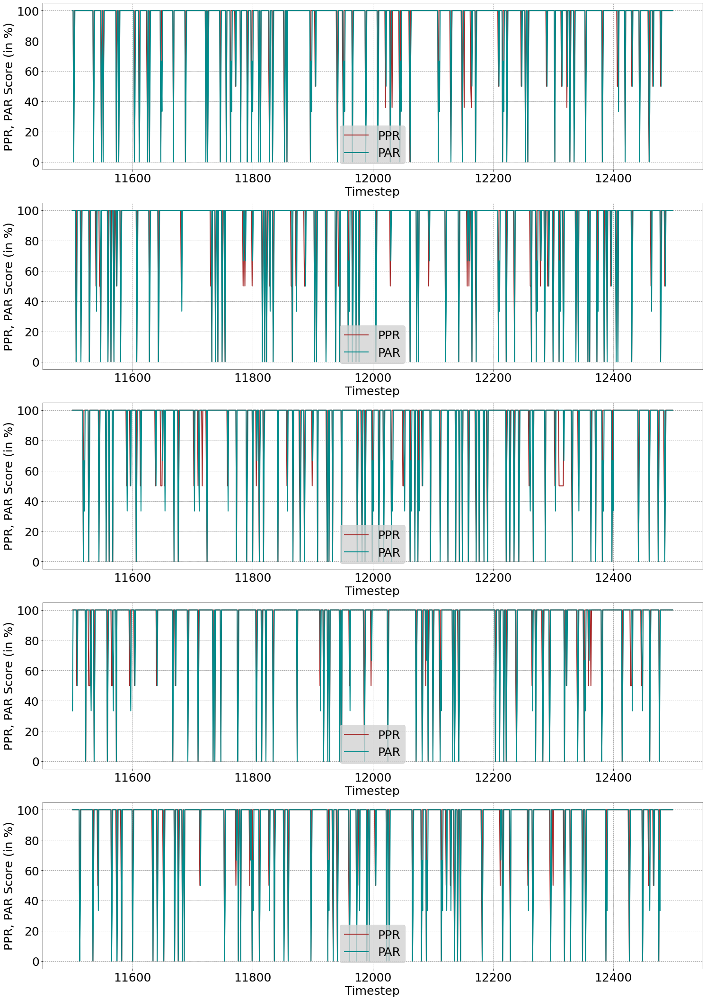

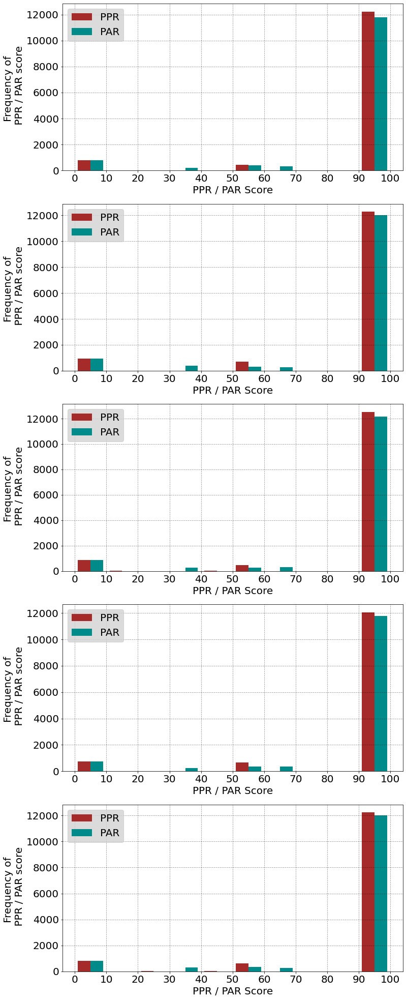

In [7]:
list_pred_acc = []
list_pred_perf = []
list_pred_perf_perString = []
list_MA_pred_acc = []
list_MA_pred_perf = []

for r in range(n_runs):    
    
    results = list_results[r]
    rg_inputoutput = list_rg_inputoutput[r]
    
    pred_acc = []
    pred_perf = []
    pred_perf_perString = []
    MA_pred_acc = []
    MA_pred_perf = []
    for string_idx in range(nof_strings):

        performancePerString = []
        for step in range(len(results.iloc[string_idx]['htm_preds'])):
            
            correct_preds_cols_idx = np.where(rg_inputoutput[string_idx][2][step])[0]
            # Correct expected predictions for the particular <[string_idx][step]> timestep

            predicted_cols_idx = np.unique(np.where(results.iloc[string_idx]['htm_preds'][step])[1])
            # Indices of the cols predicted by the network for particular <[string_idx][step]> timestep.

            count=0
            for col_idx in correct_preds_cols_idx:
                if col_idx in predicted_cols_idx:
                    count+=1

            if len(predicted_cols_idx) == 0:
                accuracy = 0.0
            else:
                accuracy = (count/len(predicted_cols_idx))*100

            performance = (count/len(correct_preds_cols_idx))*100

            pred_acc.append((accuracy, (string_idx, step)))
            pred_perf.append((performance, (string_idx, step)))
            performancePerString.append(performance)

        pred_perf_perString.append(np.mean(performancePerString))

    i = 0
    while i+100 < len(pred_perf):
        MA_pred_acc.append(np.mean([acc_[0] for acc_ in pred_acc[i:i+100]]))
        MA_pred_perf.append(np.mean([perf_[0] for perf_ in pred_perf[i:i+100]]))
        i+=1
    
    list_pred_acc.append(pred_acc)
    list_pred_perf.append(pred_perf)
    list_pred_perf_perString.append(pred_perf_perString)
    list_MA_pred_acc.append(MA_pred_acc)    
    list_MA_pred_perf.append(MA_pred_perf)    
    
    #____________________________PPR and PAR PLOTS_________________________________________
    plt.figure(1, figsize=(25, 7.5*n_runs))
    plt.subplot(n_runs,1,r+1)
    plt.plot(list(np.arange(11500, 12500)), [perf_[0] for perf_ in pred_perf][11500:12500], label='PPR', color='brown', lw=2)
    plt.plot(list(np.arange(11500, 12500)), [acc_[0] for acc_ in pred_acc][11500:12500], label='PAR', color='darkcyan', lw=2)
    plt.ylabel('PPR, PAR Score (in %)', fontsize=25)
    plt.yticks(fontsize=25)
    plt.xlabel('Timestep', fontsize=25)
    plt.xticks(fontsize=25)
    plt.legend(loc='lower center', facecolor='lightgrey', fontsize=25)
    plt.grid(True, linestyle="--", color='black', alpha=0.4)
    #plt.title(f'Mean prediction accuracy (in %): {np.mean([pred_[0] for pred_ in pred_acc])}')

    #_____________Frequency bar_________________
    plt.figure(2, figsize=(12, 7*n_runs))
    plt.subplot(n_runs,1,r+1)
    plt.hist([[perf_[0] for perf_ in pred_perf],[acc_[0] for acc_ in pred_acc]], bins=np.arange(0,110,10),
             color=['brown', 'darkcyan'], label=['PPR', 'PAR'])
    plt.ylabel('Frequency of \n PPR / PAR score', fontsize=20)
    plt.yticks(fontsize=20)
    plt.xlabel('PPR / PAR Score', fontsize=20)
    plt.xticks(np.arange(0,110,10), fontsize=20)
    plt.legend(loc='upper left', facecolor='lightgrey', fontsize=20)
    plt.grid(True, linestyle="--", color='black', alpha=0.4)

    #____________________________P3S PLOTS________________________________________________
#     plt.figure(3, figsize=(25, 7.5*n_runs))
#     plt.subplot(n_runs,1,r+1)
#     plt.plot(pred_perf_perString, label='P3S', color='darkgreen', lw=2)
#     plt.ylabel('P3S Score (in %)', fontsize=25)
#     plt.yticks(fontsize=25)
#     plt.xlabel('String Index', fontsize=25)
#     plt.xticks(fontsize=25)
#     plt.grid(True, linestyle="--", color='black', alpha=0.4)
    
    #_____________Frequency bar_________________
#     plt.figure(4, figsize=(10, 5*n_runs))
#     plt.subplot(n_runs,1,r+1)
#     plt.hist(pred_perf_perString, color='darkgreen')
#     plt.ylabel('Frequency of P3S', fontsize=15)
#     plt.yticks(fontsize=15)
#     plt.xlabel('P3S', fontsize=15)
#     plt.xticks(fontsize=15)

plt.show()
plt.close()
    
#     print('Mean PAR: ', np.mean([acc_[0] for acc_ in pred_acc]))
#     print('Mean PPR: ', np.mean([perf_[0] for perf_ in pred_perf]))

    # count_PAR = collections.Counter([acc_[0] for acc_ in pred_acc])
    # count_PPR = collections.Counter([perf_[0] for perf_ in pred_perf])

    # print('\n\nPAR Frequencies: ')
    # for key in sorted(dict(count_PAR).keys()):
    #     print(key,':: ', dict(count_PAR)[key])

    # print('\n\nPPR Frequencies: ')
    # for key in sorted(dict(count_PPR).keys()):
    #     print(key,':: ', dict(count_PPR)[key])        

### Plotting P3S and MAs of PPR, PAR scores with Mean and SD

In [8]:
shortest_inputstream = np.min([len(MA_) for MA_ in list_MA_pred_perf])
[len(MA_) for MA_ in list_MA_pred_perf]

[13408, 13790, 13744, 13342, 13642]

In [225]:
%matplotlib inline

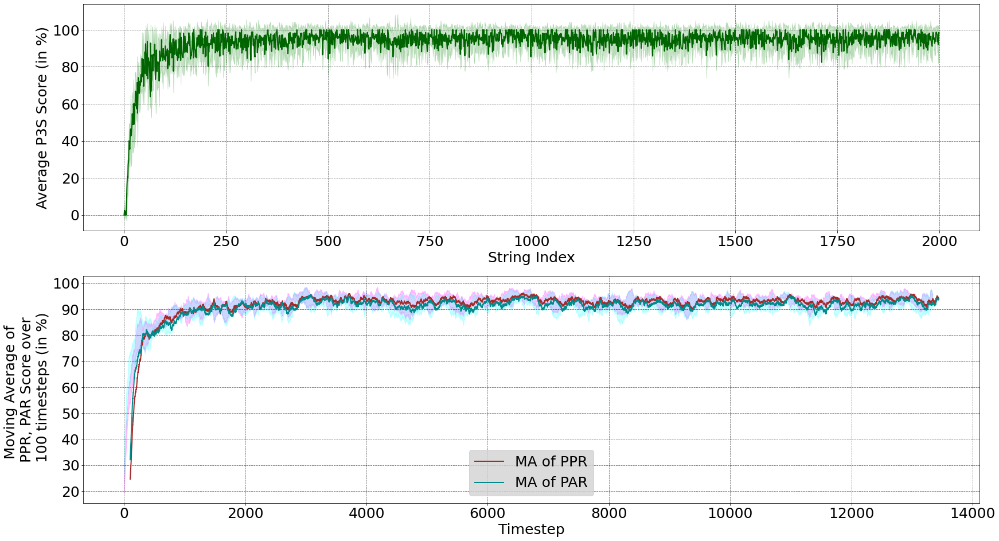

In [10]:
avg_p3s = []
sd_p3s = []
for st_ in range(nof_strings):
    avg_p3s.append(np.mean([list_pred_perf_perString[r][st_] for r in range(n_runs)]))
    sd_p3s.append(np.std([list_pred_perf_perString[r][st_] for r in range(n_runs)]))
    
avg_p3s = np.array(avg_p3s)
sd_p3s = np.array(sd_p3s)
    
avg_MAppr=[]
sd_MAppr=[]
avg_MApar=[]
sd_MApar=[]
for step in range(shortest_inputstream):
    avg_MAppr.append(np.mean([list_MA_pred_perf[r][step] for r in range(n_runs)]))
    sd_MAppr.append(np.std([list_MA_pred_perf[r][step] for r in range(n_runs)]))
    
    avg_MApar.append(np.mean([list_MA_pred_acc[r][step] for r in range(n_runs)]))
    sd_MApar.append(np.std([list_MA_pred_acc[r][step] for r in range(n_runs)]))

avg_MAppr = np.array(avg_MAppr)
sd_MAppr = np.array(sd_MAppr)
avg_MApar = np.array(avg_MApar)
sd_MApar = np.array(sd_MApar)
    
# PLOTTING THE AVERAGE P3S SCORE
plt.figure(5, figsize=(28, 8*2))
plt.subplot(2,1,1)
plt.plot(avg_p3s, label='P3S', color='darkgreen', lw=2)
plt.fill_between([i for i in range(nof_strings)], avg_p3s-sd_p3s, avg_p3s+sd_p3s, color='green', alpha=0.2)
plt.ylabel('Average P3S Score (in %)', fontsize=25)
plt.yticks(fontsize=25)
plt.xlabel('String Index', fontsize=25)
plt.xticks(fontsize=25)
plt.grid(True, linestyle="--", color='black', alpha=0.6)

# PLOTTING THE AVERAGE MAs OF PAR AND PPR SCORES
plt.subplot(2,1,2)
plt.plot(np.arange(100, shortest_inputstream+100), avg_MAppr, label='MA of PPR', color='brown', lw=2)
plt.fill_between([i for i in range(shortest_inputstream)], avg_MAppr-sd_MAppr, avg_MAppr+sd_MAppr, color='magenta', alpha=0.2)
plt.plot(np.arange(100, shortest_inputstream+100), avg_MApar, label='MA of PAR', color='darkcyan', lw=2)
plt.fill_between([i for i in range(shortest_inputstream)], avg_MApar-sd_MApar, avg_MApar+sd_MApar, color='cyan', alpha=0.2)
plt.ylabel('Moving Average of \n PPR, PAR Score over \n 100 timesteps (in %)', fontsize=25)
plt.yticks(fontsize=25)
plt.xlabel('Timestep', fontsize=25)
plt.xticks(fontsize=25)
plt.legend(loc='lower center', facecolor='lightgrey', fontsize=25)
plt.grid(True, linestyle="--", color='black', alpha=0.6)

plt.show()
plt.close()

In [12]:
display(np.mean(avg_p3s[1800:]))
display(np.mean(avg_MApar[12000:]))

95.44410698014522

92.43648782911077

### Plotting String Length distribution

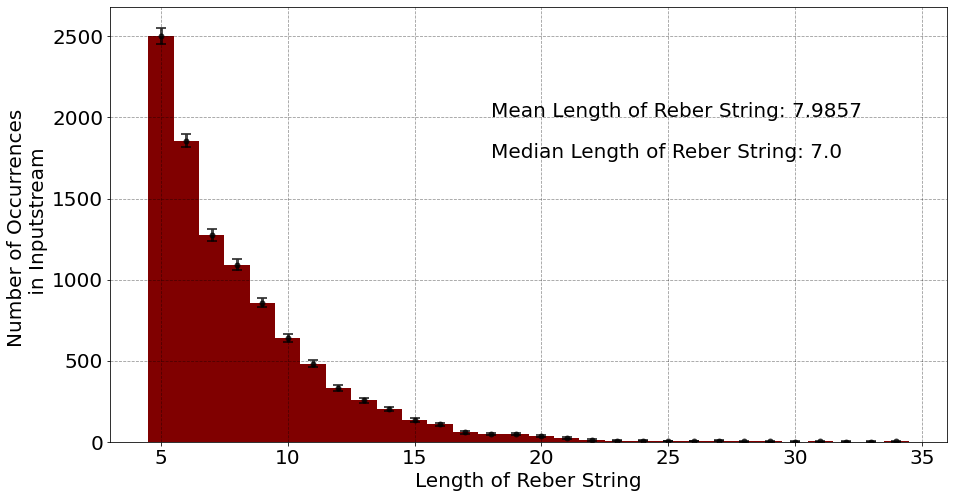

In [8]:
len_rg_examples = []
for r in range(n_runs):
    len_rg_examples += in_strings_stats[r]['len_rg_exs']
    
y,binEdges = np.histogram(len_rg_examples,bins=np.unique(len_rg_examples))

plt.figure(figsize=(15,8))
plt.bar(binEdges[:-1], y, width=1, color='maroon')
plt.errorbar(binEdges[:-1], y, yerr=np.sqrt(y), fmt='o', color='Black', elinewidth=3,capthick=2, alpha=0.7, markersize=5, capsize=5)
plt.ylabel('Number of Occurrences \n in Inputstream', fontsize=20)
plt.xlabel('Length of Reber String', fontsize=20)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.text(x=binEdges[-1]/2, y=0.8*y[0], s=f'Mean Length of Reber String: {np.mean(len_rg_examples)}', fontsize=20)
plt.text(x=binEdges[-1]/2, y=0.7*y[0], s=f'Median Length of Reber String: {np.median(len_rg_examples)}', fontsize=20)
plt.grid(True, linestyle="--", color='black', alpha=0.4)
plt.show()
plt.close()


# len_rg_examples = []
# for r in range(n_runs):
#     len_rg_examples += in_strings_stats[r]['len_rg_exs']
    
# y,binEdges = np.histogram(len_rg_examples,bins=15)
# plt.figure(figsize=(15,8))
# #plt.bar(0.05*(binEdges[1:]+binEdges[:-1]), y, width=0.1, color='green', yerr=np.sqrt(y))
# plt.bar(binEdges[:-1], y, width=1, color='maroon')
# plt.errorbar(binEdges[:-1], y, yerr=np.sqrt(y), fmt='o', color='Black', elinewidth=3,capthick=2, alpha=0.7, markersize=5, capsize=5)
# plt.ylabel('Number of Occurrences \n in Inputstream', fontsize=20)
# plt.xlabel('Length of Reber String', fontsize=20)
# plt.xticks(fontsize=20)
# plt.yticks(fontsize=20)
# plt.text(x=15, y=3500, s=f'Mean Length of Reber String: {np.mean(len_rg_examples)}', fontsize=20)
# plt.text(x=14.35, y=3180, s=f'Median Length of Reber String: {np.median(len_rg_examples)}', fontsize=20)
# plt.grid(True, linestyle="--", color='black', alpha=0.4)
# plt.show()
# plt.close()

In [19]:
np.unique([in_strings_stats[r]['total_len_inputstream'] for r in range(n_runs)])

array([15854, 15884, 15978, 16005, 16136])

In [26]:
# Printing all input reber strings for trial 1
for i, string in enumerate(in_strings_stats[2]['in_strings_alpha']):
    print(i, string)

0 APVPXVSPVZ
1 APSXZ
2 ATSSSSSPVZ
3 APSTXZ
4 APSTXZ
5 ATSPXSXZ
6 ATPVZ
7 ATPXVSPXVPVZ
8 ATSPXVSPXSXZ
9 ATPXVPXVSPVZ
10 APSTTXZ
11 APSXZ
12 APVPVZ
13 APSXZ
14 ATPVZ
15 ATSPVZ
16 ATPXSTTXZ
17 ATPVZ
18 APSXZ
19 ATPXVSSSSPVZ
20 ATPVZ
21 ATSSPXSTXZ
22 ATPVZ
23 APVSSSSSPXSTXZ
24 APVSSSPXSTXZ
25 APSTTTXZ
26 APSXZ
27 ATPXSTXZ
28 ATSSPXVSSPVZ
29 ATSSSPVZ
30 APSXZ
31 APSTTXZ
32 ATPXVSPXSXZ
33 APSTXZ
34 ATPXSTTTTTTTXZ
35 ATSPVZ
36 ATPXSTXZ
37 ATPXVPVZ
38 APSXZ
39 ATSSSSPVZ
40 APVSSSPVZ
41 ATPXVSPXVSSPXSXZ
42 ATPXSTTTTXZ
43 ATSSSSPXVSPXSTXZ
44 ATSPVZ
45 APSXZ
46 ATPXVPVZ
47 ATPXVPXSTTXZ
48 ATPXVPXVPVZ
49 APSXZ
50 ATSPXVSSSPXVPVZ
51 APSTXZ
52 ATSPVZ
53 APSTXZ
54 APSTXZ
55 APVSPXVPXVPVZ
56 APVSPXVSPXSTTXZ
57 APSTXZ
58 ATSPXSXZ
59 ATSPXVSPVZ
60 ATPXVSPVZ
61 ATSSPVZ
62 ATSPXVSPVZ
63 ATSSPVZ
64 APVSSSPXVPVZ
65 APSTXZ
66 APVPVZ
67 APVPVZ
68 APVPXSTXZ
69 APSXZ
70 APVPVZ
71 APVPXSXZ
72 APSXZ
73 APVSSSSSPVZ
74 APSTTTTTXZ
75 ATSSSPVZ
76 ATSPVZ
77 ATPVZ
78 ATSSPVZ
79 ATSPVZ
80 ATPVZ
81 APSXZ
82 ATSPVZ
83 APV

1596 APVPVZ
1597 APSTTTTXZ
1598 ATSSPVZ
1599 ATSPVZ
1600 ATPXSXZ
1601 APSTXZ
1602 APVPXVPVZ
1603 ATPVZ
1604 ATSSSPXSXZ
1605 APSXZ
1606 APSTXZ
1607 ATPVZ
1608 APVSSPXSXZ
1609 ATSPVZ
1610 APVSSPVZ
1611 APVPXVSPVZ
1612 ATSSSSPXSTXZ
1613 APVSPXVSSSPXVPVZ
1614 ATPVZ
1615 APVSSSSSSSSPXSXZ
1616 ATSPVZ
1617 APVPXSXZ
1618 ATSSPXSXZ
1619 ATPXVSPVZ
1620 ATPXSTTTXZ
1621 ATPVZ
1622 ATPXVSSPVZ
1623 APVSPXVPVZ
1624 APSTTTXZ
1625 ATSSPVZ
1626 ATSPXSTTTXZ
1627 ATSPXVPVZ
1628 ATPXSTXZ
1629 APSTXZ
1630 ATSSSSPXVPXVPXSXZ
1631 ATPXSTXZ
1632 ATSSPVZ
1633 APVSPXSTTTXZ
1634 APSXZ
1635 ATSSPVZ
1636 ATPVZ
1637 APSTXZ
1638 ATPVZ
1639 ATPXVSSSSPXSXZ
1640 APVPXSTXZ
1641 ATPVZ
1642 APVPXVPXSXZ
1643 ATPXSTXZ
1644 ATPXVPVZ
1645 APSTTXZ
1646 ATPXSTXZ
1647 APSXZ
1648 ATSPXVSPVZ
1649 APVPVZ
1650 APVSSSPXSXZ
1651 ATSPXVSSPXVPXVPVZ
1652 ATPXSXZ
1653 APVSSPXSTXZ
1654 APSXZ
1655 APSXZ
1656 APVSSPXSTXZ
1657 APVSSSSPXVSSSSPXVPVZ
1658 APVSPVZ
1659 ATSPVZ
1660 ATPVZ
1661 APSTTTXZ
1662 ATSPXVPXVSSPVZ
1663 ATSPVZ
1664 ATSPXVPVZ
1

In [55]:
# Printing all input reber strings for trial 1
for i, string in enumerate(in_strings_stats[1]['in_strings_alpha']):
    if string == 'ATPXVPXVSPVZ':
        print(i, string)

1959 ATPXVPXVSPVZ


In [53]:
list_pred_perf[2][6000:]
# 1920, 1926
# 1898

[(100.0, (895, 3)),
 (100.0, (895, 4)),
 (100.0, (895, 5)),
 (100.0, (895, 6)),
 (100.0, (896, 0)),
 (100.0, (896, 1)),
 (100.0, (896, 2)),
 (100.0, (896, 3)),
 (50.0, (896, 4)),
 (0.0, (896, 5)),
 (100.0, (896, 6)),
 (100.0, (896, 7)),
 (50.0, (896, 8)),
 (100.0, (896, 9)),
 (100.0, (897, 0)),
 (100.0, (897, 1)),
 (100.0, (897, 2)),
 (100.0, (897, 3)),
 (50.0, (897, 4)),
 (100.0, (897, 5)),
 (100.0, (898, 0)),
 (100.0, (898, 1)),
 (100.0, (898, 2)),
 (100.0, (898, 3)),
 (100.0, (898, 4)),
 (100.0, (898, 5)),
 (100.0, (899, 0)),
 (100.0, (899, 1)),
 (100.0, (899, 2)),
 (100.0, (899, 3)),
 (100.0, (899, 4)),
 (100.0, (899, 5)),
 (100.0, (900, 0)),
 (100.0, (900, 1)),
 (100.0, (900, 2)),
 (100.0, (900, 3)),
 (50.0, (900, 4)),
 (0.0, (900, 5)),
 (100.0, (900, 6)),
 (100.0, (901, 0)),
 (100.0, (901, 1)),
 (100.0, (901, 2)),
 (100.0, (901, 3)),
 (100.0, (902, 0)),
 (100.0, (902, 1)),
 (100.0, (902, 2)),
 (100.0, (902, 3)),
 (100.0, (903, 0)),
 (100.0, (903, 1)),
 (100.0, (903, 2)),
 (100.0,

In [201]:
results.iloc[999].name

'ATPXVPXSXZ'

In [ ]:
np.where(results.index == results.iloc[1664].name)

## HTM States / Activity

In [32]:
%matplotlib notebook

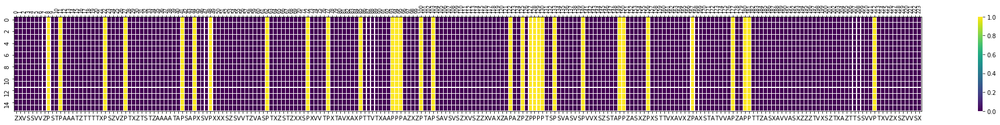

In [34]:
string_idx = 0
step = 0

f = plt.figure(figsize=(28,4))
f = sns.heatmap(results.iloc[string_idx]['htm_states'][step], linewidth=0.1, cmap='viridis', vmax=1, vmin=0, cbar=False, xticklabels=xticks_plot)
# ax_ = plt.twiny()
# ax_.set_xticks(f.get_xticks())
# ax_.set_xbound(f.get_xbound())
# ax_.set_xticklabels([str(i) for i in np.arange(N)], rotation=90, fontsize=8)
# ax_.tick_params(grid_alpha=0)
plt.show()

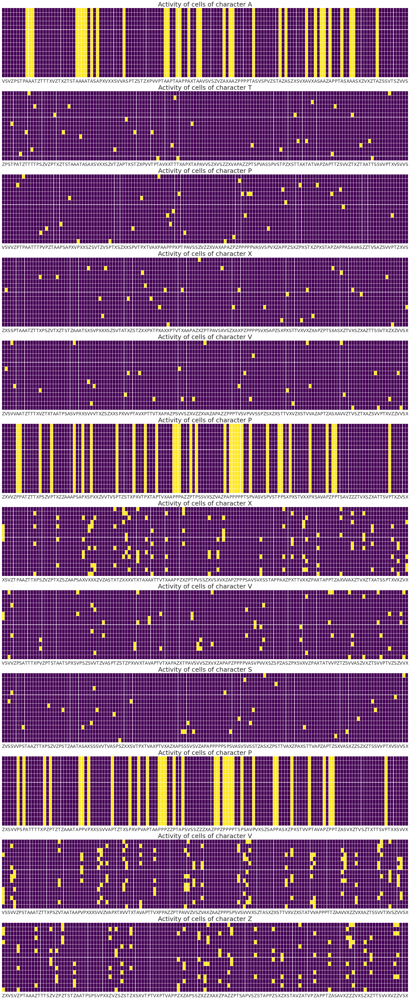

In [56]:
string_idx = 1959
r = 1

res_ = list_results[r]
sns.set_style("whitegrid")
res_string = res_.iloc[string_idx]
string_len = len(res_string.name)
fig, axes = plt.subplots(string_len,1, figsize=(29,6*string_len))
all_cols = [c for c in range(N)]

for step in range(string_len):
    char = res_string.name[step]
    inactive_cols = [col for col in all_cols if res_string['htm_states'][step][:, col].any()==False]
    deleted_cols = random.choices(inactive_cols, k=int(len(inactive_cols)/1.8))
    undeleted_cols = set(all_cols) - set(deleted_cols)
    
    # Plot the current step's character's (cell) activity
    sns.heatmap(res_string['htm_states'][step][:, list(undeleted_cols)], vmax=1, vmin=0, cbar=False, linewidth=0.1, cmap='viridis', 
                xticklabels=xticks_plot[list(undeleted_cols)], ax=axes[step])
    axes[step].set_xticklabels(axes[step].get_xticklabels(), fontsize=17)
    axes[step].set_yticklabels([])
    axes[step].set_title(f'Activity of cells of character {char}', fontsize=25)

#plt.tight_layout()
plt.show()
#plt.close()

## HTM Predictions

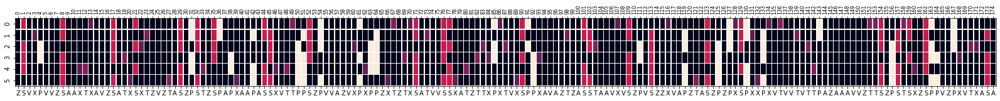

In [19]:
string_idx = 49
step = 0

predicted_chars = np.unique([charsMC.columns[np.where(charsMC == idx)[1]][0] 
                  for idx in np.where(results.iloc[string_idx]['htm_preds'][step])[1]])
multiplying_arr = np.zeros(N)
for k in range(len(predicted_chars)):
    multiplying_arr[list(charsMC[predicted_chars[k]])] = 1/(k+1)

plot_predictions=[results.iloc[string_idx]['htm_preds'][step][j]*multiplying_arr
                  for j in range(M)]

f = plt.figure(figsize=(28,4))
f = sns.heatmap(plot_predictions, vmax=1, vmin=0, cbar=False, linewidth=0.1, xticklabels=xticks_plot)
plt.show()

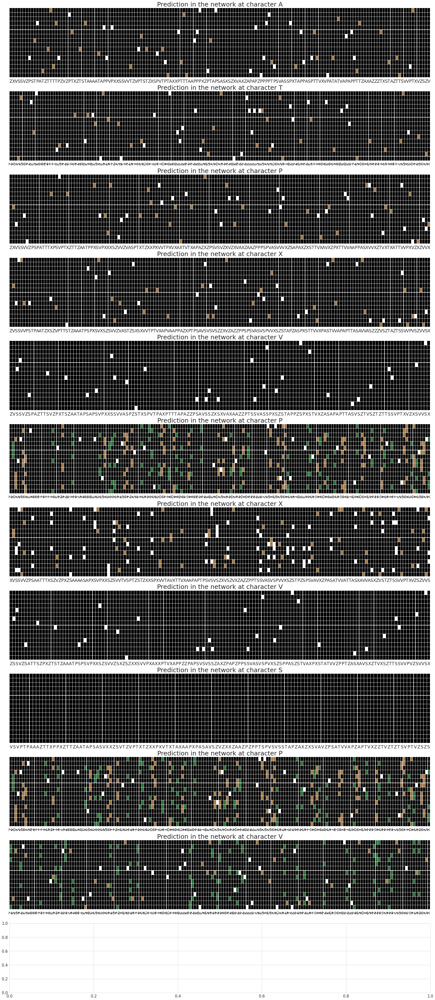

In [57]:
string_idx = 1959
r = 1

res_ = list_results[r]
sns.set_style("whitegrid")
res_string = res_.iloc[string_idx]
string_len = len(res_string.name)
fig, axes = plt.subplots(string_len,1, figsize=(30,6*string_len))
all_cols = [c for c in range(N)]

for step in range(string_len-1):
    char = res_string.name[step]

    predicted_chars = np.unique([charsMC.columns[np.where(charsMC == idx)[1]][0] for idx in np.where(res_string['htm_preds'][step])[1]])
    multiplying_arr = np.zeros(N)
    for k in range(len(predicted_chars)):
        multiplying_arr[list(charsMC[predicted_chars[k]])] = 1/(k+1)

    plot_predictions=np.array([res_string['htm_preds'][step][j]*multiplying_arr for j in range(M)])
    
    unpredicted_cols = [col for col in all_cols if plot_predictions[:, col].any()==False]
    deleted_cols = random.choices(unpredicted_cols, k=int(len(unpredicted_cols)/1.8))
    undeleted_cols = set(all_cols) - set(deleted_cols)
    
    
    # Plot the current step's character's (cell) predictivity
    sns.heatmap(plot_predictions[:, list(undeleted_cols)], cmap='cubehelix',
                vmax=1, vmin=0, cbar=False, linewidth=0.1, xticklabels=xticks_plot[list(undeleted_cols)], ax=axes[step])
#     sns.heatmap(plot_predictions, 
#                 vmax=1, vmin=0, cbar=False, linewidth=0.1, xticklabels=xticks_plot, ax=axes[step])
    
    axes[step].set_xticklabels(axes[step].get_xticklabels(), fontsize=17)
    axes[step].set_yticklabels([])
    axes[step].set_title(f'Prediction in the network at character {char}', fontsize=25)

plt.show()
#plt.close()

## Number of Dendrites on each Cell

In [20]:
%matplotlib notebook

<IPython.core.display.Javascript object>


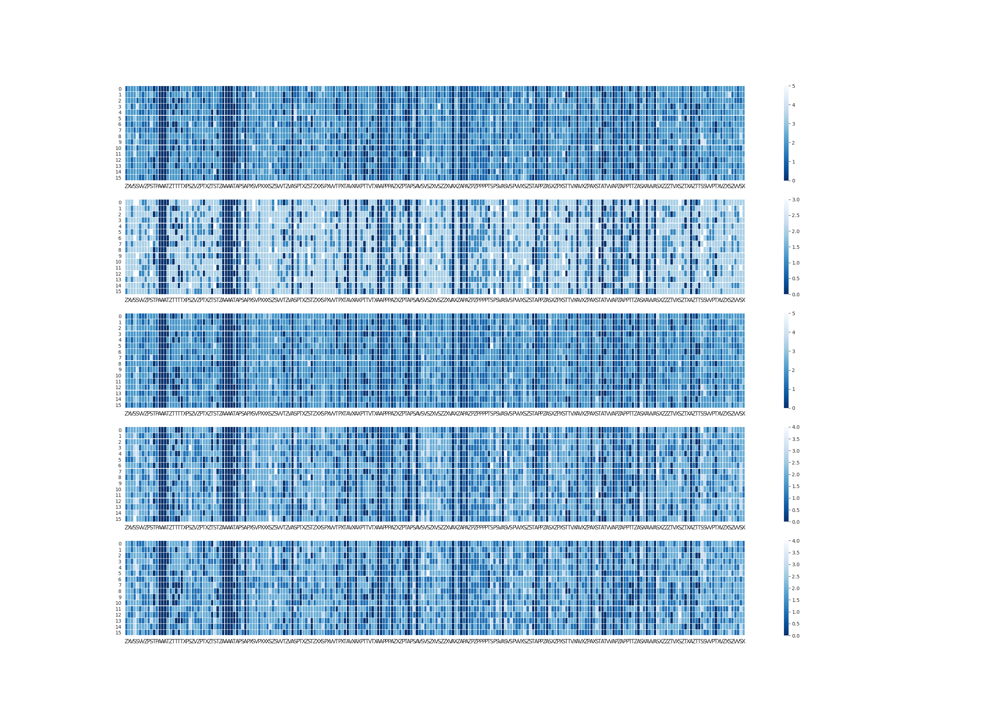

array([2., 2., 1., 2., 1., 1., 1., 2., 2., 2., 2., 1., 0., 0., 0., 2., 2.,
       2., 2., 2., 1., 2., 1., 3., 2., 2., 1., 1., 0., 2., 1., 0., 3., 2.,
       1., 0., 0., 0., 0., 0., 0., 1., 3., 0., 1., 2., 2., 2., 1., 1., 2.,
       2., 1., 2., 2., 1., 1., 2., 1., 1., 0., 2., 1., 2., 2., 2., 3., 1.,
       2., 2., 2., 2., 2., 2., 1., 1., 2., 1., 2., 0., 0., 2., 2., 0., 2.,
       2., 2., 2., 1., 2., 2., 0., 0., 1., 1., 1., 0., 1., 2., 1., 1., 0.,
       0., 1., 2., 0., 2., 2., 2., 3., 1., 2., 2., 1., 2., 1., 2., 2., 0.,
       2., 1., 0., 1., 0., 1., 2., 2., 1., 1., 2., 2., 2., 2., 1., 1., 2.,
       0., 2., 1., 2., 1., 2., 2., 2., 2., 1., 2., 2., 0., 1., 1., 2., 0.,
       2., 2., 1., 1., 2., 2., 1., 0., 1., 2., 0., 2., 2., 1., 2., 0., 2.,
       2., 0., 0., 2., 2., 1., 0., 1., 2., 0., 1., 1., 0., 2., 1., 0., 2.,
       2., 0., 2., 2., 0., 2., 1., 1., 2., 2., 2., 1., 2., 2., 2., 0., 2.,
       0., 2., 1., 1., 3., 2., 1., 1., 2., 2., 2., 2., 1., 2., 3., 2., 2.,
       1., 2., 1.])

4.0

In [195]:
fig, axes = plt.subplots(n_runs,1, figsize=(28,4*n_runs))

for r in range(n_runs):
    r_network = list_results[r].iloc[1999]['htm_network']
    countDendrites = np.zeros(shape=[M,N])
    
    for i in range(M):
        for j in range(N):
            countDendrites[i,j] = r_network[i, j].get_cell_numDendrites()

    sns.heatmap(countDendrites, linewidth=0.1, xticklabels=xticks_plot, ax=axes[r], cmap='Blues_r', cbar=True)
    axes[r].set_xticklabels(axes[r].get_xticklabels(), fontsize=11, rotation=0)
    #axes[0].set_yticklabels([])

#     sns.heatmap(countDendrites[:, 0:int(N/2)], linewidth=0.1, xticklabels=xticks_plot[0:int(N/2)], ax=axes[r], cmap='Blues_r', cbar=True)
#     axes[r].set_xticklabels(axes[r].get_xticklabels(), fontsize=11, rotation=0)
#     #axes[0].set_yticklabels([])

#     sns.heatmap(countDendrites[:, int(N/2):], linewidth=0.1, xticklabels=xticks_plot[int(N/2):], ax=axes[r], cmap='Blues_r', cbar=True)
#     axes[r].set_xticklabels(axes[r].get_xticklabels(), fontsize=11, rotation=0)
#     #axes[1].set_yticklabels([])

plt.show()

display(countDendrites[0])
display(np.amax(countDendrites))

# supported values are 'Accent', 'Accent_r', 'Blues', **'Blues_r', 'BrBG', 'BrBG_r', 'BuGn', 'BuGn_r', 'BuPu', 'BuPu_r', 'CMRmap', 'CMRmap_r', 'Dark2', 
#'Dark2_r', 'GnBu', 'GnBu_r', 'Greens', 'Greens_r', 'Greys', 'Greys_r', 'OrRd', 'OrRd_r', 'Oranges', 'Oranges_r', 'PRGn', 'PRGn_r', 'Paired', 'Paired_r', 
# 'Pastel1', 'Pastel1_r', 'Pastel2', 'Pastel2_r', 'PiYG', 'PiYG_r', 'PuBu', 'PuBuGn', 'PuBuGn_r', 'PuBu_r', ***'PuOr', 'PuOr_r', 'PuRd', 'PuRd_r', 
# 'Purples', 'Purples_r', 'RdBu', 'RdBu_r', 'RdGy', 'RdGy_r', 'RdPu', 'RdPu_r', 'RdYlBu', 'RdYlBu_r', 'RdYlGn', 'RdYlGn_r', 'Reds', 'Reds_r', 'Set1', 
# 'Set1_r', 'Set2', 'Set2_r', 'Set3', 'Set3_r', 'Spectral', 'Spectral_r', 'Wistia', 'Wistia_r', 'YlGn', 'YlGnBu', 'YlGnBu_r', 'YlGn_r', 'YlOrBr', 
# 'YlOrBr_r', 'YlOrRd', 'YlOrRd_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'bwr_r', 
# 'cividis', 'cividis_r', 'cool', 'cool_r', 'coolwarm', 'coolwarm_r', 'copper', 'copper_r', 'crest', 'crest_r', 'cubehelix', 'cubehelix_r', 'flag', 'flag_r', 
# 'flare', 'flare_r', 'gist_earth', 'gist_earth_r', 'gist_gray', 'gist_gray_r', 'gist_heat', 'gist_heat_r', 'gist_ncar', 'gist_ncar_r', 'gist_rainbow', 
# 'gist_rainbow_r', 'gist_stern', 'gist_stern_r', 'gist_yarg', 'gist_yarg_r', 'gnuplot', 'gnuplot2', 'gnuplot2_r', 'gnuplot_r', 'gray', 'gray_r', 'hot', 
# 'hot_r', 'hsv', 'hsv_r', 'icefire', 'icefire_r', 'inferno', 'inferno_r', 'jet', 'jet_r', 'magma', 'magma_r', 'mako', 'mako_r', 'nipy_spectral', 
# 'nipy_spectral_r', 'ocean', 'ocean_r', 'pink', 'pink_r', 'plasma', 'plasma_r', 'prism', 'prism_r', 'rainbow', 'rainbow_r', 'rocket', 'rocket_r', 'seismic',
# 'seismic_r', 'spring', 'spring_r', 'summer', 'summer_r', 'tab10', 'tab10_r', 'tab20', 'tab20_r', 'tab20b', 'tab20b_r', 'tab20c', 'tab20c_r', 'terrain', 
# 'terrain_r', 'turbo', 'turbo_r', 'twilight', 'twilight_r', 'twilight_shifted', 'twilight_shifted_r', 'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r'


In [337]:
r_ = 4
res_ = list_results[r_]

cell_activity = np.zeros([M,N])
cell_predictivity = np.zeros([M,N])
for string_idx in range(nof_strings):
    cell_activity += sum(res_.iloc[string_idx]['htm_states']) # RHS sums up the net cellular activity 
                                                                 # for each letter of the string.
    cell_predictivity += sum(res_.iloc[string_idx]['htm_preds'])

# Normalizing the net cellular predictivity of each cell
norm_cell_predictivity = (cell_predictivity/in_strings_stats[r]['total_len_inputstream'])*100
# Normalizing the net cellular activity of each cell
norm_cell_activity = (cell_activity/in_strings_stats[r]['total_len_inputstream'])*100

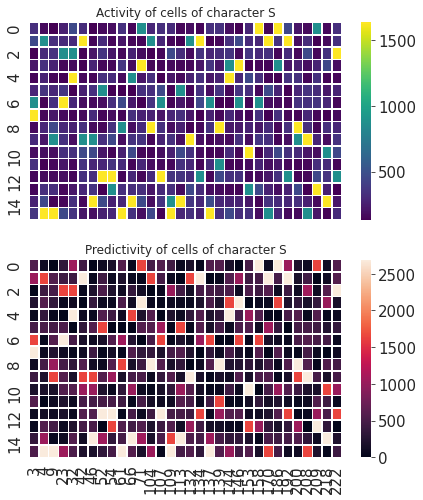

Character-wise Activity: 

 [[ 333.  167.  130.  265.  464.  316.  130.  167.  183.  341.  152.  875.
   294.  333.  312.  155.  183.  150.  333.  341.  183.  130.  294. 1636.
   157. 1636.  457.  217.  167.  875.  164.  333.]
 [ 457.  875.  333.  312.  312. 1636.  152.  312.  159.  215.  155.  150.
   875.  294.  156.  130.  875. 1636.  130.  152.  333.  457.  312.  294.
  1636.  349. 1636.  183.  316.  130.  169.  341.]
 [ 130.  312.  349.  875.  875.  147.  217.  355.  215.  161.  271.  173.
   130.  155.  455.  316.  176.  351.  294.  316.  358.  167.  361.  312.
   341.  159.  312.  161.  467.  159.  341. 1636.]
 [ 224.  341.  267.  155.  167.  130.  274.  157.  157.  361.  167. 1636.
   155.  152.  167.  156.  156.  215.  358.  217.  875. 1636.  130.  156.
   153.  875.  215.  265.  183.  274.  455.  183.]
 [ 149.  271.  152.  130. 1636.  162.  153.  333.  310.  169.  875.  215.
   333.  130.  217.  162.  265.  333.  217.  267. 1636.  294.  457.  333.
   150.  130.  349.  341.  1

In [342]:
char = 'S'

char_activity = cell_activity[:,list(charsMC[char])]
char_predictivity = cell_predictivity[:,list(charsMC[char])]

sns.set_style("whitegrid")
fig, axes = plt.subplots(2,1, sharex=True, figsize=(7,8))

sns.heatmap(char_activity, linewidth=0.5, cmap='viridis', xticklabels=list(charsMC[char]), ax=axes[0])
axes[0].set_title(f'Activity of cells of character {char}')
sns.heatmap(char_predictivity, linewidth=0.5, xticklabels=list(charsMC[char]), ax=axes[1])
axes[1].set_title(f'Predictivity of cells of character {char}')
plt.show()

print('Character-wise Activity: \n\n', char_activity)
print('\n\nCharacter-wise Predictivity: \n\n', char_predictivity)

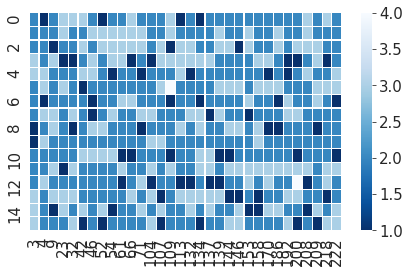

In [343]:
r_ = 4
ch = 'S'

countDendrites = np.zeros(shape=[M,N])
    
for i in range(M):
    for j in range(N):
        countDendrites[i,j] = list_results[r_].iloc[1999]['htm_network'][i, j].get_cell_numDendrites()

plt.figure(figsize=(7,4))
sns.heatmap(countDendrites[:,list(charsMC[ch])], linewidth=0.1, cmap='Blues_r', xticklabels=list(charsMC[ch]))
plt.show()
plt.close()

### Dendrite growth per letter

In [9]:
dendritesPerCharPerRun = pd.DataFrame(columns=list(charsMC.columns)) 

for r in range(n_runs):
    r_network = list_finalnet[r]
    
    avgcount_charwise = []
    
    for ch in list(charsMC.columns):    
        for col in list(charsMC[ch]):
            perColCount = [] # list of k entries
            count_perCol = 0
            for i in range(M):
                count_perCol += r_network[i, col].get_cell_numDendrites()
            perColCount.append(count_perCol)
            
        avgcount_charwise.append(np.mean(perColCount))
            
    dendritesPerCharPerRun.loc[r] = avgcount_charwise

display(dendritesPerCharPerRun)

# dendritesPerChar = {}

# for ch in list(charsMC.columns):
#     avgcount_dendritesPerColPerCharPerRun = [] # list of 'n_runs' entries
#     sdcount_dendritesPerColPerCharPerRun = [] # list of 'n_runs' entries
    
#     for r in range(n_runs):
#         r_network = list_results[r].iloc[1999]['htm_network']    
    
#         for col in list(charsMC[ch]):
#             perColCount = [] # list of k entries
#             count_perCol = 0
#             for i in range(M):
#                 count_perCol += r_network[i, col].get_cell_numDendrites()
#             perColCount.append(count_perCol)
            
#         avgcount_dendritesPerColPerCharPerRun.append(np.mean(perColCount))
#         sdcount_dendritesPerColPerCharPerRun.append(np.std(perColCount))
            
#     dendritesPerChar[ch] = (avgcount_dendritesPerColPerCharPerRun, sdcount_dendritesPerColPerCharPerRun)

,A,T,S,X,P,V,Z
0,0.0,7.0,12.0,11.0,8.0,11.0,8.0
1,0.0,5.0,11.0,10.0,7.0,8.0,8.0
2,0.0,6.0,14.0,11.0,9.0,10.0,8.0
3,0.0,8.0,12.0,8.0,8.0,9.0,7.0
4,0.0,10.0,9.0,10.0,8.0,9.0,10.0


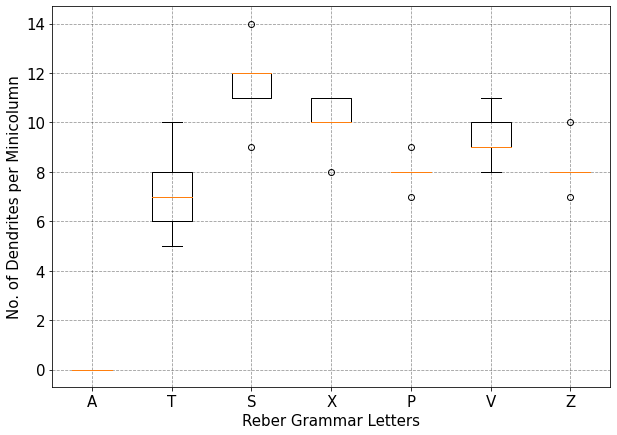

In [12]:
from matplotlib import rcParams
plt.figure(figsize=(10,7))
plt.boxplot(np.array(dendritesPerCharPerRun), labels=list(charsMC.columns))
#plt.set_xticklabels(f.get_xticklabels(), fontsize=17)
rcParams['xtick.labelsize'] = 15
rcParams['ytick.labelsize'] = 15
plt.xlabel('Reber Grammar Letters', fontsize=15)
plt.ylabel('No. of Dendrites per Minicolumn', fontsize=15)
plt.grid(True, linestyle="--", color='black', alpha=0.4)
plt.show()
plt.close()

# relate this figure with trigrams count; and bias in the network for some trigrams over others

### Dendrite Growth with time

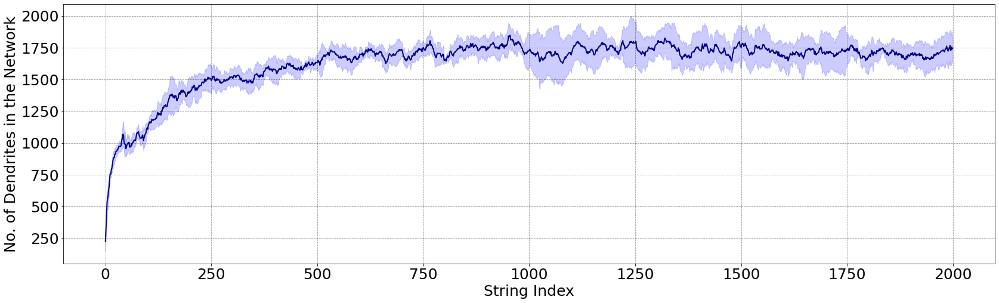

In [11]:
avg_nofDendrites_perStep = []
sd_nofDendrites_perStep = []
for st_ in range(nof_strings):
    avg_nofDendrites_perStep.append(np.mean([list(list_results[r]['nof_dendrites'])[st_] for r in range(n_runs)]))
    sd_nofDendrites_perStep.append(np.std([list(list_results[r]['nof_dendrites'])[st_] for r in range(n_runs)]))
    
avg_nofDendrites_perStep = np.array(avg_nofDendrites_perStep)
sd_nofDendrites_perStep = np.array(sd_nofDendrites_perStep)
        
# PLOTTING THE AVERAGE NUMBER OF DENDRITES
plt.figure(figsize=(28, 8))
plt.plot(avg_nofDendrites_perStep, color='darkblue', lw=2)
plt.fill_between([i for i in range(nof_strings)], avg_nofDendrites_perStep-sd_nofDendrites_perStep, avg_nofDendrites_perStep+sd_nofDendrites_perStep, 
                 color='blue', alpha=0.2)
plt.ylabel('No. of Dendrites in the Network', fontsize=25)
plt.yticks(fontsize=25)
plt.xlabel('String Index', fontsize=25)
plt.xticks(fontsize=25)
plt.grid(True, linestyle="--", color='black', alpha=0.4)
plt.show()
plt.close()

2000
2000
2000
2000
2000


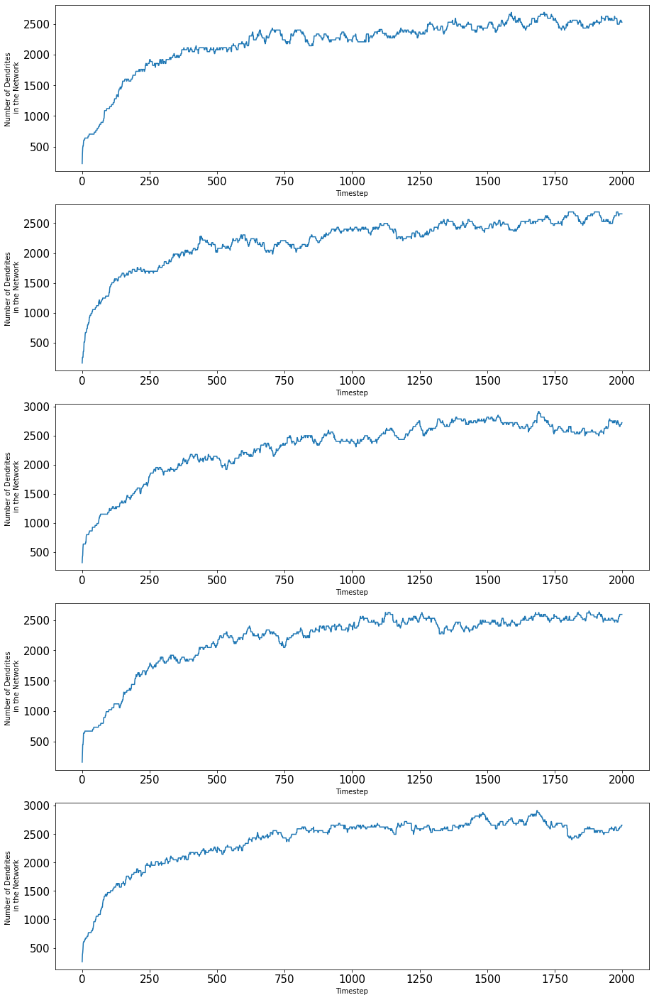

In [47]:
for r in range(n_runs):
    res_ = list_results[r]
    #print(res_.iloc[0].name, res_.iloc[0]['nof_dendrites'])
    plt.figure(100, figsize=(15, 5*n_runs))
    plt.subplot(n_runs, 1, r+1)
    plt.plot(list(res_['nof_dendrites']))
    plt.ylabel('Number of Dendrites \n in the Network')
    plt.xlabel('Timestep')
    #plt.title(f'on accuracy (in %): {np.mean([pred_[0] for pred_ in pred_acc])}')

plt.show()
plt.close()

### Synapse Count

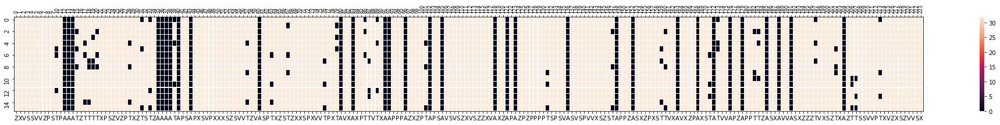

array([32., 32., 32., 32., 32., 32., 32., 32., 32., 32., 32., 32.,  0.,
        0.,  0., 32., 32., 32., 32., 32., 32., 32., 32., 32., 32., 32.,
       32., 32., 32., 32., 32.,  0., 32.,  0., 32.,  0.,  0.,  0.,  0.,
        0.,  0., 32., 32.,  0., 32., 32., 32., 32., 32., 32., 32., 32.,
       32., 32., 32., 32., 32., 32., 32., 32.,  0., 32., 32., 32., 32.,
       32., 32., 32., 32., 32., 32., 32., 32., 32., 32., 32., 32., 32.,
       32., 32.,  0., 32., 32.,  0., 32., 32.,  0., 32., 32.,  0., 32.,
        0.,  0., 32., 32., 32.,  0., 32., 32., 32., 32., 32.,  0., 32.,
       32.,  0., 32., 32., 32., 32., 32., 32., 32., 32., 32., 32., 32.,
       32.,  0., 32., 32.,  0., 32.,  0., 32., 32., 32., 32., 32., 32.,
       32., 32., 32., 32., 32., 32.,  0., 32., 32., 32., 32., 32., 32.,
       32., 32., 32., 32., 32.,  0., 32., 32., 32.,  0., 32., 32., 32.,
       32., 32., 32., 32., 32., 32., 32.,  0., 32., 32., 32., 32.,  0.,
       32., 32., 32.,  0.,  0., 32., 32.,  0., 32., 32.,  0., 32

32.0

In [14]:
countSynapses_max = np.zeros(shape=[M,N])

for i in range(M):
    for j in range(N):
        countSynapses = []
        for d in range(maxDendritesPerCell):
            countSynapses.append(exp.htm_network.net_arch[i,j].get_cell_numSynapsesOnDendrite(d))
        
        countSynapses_max[i,j] = np.amax(countSynapses)

plt.figure(figsize=(35,3))
sns.heatmap(countSynapses_max, linewidth=0.1, xticklabels=xticks_plot, cmap='Blues_r')
plt.show()

display(countSynapses_max[0])
display(np.amax(countSynapses_max))

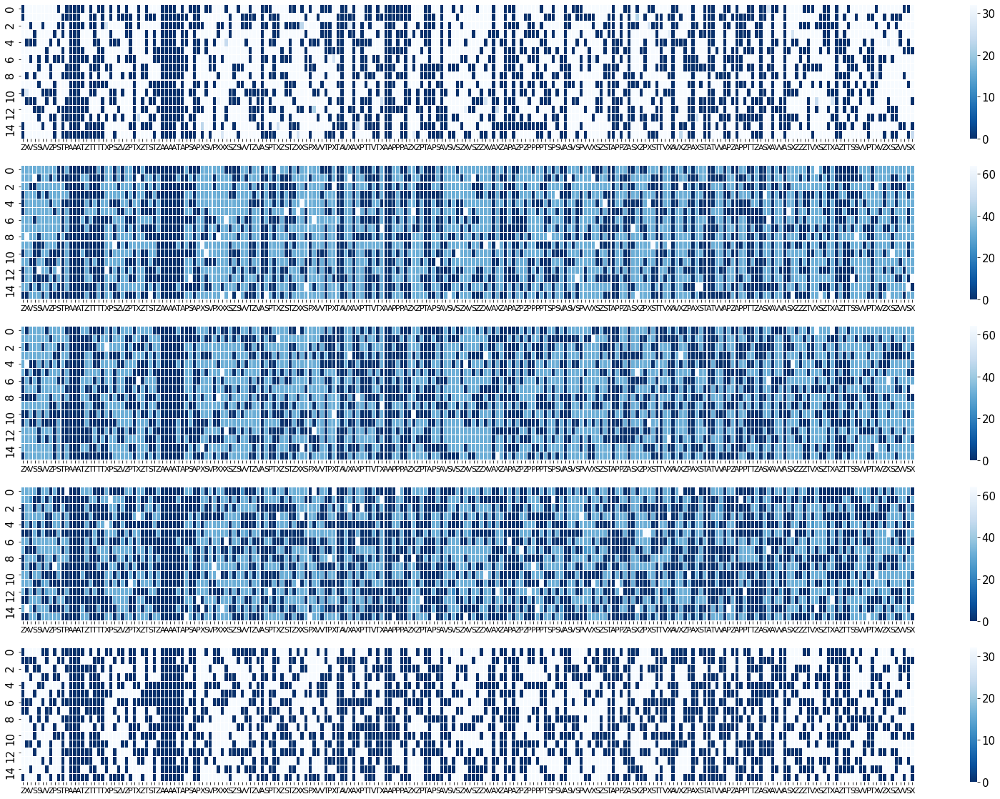

array([ 0., 32., 32., 32., 32.,  0.,  0., 32.,  0., 32.,  0.,  0.,  0.,
        0.,  0.,  0., 32.,  0., 32.,  0., 32.,  0.,  0., 32.,  0.,  0.,
       32.,  0.,  0., 32.,  0.,  0., 32.,  0., 32.,  0.,  0.,  0.,  0.,
        0.,  0., 32.,  0.,  0., 32., 32.,  0., 32.,  0.,  0., 32., 32.,
       32.,  0.,  0.,  0.,  0.,  0.,  0., 32.,  0.,  0., 32.,  0., 32.,
       32., 32.,  0., 32.,  0., 32.,  0., 32., 32.,  0., 32.,  0., 32.,
       32., 32.,  0., 32., 32.,  0., 32., 32., 32.,  0., 32.,  0., 32.,
        0.,  0., 32., 32.,  0.,  0., 32., 32.,  0., 32.,  0.,  0., 32.,
       32.,  0., 32., 32., 32., 32.,  0., 32., 32., 32., 32.,  0., 32.,
       32.,  0., 32.,  0.,  0., 32.,  0., 32.,  0., 32.,  0.,  0., 32.,
        0., 32., 32.,  0., 32.,  0.,  0.,  0., 32., 32., 32., 32.,  0.,
       32.,  0., 32.,  0.,  0.,  0., 32.,  0., 32.,  0.,  0.,  0., 32.,
       32., 32.,  0.,  0.,  0., 32., 32.,  0.,  0.,  0.,  0., 32.,  0.,
       32.,  0.,  0.,  0.,  0., 32., 32.,  0., 32.,  0.,  0., 32

32.0

In [19]:
fig, axes = plt.subplots(n_runs,1, figsize=(28,4*n_runs))

for r in range(n_runs):
    r_network = list_finalnet[r]
    countSynapses_max = np.zeros(shape=[M,N])
    
    for i in range(M):
        for j in range(N):
            countSynapses=[]
            for d in range(maxDendritesPerCell):
                countSynapses.append(r_network[i,j].get_cell_numSynapsesOnDendrite(d))
            countSynapses_max[i,j] = np.amax(countSynapses)

    sns.heatmap(countSynapses_max, linewidth=0.1, xticklabels=xticks_plot, ax=axes[r], cmap='Blues_r', cbar=True)
    axes[r].set_xticklabels(axes[r].get_xticklabels(), fontsize=11, rotation=0)
    #axes[0].set_yticklabels([])

#     sns.heatmap(countDendrites[:, 0:int(N/2)], linewidth=0.1, xticklabels=xticks_plot[0:int(N/2)], ax=axes[r], cmap='Blues_r', cbar=True)
#     axes[r].set_xticklabels(axes[r].get_xticklabels(), fontsize=11, rotation=0)
#     #axes[0].set_yticklabels([])

#     sns.heatmap(countDendrites[:, int(N/2):], linewidth=0.1, xticklabels=xticks_plot[int(N/2):], ax=axes[r], cmap='Blues_r', cbar=True)
#     axes[r].set_xticklabels(axes[r].get_xticklabels(), fontsize=11, rotation=0)
#     #axes[1].set_yticklabels([])

plt.show()

display(countSynapses_max[0])
display(np.amax(countSynapses_max))

##  Dendritic Architecture for ALL Cells in a Given Minicolumn after a particular `string_idx`

This section is to **plot the dendritic structure (32 MxN matrices)** of any given cell `(i,j)` in the pool right before the current reber string, as above, given by `string_idx`; and the change that occurs in the dendritic structure of the cell after the current reber string has been seen by the network. The updated dendritic structure of the cell can also be plotted.

In [ ]:
string_idx = 49
mc_idx = 0

res_string = results.iloc[string_idx]
all_cols = [c for c in range(N)]

cell_dendrite_idx = []
countDendrites_mc = []
for i in range(M):
    countDendrites_mc.append(res_string['htm_network'][i, mc_idx].get_cell_numDendrites())
    
    for dendrite in range(dict_params['maxDendritesPerCell']):
        if res_string['htm_network'][(i,mc_idx)].dendrites[dendrite] is None:
            continue
        else:
            cell_dendrite_idx.append((i, dendrite))

print(countDendrites_mc)
        
sns.set_style("whitegrid")
fig, axes = plt.subplots(len(cell_dendrite_idx),1, figsize=(24, 3.5*len(cell_dendrite_idx)))

for i, idx in enumerate(cell_dendrite_idx):
    
    dendrite = res_string['htm_network'][idx[0], mc_idx].dendrites[idx[1]]
    
    uninitialized_cols = [col for col in all_cols if dendrite[:, col].any()==False]
    deleted_cols = random.choices(uninitialized_cols, k=int(len(uninitialized_cols)/1.7))
    undeleted_cols = set(all_cols) - set(deleted_cols)
    
    sns.heatmap(dendrite[:, list(undeleted_cols)], vmax=1, vmin=0, linewidth=0.1, cmap='PuOr', cbar=True,
                ax=axes[i], xticklabels=xticks_plot[list(undeleted_cols)])
    
    axes[i].set_xticklabels(axes[i].get_xticklabels(), fontsize=17)
    axes[i].set_yticklabels([])
    
#     axes[i].set_xticks(axes[i].get_xticks())
#     axes[i].set_xticklabels(xticks_plot, rotation=0, fontsize=8.5)
    axes[i].set_title(f'Cell {idx[0]}, Dendrite {idx[1]}', fontsize=24) #; Average permanence value: {np.sum(dendrite)/np.count_nonzero(dendrite)}', fontsize=17)
    
#     ax_ = axes[i].twiny()
#     ax_.set_xticks(axes[i].get_xticks())
#     ax_.set_xbound(axes[i].get_xbound())
#     ax_.set_xticklabels([str(i) for i in np.arange(N)], rotation=90, fontsize=8)
#     ax_.tick_params(grid_alpha=0)

plt.show() 

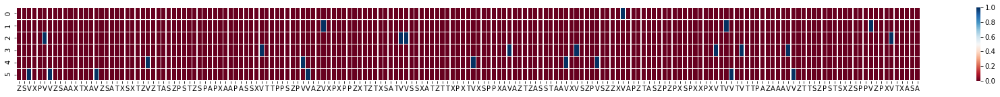

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0.])

In [21]:
string_idx = 5
cell_idx = (0,4)
dendrite_idx = 0

f = plt.figure(figsize=(35,2))
f = sns.heatmap(results.iloc[string_idx]['htm_network'][cell_idx].dendrites[dendrite_idx], vmax=1, vmin=0, linewidth=0.5, cmap='RdBu', xticklabels=xticks_plot)
ax_ = plt.twiny()
ax_.set_xticks(f.get_xticks())
ax_.set_xbound(f.get_xbound())
ax_.set_xticklabels([str(i) for i in np.arange(N)], rotation=90, fontsize=8)
ax_.tick_params(grid_alpha=0)
plt.show()

display(results.iloc[string_idx]['htm_network'][cell_idx].dendrites[dendrite_idx][0])

### Evolution of Synapses on a Dendrite

In [110]:
string_idx = 28
cell_idx = (6,2)
dendrite_idx = 1

count_numSynapses = 0
for i in range(string_idx):
    print(i, np.count_nonzero(results.iloc[i]['htm_network'][cell_idx].dendrites[dendrite_idx]))

0 0
1 0
2 0
3 0
4 0
5 0
6 0
7 0
8 0
9 0
10 25
11 25
12 25
13 25
14 25
15 25
16 25
17 25
18 25
19 25
20 25
21 25
22 25
23 25
24 25
25 25
26 25
27 25


## Network Activity & Predictivity

In [8]:
%matplotlib inline

In [19]:
cell_activity = np.zeros([M,N])
for string_idx in range(len(in_strings_alpha)):
    cell_activity += sum(results.iloc[string_idx]['htm_states']) # RHS sums up the net cellular activity 
                                                                 # for each letter of the string.
cell_predictivity = np.zeros([M,N])
for string_idx in range(len(in_strings_alpha)):
    cell_predictivity += sum(results.iloc[string_idx]['htm_preds'])

# Normalizing the net cellular predictivity of each cell
cell_predictivity = (cell_predictivity/total_len_inputstream)*100
# Normalizing the net cellular activity of each cell
cell_activity = (cell_activity/total_len_inputstream)*100

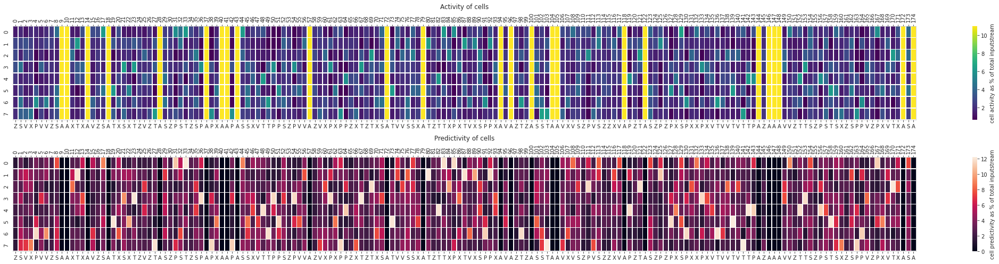

In [20]:
sns.set_style("whitegrid")
fig, axes = plt.subplots(2,1, sharex=False, figsize=(30,7))

sns.heatmap(cell_activity, linewidth=0.5, cmap='viridis', xticklabels=xticks_plot, 
            ax=axes[0], cbar_kws={'label':'cell activity as % of total inputstream'})
axes[0].set_title('Activity of cells')
ax_0 = axes[0].twiny()
ax_0.set_xticks(axes[0].get_xticks())
ax_0.set_xbound(axes[0].get_xbound())
ax_0.set_xticklabels([str(i) for i in np.arange(N)], rotation=90)
ax_0.tick_params(grid_alpha=0)


sns.heatmap(cell_predictivity, linewidth=0.5, xticklabels=xticks_plot,
            ax=axes[1], cbar_kws={'label':'cell predictivity as % of total inputstream'})
axes[1].set_title('Predictivity of cells')
ax_0 = axes[1].twiny()
ax_0.set_xticks(axes[1].get_xticks())
ax_0.set_xbound(axes[1].get_xbound())
ax_0.set_xticklabels([str(i) for i in np.arange(N)], rotation=90)
ax_0.tick_params(grid_alpha=0)

plt.tight_layout()
plt.show()

xticks_pos = axes[0].get_xticks()

#### Cell Activity & Predictivity – Character-wise

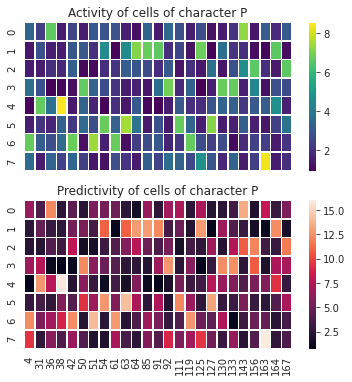

Character-wise Activity: 

 [[3.35484589 2.34783576 6.67631023 1.51329698 2.49248915 1.55780572
  3.04328474 2.88750417 2.85412262 1.60231445 1.2295538  3.3437187
  1.47991543 3.49393568 2.79292311 1.59118727 2.74285078 1.25737176
  1.54667854 2.08078335 7.28274174 1.40202515 3.13786581 1.85823968
  3.06553911]
 [1.40202515 2.80961389 1.59118727 1.58562368 3.01546679 3.01546679
  1.99732948 4.53432736 1.06264604 4.5732725  7.11583398 6.77089129
  6.65961945 1.96394792 2.50917993 1.31300768 6.82096361 1.00701013
  3.71091577 2.07521976 1.99176588 1.17948147 1.11271837 6.63736508
  1.17948147]
 [1.55780572 1.54667854 1.99732948 1.83042172 3.24357405 1.14053633
  1.15166351 1.98620229 2.1141649  3.16012017 2.95983087 2.67052409
  1.97507511 3.08222989 1.34638923 1.98620229 1.41871592 3.67197062
  1.40758874 2.83186825 4.65116279 6.59285635 1.96394792 1.49104262
  6.64849227]
 [3.68309781 2.83186825 1.01813731 1.10715478 1.21842662 6.70969178
  3.32702793 2.70946923 2.08634695 1.52998776 1

In [11]:
char = 'P'

char_activity = cell_activity[:,list(charsMC[char])]
char_predictivity = cell_predictivity[:,list(charsMC[char])]

sns.set_style("whitegrid")
fig, axes = plt.subplots(2,1, sharex=True, figsize=(6,6))

sns.heatmap(char_activity, linewidth=0.5, cmap='viridis', xticklabels=list(charsMC[char]), ax=axes[0])
axes[0].set_title(f'Activity of cells of character {char}')
sns.heatmap(char_predictivity, linewidth=0.5, xticklabels=list(charsMC[char]), ax=axes[1])
axes[1].set_title(f'Predictivity of cells of character {char}')
plt.show()

print('Character-wise Activity: \n\n', char_activity)
print('\n\nCharacter-wise Predictivity: \n\n', char_predictivity)